In [53]:
import pandas as pd
import numpy as np
from sklearn.ensemble import GradientBoostingClassifier
import optuna
from catboost import CatBoostClassifier
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression, LogisticRegression

pd.set_option('future.no_silent_downcasting', True)

In [54]:
df_train = pd.read_csv('../data/model/train.csv')
df_test = pd.read_csv('../data/model/test.csv')

In [55]:
ids = df_test['PassengerId']

df_all = [df_train, df_test]

In [56]:
for df in df_all:
    print(df.isna().sum(axis=0))

PassengerId       0
HomePlanet      201
CryoSleep       217
Cabin           199
Destination     182
Age             179
VIP             203
RoomService     181
FoodCourt       183
ShoppingMall    208
Spa             183
VRDeck          188
Name            200
Transported       0
dtype: int64
PassengerId       0
HomePlanet       87
CryoSleep        93
Cabin           100
Destination      92
Age              91
VIP              93
RoomService      82
FoodCourt       106
ShoppingMall     98
Spa             101
VRDeck           80
Name             94
dtype: int64


In [57]:
print(df_train.info())
df_train.describe(include='all')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   8693 non-null   object 
 1   HomePlanet    8492 non-null   object 
 2   CryoSleep     8476 non-null   object 
 3   Cabin         8494 non-null   object 
 4   Destination   8511 non-null   object 
 5   Age           8514 non-null   float64
 6   VIP           8490 non-null   object 
 7   RoomService   8512 non-null   float64
 8   FoodCourt     8510 non-null   float64
 9   ShoppingMall  8485 non-null   float64
 10  Spa           8510 non-null   float64
 11  VRDeck        8505 non-null   float64
 12  Name          8493 non-null   object 
 13  Transported   8693 non-null   bool   
dtypes: bool(1), float64(6), object(7)
memory usage: 891.5+ KB
None


,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
count,8693,8492,8476,8494,8511,8514.000000,8490,8512.000000,8510.000000,8485.000000,8510.000000,8505.000000,8493,8693
unique,8693,3,2,6560,3,NaN,2,NaN,NaN,NaN,NaN,NaN,8473,2
top,0001_01,Earth,False,G/734/S,TRAPPIST-1e,NaN,False,NaN,NaN,NaN,NaN,NaN,Gollux Reedall,True
freq,1,4602,5439,8,5915,NaN,8291,NaN,NaN,NaN,NaN,NaN,2,4378
mean,NaN,NaN,NaN,NaN,NaN,28.827930,NaN,224.687617,458.077203,173.729169,311.138778,304.854791,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,14.489021,NaN,666.717663,1611.489240,604.696458,1136.705535,1145.717189,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,19.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,27.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,38.000000,NaN,47.000000,76.000000,27.000000,59.000000,46.000000,NaN,NaN


<Axes: xlabel='Solo', ylabel='count'>

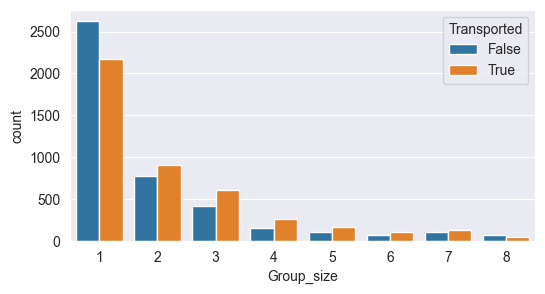

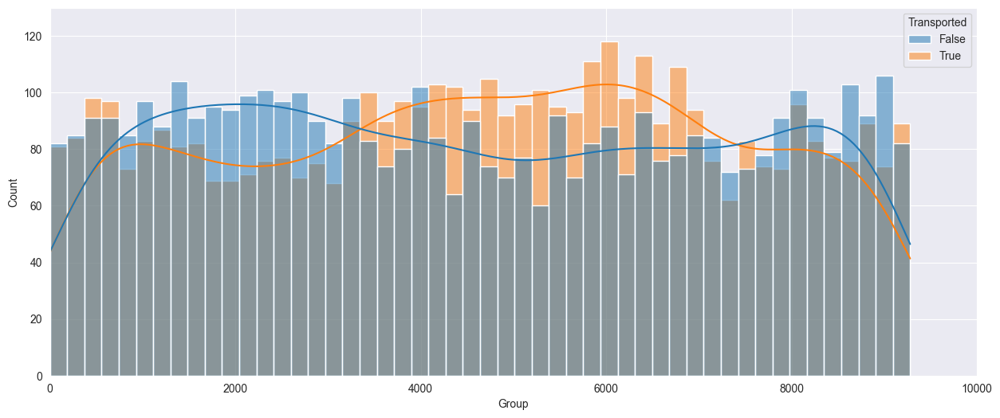

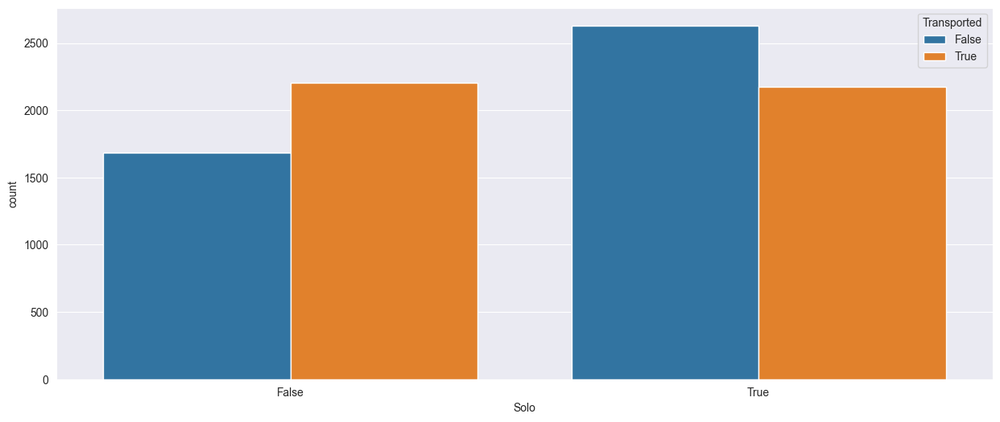

In [58]:
for df in df_all: 
    df['Group'] = df['PassengerId'].apply(lambda x: x.split('_')[0]).astype(int)
    df['Group_size']=df['Group'].map(lambda x: df['Group'].value_counts()[x])
    df['Solo'] = False
    df.loc[df['Group_size'] == 1, 'Solo'] = True
    
fig = plt.figure(figsize= (6,3))
sns.countplot(data=df_train, x='Group_size', hue='Transported')

fig = plt.figure(figsize= (15,6))
sns.histplot(data=df_train, x='Group', hue='Transported', bins = 50, kde=True)
plt.ylim([0,130])
plt.xlim([0,10000])

fig = plt.figure(figsize= (15,6))
sns.countplot(data=df_train, x='Solo', hue='Transported')

In [59]:
for df in df_all: 
    df['Cabin'] = df['Cabin'].fillna('Z/9999/Z')
    df['Cabin_deck'] = df['Cabin'].apply(lambda x: x.split('/')[0])
    df['Cabin_number'] = df['Cabin'].apply(lambda x: x.split('/')[1]).astype(int)
    df['Cabin_side'] = df['Cabin'].apply(lambda x: x.split('/')[2])
    
    df.loc[df['Cabin_deck']=='Z', 'Cabin_deck']=np.nan
    df.loc[df['Cabin_number']==9999, 'Cabin_number']=np.nan
    df.loc[df['Cabin_side']=='Z', 'Cabin_side']=np.nan

    df.drop('Cabin', axis=1, inplace=True)

0
0


Text(0.5, 1.0, 'Age group distribution')

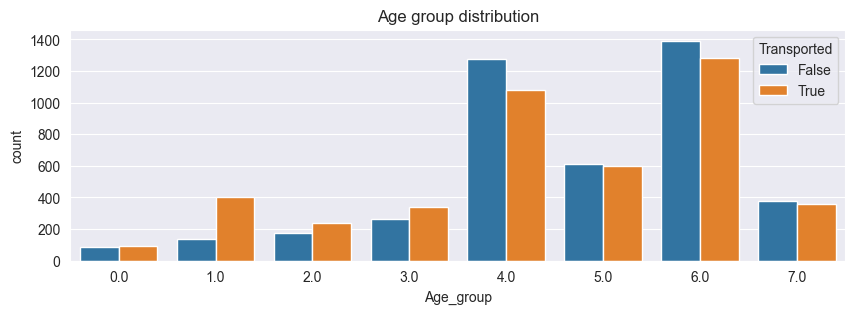

In [60]:
for dataset in df_all:
    dataset['Age_group'] = np.nan
    dataset.loc[(dataset['Age'] >= 0) & (dataset['Age'] < 7), 'Age_group'] = 1
    dataset.loc[(dataset['Age'] >= 7) & (dataset['Age'] < 14), 'Age_group'] = 2
    dataset.loc[(dataset['Age'] >= 14) & (dataset['Age'] < 18), 'Age_group'] = 3
    dataset.loc[(dataset['Age'] >= 18) & (dataset['Age'] <= 25), 'Age_group'] = 4
    dataset.loc[(dataset['Age'] > 25) & (dataset['Age'] <= 30), 'Age_group'] = 5
    dataset.loc[(dataset['Age'] > 30) & (dataset['Age'] <= 50), 'Age_group'] = 6
    dataset.loc[dataset['Age'] > 50, 'Age_group'] = 7
    dataset.loc[dataset['Age'].isna(), 'Age_group'] = 0
    print(dataset['Age_group'].isna().sum(axis=0))

plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Age_group', hue='Transported')
plt.title('Age group distribution')

<Axes: xlabel='Cabin_side', ylabel='count'>

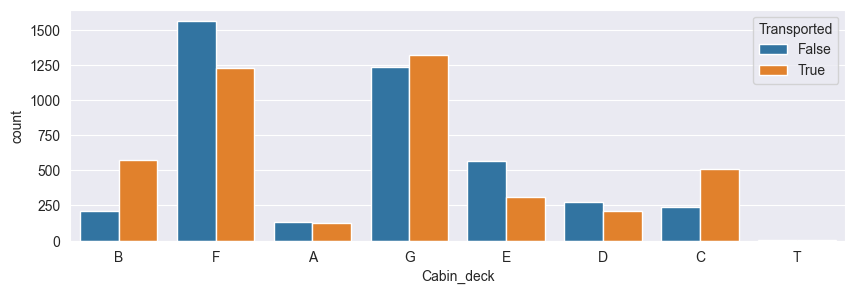

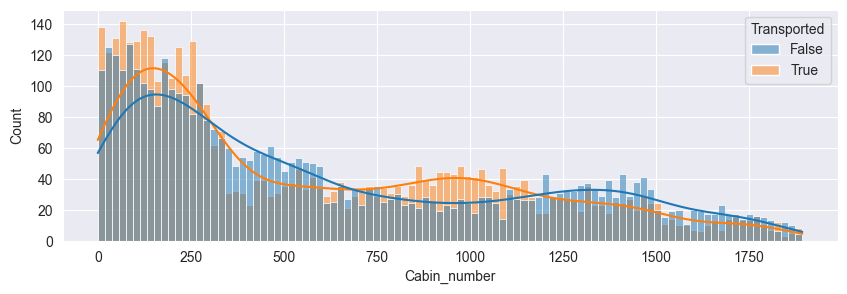

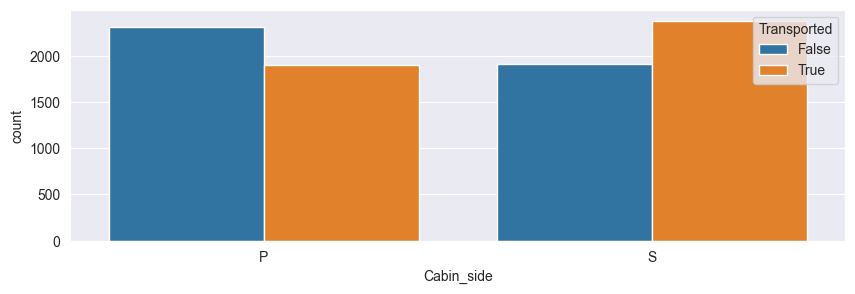

In [61]:
plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Cabin_deck', hue='Transported')

plt.figure(figsize=(10, 3))
sns.histplot(data=df_train, x='Cabin_number', hue='Transported',bins=100, kde=True)

plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Cabin_side', hue='Transported')

0
0


<Axes: xlabel='Cabin_number_group', ylabel='count'>

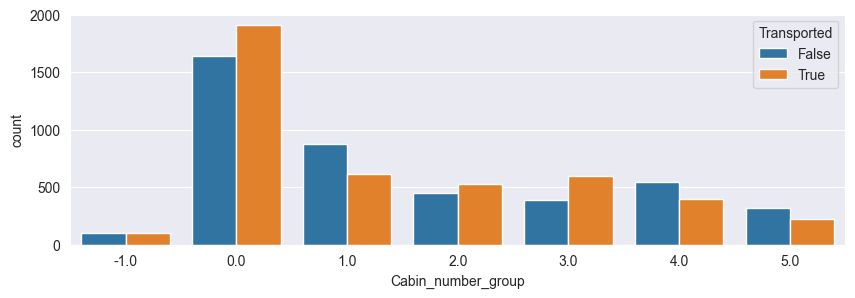

In [62]:
for dataset in df_all:
    dataset['Cabin_number_group'] = np.nan
    dataset.loc[(dataset['Cabin_number'] >= 0) & (dataset['Cabin_number'] < 300), 'Cabin_number_group'] = 0
    dataset.loc[(dataset['Cabin_number'] >= 300) & (dataset['Cabin_number'] < 600), 'Cabin_number_group'] = 1
    dataset.loc[(dataset['Cabin_number'] >= 600) & (dataset['Cabin_number'] < 900), 'Cabin_number_group'] = 2
    dataset.loc[(dataset['Cabin_number'] >= 900) & (dataset['Cabin_number'] < 1200), 'Cabin_number_group'] = 3
    dataset.loc[(dataset['Cabin_number'] >= 1200) & (dataset['Cabin_number'] < 1500), 'Cabin_number_group'] = 4
    dataset.loc[(dataset['Cabin_number'] >= 1500), 'Cabin_number_group'] = 5
    dataset.loc[dataset['Cabin_number'].isna(), 'Cabin_number_group'] = -1
    print(dataset['Cabin_number_group'].isna().sum(axis=0))

plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Cabin_number_group', hue='Transported')

,PassengerId,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,...,Group,Group_size,Solo,Cabin_deck,Cabin_number,Cabin_side,Age_group,Cabin_number_group,Expenditure,No_spending
count,8693,8492,8476,8511,8514.000000,8490,8512.000000,8510.000000,8485.000000,8510.000000,...,8693.000000,8693.000000,8693,8494,8494.000000,8494,8693.000000,8693.000000,8693.000000,8693.000000
unique,8693,3,2,3,NaN,2,NaN,NaN,NaN,NaN,...,NaN,NaN,2,8,NaN,2,NaN,NaN,NaN,NaN
top,0001_01,Earth,False,TRAPPIST-1e,NaN,False,NaN,NaN,NaN,NaN,...,NaN,NaN,True,F,NaN,S,NaN,NaN,NaN,NaN
freq,1,4602,5439,5915,NaN,8291,NaN,NaN,NaN,NaN,...,NaN,NaN,4805,2794,NaN,4288,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,28.827930,NaN,224.687617,458.077203,173.729169,311.138778,...,4633.389624,2.035546,NaN,NaN,600.367671,NaN,4.577361,1.457380,1440.866329,0.420223
std,NaN,NaN,NaN,NaN,14.489021,NaN,666.717663,1611.489240,604.696458,1136.705535,...,2671.028856,1.596347,NaN,NaN,511.867226,NaN,1.715607,1.681067,2803.045694,0.493623
min,NaN,NaN,NaN,NaN,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,NaN,NaN,0.000000,NaN,0.000000,-1.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,19.000000,NaN,0.000000,0.000000,0.000000,0.000000,...,2319.000000,1.000000,NaN,NaN,167.250000,NaN,4.000000,0.000000,0.000000,0.000000
50%,NaN,NaN,NaN,NaN,27.000000,NaN,0.000000,0.000000,0.000000,0.000000,...,4630.000000,1.000000,NaN,NaN,427.000000,NaN,5.000000,1.000000,716.000000,0.000000
75%,NaN,NaN,NaN,NaN,38.000000,NaN,47.000000,76.000000,27.000000,59.000000,...,6883.000000,3.000000,NaN,NaN,999.000000,NaN,6.000000,3.000000,1441.000000,1.000000


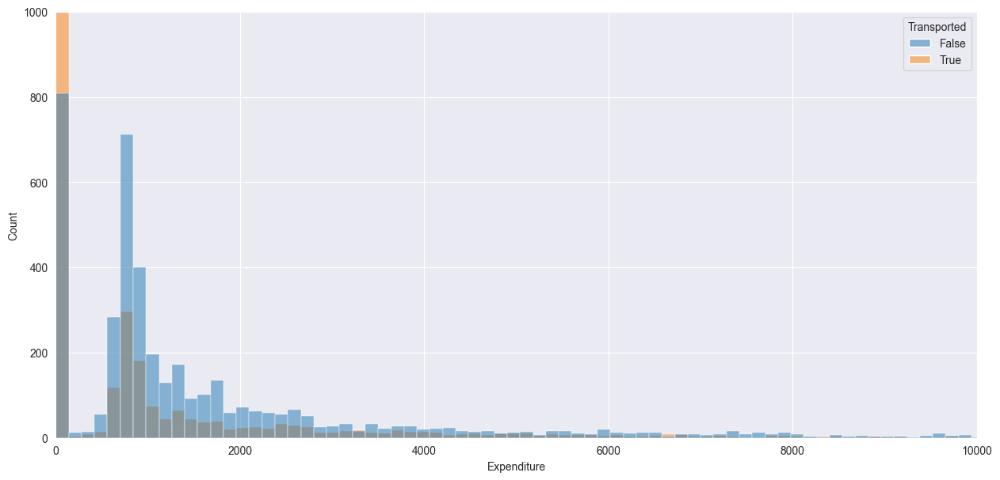

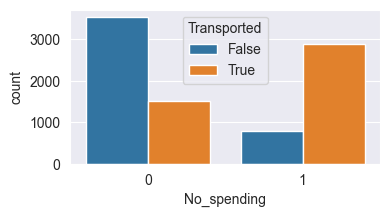

In [63]:
for df in df_all: 
    df['Expenditure']=df[['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']].sum(axis=1)
    df['No_spending']=(df['Expenditure']==0).astype(int)

fig=plt.figure(figsize=(15,7))
sns.histplot(data=df_train, x='Expenditure', hue='Transported')
plt.ylim([0,1000])
plt.xlim([0,10000])

fig=plt.figure(figsize=(4,2))
sns.countplot(data=df_train, x='No_spending', hue='Transported')

df_train.describe(include='all')

<Axes: xlabel='Age_group', ylabel='count'>

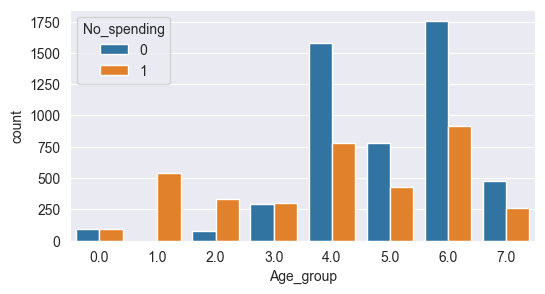

In [64]:
fig=plt.figure(figsize=(6,3))
sns.countplot(data=df_train, x='Age_group', hue='No_spending')

In [65]:
df_train[df_train['RoomService'].isna() & df_train['FoodCourt'].isna() & df_train['ShoppingMall'].isna() & df_train['Spa'].isna() & df_train['VRDeck'].isna()].head(49)

,PassengerId,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,...,Group,Group_size,Solo,Cabin_deck,Cabin_number,Cabin_side,Age_group,Cabin_number_group,Expenditure,No_spending


In [66]:
for df in df_all:
    df.loc[df['Age'].isna() & df['No_spending'] == True, 'Age_group'] = 1
    df.loc[df['Age'].isna() & df['No_spending'] == True, 'Age'] = 0

C:\Users\sitdi\AppData\Local\Temp\ipykernel_10724\2613058696.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Name'].fillna('Unknown Unknown', inplace=True)
C:\Users\sitdi\AppData\Local\Temp\ipykernel_10724\2613058696.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For e

<Axes: xlabel='Family_size', ylabel='count'>

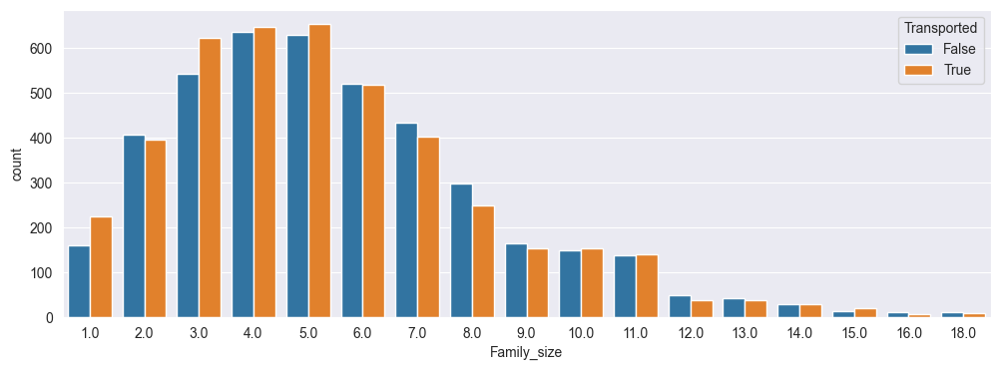

In [67]:
for df in df_all:
    df['Name'].fillna('Unknown Unknown', inplace=True)
    
    df['Surname']=df['Name'].str.split().str[-1]
    
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    
    df.loc[df['Surname']=='Unknown','Surname']=np.nan
    df.loc[df['Family_size']==200,'Family_size']=np.nan
    
    df.drop('Name', axis=1, inplace=True)

plt.figure(figsize=(12,4))
sns.countplot(data=df_train, x='Family_size', hue='Transported')

In [68]:
GHP_gb=df_train.groupby(['Group','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
GHP_gb.head(25)

HomePlanet,Earth,Europa,Mars
Group,,,
1,0.0,1.0,0.0
2,1.0,0.0,0.0
3,0.0,2.0,0.0
4,1.0,0.0,0.0
5,1.0,0.0,0.0
6,2.0,0.0,0.0
7,1.0,0.0,0.0
8,0.0,3.0,0.0
9,0.0,0.0,1.0


In [69]:
for df in df_all:
    GHP_gb=df_train.groupby(['Group','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    
    GHP_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['Group']).isin(GHP_gb.index)].index

    df.loc[GHP_index,'HomePlanet']=df.iloc[GHP_index,:]['Group'].map(lambda x: GHP_gb.idxmax(axis=1)[x])

<Axes: xlabel='Cabin_deck', ylabel='HomePlanet'>

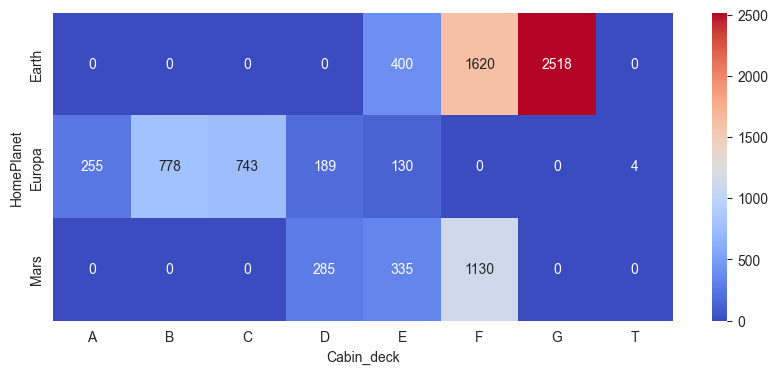

In [70]:
CDHP_gb=df_train.groupby(['Cabin_deck','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)


plt.figure(figsize=(10,4))
sns.heatmap(CDHP_gb.T, annot=True, fmt='g', cmap='coolwarm')

In [71]:
for df in df_all: 
    df.loc[(df['HomePlanet'].isna()) & (df['Cabin_deck'].isin(['A', 'B', 'C', 'T'])), 'HomePlanet']='Europa'
    df.loc[(df['HomePlanet'].isna()) & (df['Cabin_deck']=='G'), 'HomePlanet']='Earth'

In [72]:
SHP_gb=df_train.groupby(['Surname','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)

SHP_gb.head(25)

HomePlanet,Earth,Europa,Mars
Surname,,,
Acobson,4.0,0.0,0.0
Acobsond,3.0,0.0,0.0
Adavisons,9.0,0.0,0.0
Adkinson,3.0,0.0,0.0
Admingried,0.0,4.0,0.0
Ageurante,0.0,1.0,0.0
Aginge,0.0,1.0,0.0
Ailled,0.0,2.0,0.0
Aillyber,0.0,3.0,0.0


In [73]:
for df in df_all:
    SHP_gb=df_train.groupby(['Surname','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    
    SHP_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['Surname']).isin(SHP_gb.index)].index
    df.loc[SHP_index,'HomePlanet']=df.iloc[SHP_index,:]['Surname'].map(lambda x: SHP_gb.idxmax(axis=1)[x])

In [74]:
df_train[df_train['HomePlanet'].isna()]

,PassengerId,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,...,Solo,Cabin_deck,Cabin_number,Cabin_side,Age_group,Cabin_number_group,Expenditure,No_spending,Surname,Family_size
225,0242_01,NaN,False,TRAPPIST-1e,18.0,False,313.0,1.0,691.0,283.0,...,True,F,46.0,S,4.0,0.0,1288.0,0,Sté,1.0
2274,2443_01,NaN,False,TRAPPIST-1e,31.0,False,1458.0,421.0,76.0,0.0,...,True,D,72.0,P,6.0,0.0,1955.0,0,NaN,NaN
2631,2817_01,NaN,False,TRAPPIST-1e,25.0,False,237.0,0.0,910.0,0.0,...,True,F,584.0,P,4.0,1.0,1159.0,0,Sutty,1.0
3091,3331_01,NaN,False,TRAPPIST-1e,40.0,False,666.0,4.0,83.0,0.0,...,True,F,631.0,S,6.0,2.0,803.0,0,NaN,NaN
4548,4840_01,NaN,True,TRAPPIST-1e,36.0,False,0.0,0.0,NaN,0.0,...,True,F,915.0,S,6.0,3.0,0.0,1,NaN,NaN
5252,5603_01,NaN,False,TRAPPIST-1e,34.0,False,170.0,1256.0,0.0,3926.0,...,True,E,365.0,S,6.0,1.0,12473.0,0,Cluitty,1.0
5634,5989_01,NaN,False,TRAPPIST-1e,20.0,False,0.0,0.0,NaN,703.0,...,True,F,1141.0,S,4.0,3.0,703.0,0,Holcompton,1.0
5762,6108_01,NaN,False,TRAPPIST-1e,13.0,False,206.0,28.0,0.0,1.0,...,True,F,1166.0,S,2.0,3.0,864.0,0,NaN,NaN


<Axes: xlabel='HomePlanet', ylabel='Destination'>

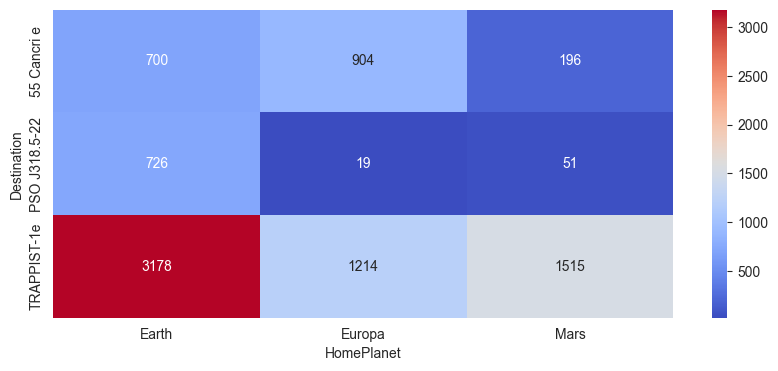

In [75]:
HPD_gb=df_train.groupby(['HomePlanet','Destination'])['Destination'].size().unstack().fillna(0)

plt.figure(figsize=(10,4))
sns.heatmap(HPD_gb.T, annot=True, fmt='g', cmap='coolwarm')

In [76]:
for df in df_all:
    df.loc[(df['HomePlanet'].isna()) & (df['Cabin_deck']!='D'), 'HomePlanet']='Earth'
    df.loc[(df['HomePlanet'].isna()) & (df['Cabin_deck']=='D'), 'HomePlanet']='Mars'

In [77]:
def replace_mode(table, column):
    val = table[column].mode()[0]
    table[column] = table[column].fillna(val)

for df in df_all:
    GD_gb=df.groupby(['Group', 'Destination'])['Destination'].size().unstack().fillna(0)

    GHP_index=df[df['Destination'].isna()][(df[df['Destination'].isna()]['Group']).isin(GD_gb.index)].index
    df.loc[GHP_index,'Destination']=df.iloc[GHP_index,:]['Group'].map(lambda x: GD_gb.idxmax(axis=1)[x])

    print(df['Destination'].isna().sum())
    replace_mode(df, column='Destination')

103
51


In [78]:
for df in df_all:
    df.loc[(df['CryoSleep'].isna()) & (df['No_spending'] == True), 'CryoSleep'] = True
    df['CryoSleep'] = df['CryoSleep'].fillna(False)

In [79]:
GCD_gb = df_train[df_train['Solo'] == False].groupby(['Group','Cabin_deck'])['Cabin_deck'].size().unstack().fillna(0)

GCD_gb.head()

Cabin_deck,A,B,C,D,E,F,G
Group,,,,,,,
3,2.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,1.0,1.0
8,0.0,3.0,0.0,0.0,0.0,0.0,0.0
17,0.0,0.0,0.0,0.0,0.0,1.0,1.0
20,0.0,0.0,0.0,0.0,6.0,0.0,0.0


In [80]:
for df in df_all:
    GCD_gb=df[df['Group_size']>1].groupby(['Group','Cabin_deck'])['Cabin_deck'].size().unstack().fillna(0)
    GCS_gb=df[df['Group_size']>1].groupby(['Group','Cabin_side'])['Cabin_side'].size().unstack().fillna(0)
    
    SCD_gb=df[df['Family_size']>1].groupby(['Surname','Cabin_deck'])['Cabin_deck'].size().unstack().fillna(0)
    SCS_gb=df[df['Family_size']>1].groupby(['Surname','Cabin_side'])['Cabin_side'].size().unstack().fillna(0)

    GCS_index=df[df['Cabin_side'].isna()][(df[df['Cabin_side'].isna()]['Group']).isin(GCS_gb.index)].index
    df.loc[GCS_index,'Cabin_side']=df.iloc[GCS_index,:]['Group'].map(lambda x: GCS_gb.idxmax(axis=1)[x])
    
    GCD_index=df[df['Cabin_deck'].isna()][(df[df['Cabin_deck'].isna()]['Group']).isin(GCD_gb.index)].index
    df.loc[GCD_index,'Cabin_deck']=df.iloc[GCD_index,:]['Group'].map(lambda x: GCD_gb.idxmax(axis=1)[x])
    
    SCS_index=df[df['Cabin_side'].isna()][(df[df['Cabin_side'].isna()]['Surname']).isin(SCS_gb.index)].index
    df.loc[SCS_index,'Cabin_side']=df.iloc[SCS_index,:]['Surname'].map(lambda x: SCS_gb.idxmax(axis=1)[x])

    SCD_index=df[df['Cabin_deck'].isna()][(df[df['Cabin_deck'].isna()]['Surname']).isin(SCD_gb.index)].index
    df.loc[SCD_index,'Cabin_deck']=df.iloc[SCD_index,:]['Surname'].map(lambda x: SCD_gb.idxmax(axis=1)[x])

In [81]:
for df in df_all:
    na_rows_CD=df.loc[df['Cabin_deck'].isna(),'Cabin_deck'].index
    df.loc[df['Cabin_deck'].isna(),'Cabin_deck']=df.groupby(['HomePlanet','Destination','Solo'])['Cabin_deck'].transform(lambda x: x.fillna(pd.Series.mode(x)[0]))[na_rows_CD]
    df.loc[df['Cabin_side'].isna(),'Cabin_side']='Z'

In [82]:
for df in df_all:
    for deck in ['A', 'B', 'C', 'D', 'E', 'F', 'G']:
        X_CN=df.loc[~(df['Cabin_number'].isna()) & (df['Cabin_deck']==deck),'Group']
        y_CN=df.loc[~(df['Cabin_number'].isna()) & (df['Cabin_deck']==deck),'Cabin_number']
        X_test_CN=df.loc[(df['Cabin_number'].isna()) & (df['Cabin_deck']==deck),'Group']
    
        model_CN=LinearRegression()
        model_CN.fit(X_CN.values.reshape(-1, 1), y_CN)
        preds_CN=model_CN.predict(X_test_CN.values.reshape(-1, 1))
        
        df.loc[(df['Cabin_number'].isna()) & (df['Cabin_deck']==deck),'Cabin_number']=preds_CN.astype(int)

0
0


<Axes: xlabel='Cabin_number_group', ylabel='count'>

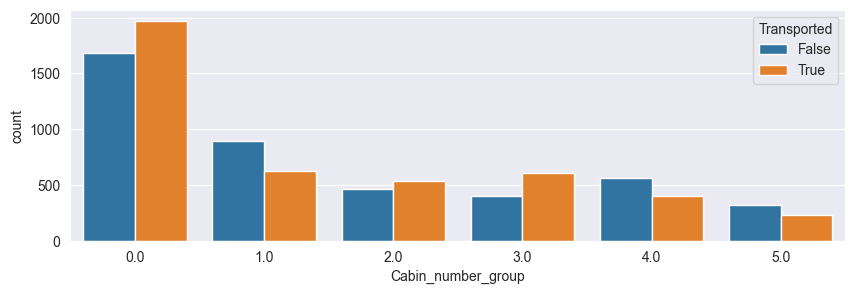

In [83]:
for df in df_all:
    df['Cabin_number_group'] = np.nan
    df.loc[df['Cabin_number'] < 300, 'Cabin_number_group'] = 0
    df.loc[(df['Cabin_number'] >= 300) & (df['Cabin_number'] < 600), 'Cabin_number_group'] = 1
    df.loc[(df['Cabin_number'] >= 600) & (df['Cabin_number'] < 900), 'Cabin_number_group'] = 2
    df.loc[(df['Cabin_number'] >= 900) & (df['Cabin_number'] < 1200), 'Cabin_number_group'] = 3
    df.loc[(df['Cabin_number'] >= 1200) & (df['Cabin_number'] < 1500), 'Cabin_number_group'] = 4
    df.loc[(df['Cabin_number'] >= 1500), 'Cabin_number_group'] = 5
    df.loc[df['Cabin_number'].isna(), 'Cabin_number_group'] = -1
    print(df['Cabin_number_group'].isna().sum(axis=0))

plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Cabin_number_group', hue='Transported')

In [84]:
for df in df_all:
    df.groupby(['HomePlanet', 'No_spending','Solo', 'Group'])['Age'].mean().unstack().fillna(0)

    na_rows_A=df.loc[df['Age'].isna(),'Age'].index
    df.loc[df['Age'].isna(),'Age']=df.groupby(['HomePlanet', 'No_spending','Solo', 'Group'])['Age'].transform(lambda x: x.fillna(x.mean()))[na_rows_A]
    print(df['Age'].isna().sum(axis=0))
    
    df.groupby(['HomePlanet', 'No_spending','Solo'])['Age'].mean().unstack().fillna(0)
    na_rows_A=df.loc[df['Age'].isna(),'Age'].index
    df.loc[df['Age'].isna(),'Age']=df.groupby(['HomePlanet', 'No_spending','Solo'])['Age'].transform(lambda x: x.fillna(x.mean()))[na_rows_A]
    print(df['Age'].isna().sum(axis=0))

72
0
37
0


0
0


Text(0.5, 1.0, 'Age group distribution')

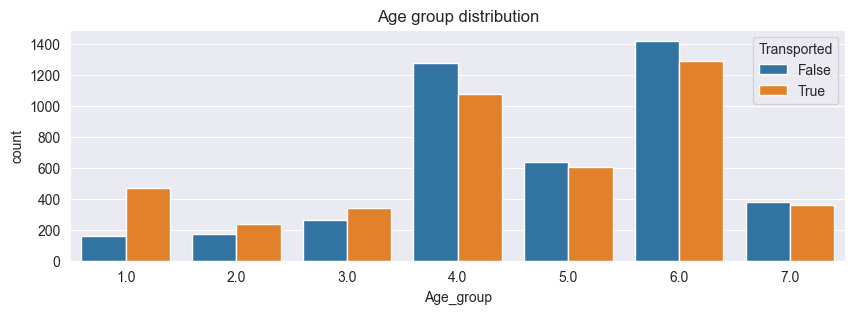

In [85]:
for dataset in df_all:
    dataset['Age_group'] = np.nan
    dataset.loc[(dataset['Age'] >= 0) & (dataset['Age'] < 7), 'Age_group'] = 1
    dataset.loc[(dataset['Age'] >= 7) & (dataset['Age'] < 14), 'Age_group'] = 2
    dataset.loc[(dataset['Age'] >= 14) & (dataset['Age'] < 18), 'Age_group'] = 3
    dataset.loc[(dataset['Age'] >= 18) & (dataset['Age'] <= 25), 'Age_group'] = 4
    dataset.loc[(dataset['Age'] > 25) & (dataset['Age'] <= 30), 'Age_group'] = 5
    dataset.loc[(dataset['Age'] > 30) & (dataset['Age'] <= 50), 'Age_group'] = 6
    dataset.loc[dataset['Age'] > 50, 'Age_group'] = 7
    dataset.loc[dataset['Age'].isna(), 'Age_group'] = 0
    print(dataset['Age_group'].isna().sum(axis=0))

plt.figure(figsize=(10, 3))
sns.countplot(data=df_train, x='Age_group', hue='Transported')
plt.title('Age group distribution')

In [86]:
for df in df_all:
    for col in ['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']:
        na_rows=df.loc[df[col].isna(),col].index
        df.loc[df[col].isna(),col]=df.groupby(['HomePlanet','Solo','Age_group'])[col].transform(lambda x: x.fillna(x.mean()))[na_rows]

for df in df_all: 
    df['Expenditure']=df[['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']].sum(axis=1)
    df['No_spending']=(df['Expenditure']==0).astype(int)

In [87]:
df_train.isna().sum(axis=0)

PassengerId             0
HomePlanet              0
CryoSleep               0
Destination             0
Age                     0
VIP                   203
RoomService             0
FoodCourt               0
ShoppingMall            0
Spa                     0
VRDeck                  0
Transported             0
Group                   0
Group_size              0
Solo                    0
Cabin_deck              0
Cabin_number            0
Cabin_side              0
Age_group               0
Cabin_number_group      0
Expenditure             0
No_spending             0
Surname               200
Family_size           200
dtype: int64

<Axes: xlabel='VIP', ylabel='count'>

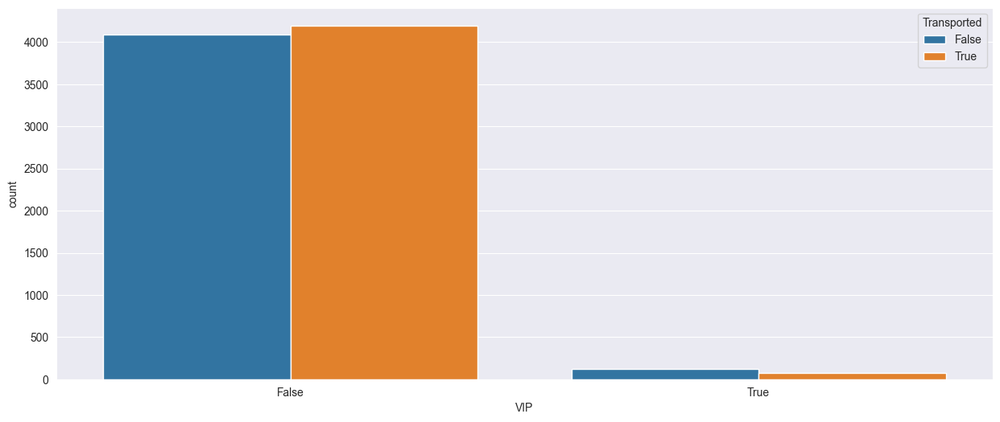

In [88]:
fig = plt.figure(figsize= (15,6))
sns.countplot(data=df_train, x='VIP', hue='Transported')

In [89]:
for df in df_all:
    GS_gb=df.groupby(['Group', 'Surname'])['Surname'].size().unstack().fillna(0)

    GS_index=df[df['Surname'].isna()][(df[df['Surname'].isna()]['Group']).isin(GS_gb.index)].index

    df.loc[GS_index,'Surname']=df.iloc[GS_index,:]['Group'].map(lambda x: GS_gb.idxmax(axis=1)[x])
    print(df['Surname'].isna().sum())

104
51


<Axes: xlabel='Family_size', ylabel='count'>

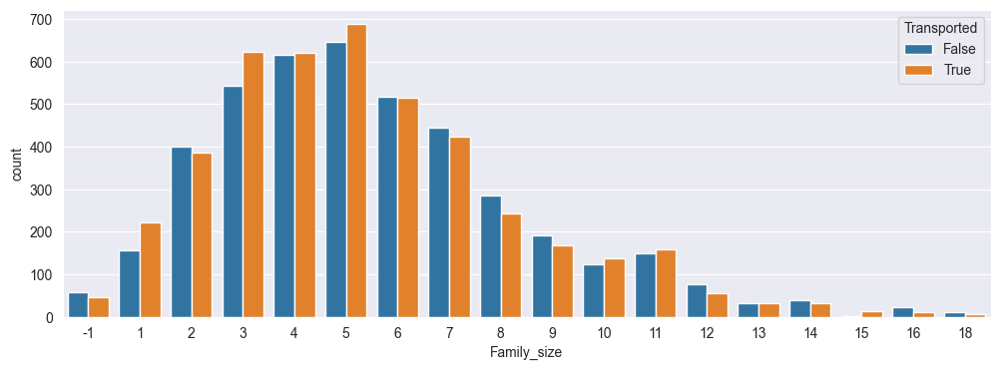

In [90]:
for df in df_all:
    df['Surname'] = df['Surname'].fillna('Unknown')
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    
    df.loc[df['Surname']=='Unknown','Surname']=np.nan
    df.loc[df['Family_size']>40,'Family_size']=-1

plt.figure(figsize=(12,4))
sns.countplot(data=df_train, x='Family_size', hue='Transported')

In [91]:
for df in df_all:
    df['VIP'] = df['VIP'].fillna(False)
    df.drop(['PassengerId', 'Group', 'Cabin_number', 'Surname'], axis=1, inplace=True)

In [92]:
for df in df_all:
    for col in ['RoomService','FoodCourt','ShoppingMall','Spa','VRDeck','Expenditure']:
        df[col]=np.log(1+df[col])

In [93]:
df_train.head(50)

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Transported,Group_size,Solo,Cabin_deck,Cabin_side,Age_group,Cabin_number_group,Expenditure,No_spending,Family_size
0,Europa,False,TRAPPIST-1e,39.0,False,0.000000,0.000000,0.000000,0.000000,0.000000,False,1,True,B,P,6.0,0.0,0.000000,1,1
1,Earth,False,TRAPPIST-1e,24.0,False,4.700480,2.302585,3.258097,6.309918,3.806662,True,1,True,F,S,4.0,0.0,6.602588,0,4
2,Europa,False,TRAPPIST-1e,58.0,True,3.784190,8.182280,0.000000,8.812248,3.912023,False,2,False,A,S,7.0,0.0,9.248021,0,6
3,Europa,False,TRAPPIST-1e,33.0,False,0.000000,7.157735,5.918894,8.110728,5.267858,False,2,False,A,S,6.0,0.0,8.551981,0,6
4,Earth,False,TRAPPIST-1e,16.0,False,5.717028,4.262680,5.023881,6.338594,1.098612,True,1,True,F,S,3.0,0.0,6.995766,0,6
5,Earth,False,PSO J318.5-22,44.0,False,0.000000,6.182085,0.000000,5.676754,0.000000,True,1,True,F,P,6.0,0.0,6.652863,0,7
6,Earth,False,TRAPPIST-1e,26.0,False,3.761200,7.339538,1.386294,0.000000,0.000000,True,2,False,F,S,5.0,0.0,7.368340,0,7
7,Earth,True,TRAPPIST-1e,28.0,False,0.000000,0.000000,0.000000,0.000000,5.231782,True,2,False,G,S,5.0,0.0,5.231782,0,7
8,Earth,False,TRAPPIST-1e,35.0,False,0.000000,6.666957,2.890372,5.379897,0.000000,True,1,True,F,S,6.0,0.0,6.926577,0,5
9,Europa,True,55 Cancri e,14.0,False,0.000000,0.000000,0.000000,0.000000,0.000000,True,3,False,B,P,3.0,0.0,0.000000,1,3


In [94]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 20 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   HomePlanet          8693 non-null   object 
 1   CryoSleep           8693 non-null   object 
 2   Destination         8693 non-null   object 
 3   Age                 8693 non-null   float64
 4   VIP                 8693 non-null   object 
 5   RoomService         8693 non-null   float64
 6   FoodCourt           8693 non-null   float64
 7   ShoppingMall        8693 non-null   float64
 8   Spa                 8693 non-null   float64
 9   VRDeck              8693 non-null   float64
 10  Transported         8693 non-null   bool   
 11  Group_size          8693 non-null   int64  
 12  Solo                8693 non-null   bool   
 13  Cabin_deck          8693 non-null   object 
 14  Cabin_side          8693 non-null   object 
 15  Age_group           8693 non-null   float64
 16  Cabin_

In [95]:
print(df_train.HomePlanet.unique())
print(df_train.Cabin_deck.unique())
print(df_train.Cabin_side.unique())
print(df_train.Destination.unique())

['Europa' 'Earth' 'Mars']
['B' 'F' 'A' 'G' 'E' 'D' 'C' 'T']
['P' 'S' 'Z']
['TRAPPIST-1e' 'PSO J318.5-22' '55 Cancri e']


In [96]:
for df in df_all:
    df['HomePlanet'] = df['HomePlanet'].replace({'Earth': 0, 'Europa': 1, 'Mars': 2})
    df['Destination'] = df['Destination'].replace({'TRAPPIST-1e': 0, 'PSO J318.5-22': 1, '55 Cancri e': 2})
    df['Cabin_deck'] = df['Cabin_deck'].replace({'B': 1, 'F': 5, 'A': 0, 'G': 6, 'E': 4, 'D': 3, 'C': 2, 'T': 7})
    df['Cabin_side'] = df['Cabin_side'].replace({'P': 0, 'S': 1, 'Z': -1})
    df["VIP"] = df["VIP"].astype(int)
    df["CryoSleep"] = df["CryoSleep"].astype(int)
    df["Solo"] = df["Solo"].astype(int)

In [110]:
for df in df_all:
    df.drop('VIP', axis=1, inplace=True)
    df.drop('Age_group', axis=1, inplace=True)
    # df.drop('Solo', axis=1, inplace=True)
    # df.drop('Expenditure', axis=1, inplace=True)

In [98]:
df_train['Transported'] = df_train['Transported'].astype(int)

In [111]:
target = 'Transported'

y = df_train[target].values
X = df_train.drop(columns=target).values

In [100]:
def kfold(X, y, k=5):
    X_trains = []
    y_trains = []
    X_vals = []
    y_vals = []

    for i in range(k):
        low = int(len(y) * i / k)
        high = int(len(y) * (i + 1) / k)
        y_vals.append(y[low:high])
        X_vals.append(X[low:high, :])

    for i in range(k):
        y_temp = []
        X_temp = []
        for j in range(k):
            if j != i:
                y_temp.append(y_vals[j])
                X_temp.append(X_vals[j])

        y_trains.append(np.concatenate(y_temp))
        X_trains.append(np.vstack(X_temp))
    result = []
    for i in range(k):
        result.append(((X_trains[i], y_trains[i]), (X_vals[i], y_vals[i])))
    return result

In [101]:
model = GradientBoostingClassifier()
accs = []
for ((X_train, y_train), (X_val, y_val)) in kfold(X, y, 15):
    model.fit(X_train, y_train)
    pred = model.predict(X_val)
    accs.append(np.mean(pred == y_val))
acc_mean = np.mean(accs)
acc_mean

0.8068608182955155

In [116]:
def objective(trial):
    params = {
        'learning_rate': trial.suggest_float('learning_rate', 0.03, 0.08),
        'depth': trial.suggest_int('depth', 3, 10),
        'iterations': trial.suggest_int('iterations', 100, 900),
        # 'cat_features': [0, 1, 2, 3, 5, 11]
    }

    k_fold = trial.suggest_int('k_fold', 8, 17)

    model = CatBoostClassifier(**params)

    accs = []
    for ((X_train, y_train), (X_val, y_val)) in kfold(X, y, k_fold):
        model.fit(X_train, y_train)
        pred = model.predict(X_val)
        accs.append(np.mean(pred == y_val))
    acc_mean = np.mean(accs)

    return acc_mean

In [117]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Best params:", best_params)

[I 2024-02-21 19:03:07,575] A new study created in memory with name: no-name-aceace68-2ab2-4504-aa6d-0cffa8d3adbc


0:	learn: 0.6765065	total: 3.96ms	remaining: 2.61s
1:	learn: 0.6590042	total: 8ms	remaining: 2.63s
2:	learn: 0.6435998	total: 12.8ms	remaining: 2.8s
3:	learn: 0.6304494	total: 17.2ms	remaining: 2.81s
4:	learn: 0.6165932	total: 21.9ms	remaining: 2.87s
5:	learn: 0.6058822	total: 27.7ms	remaining: 3.02s
6:	learn: 0.5986773	total: 30.8ms	remaining: 2.87s
7:	learn: 0.5878148	total: 35.4ms	remaining: 2.89s
8:	learn: 0.5785733	total: 41.4ms	remaining: 2.99s
9:	learn: 0.5709114	total: 46.1ms	remaining: 3s
10:	learn: 0.5625564	total: 50.4ms	remaining: 2.98s
11:	learn: 0.5557388	total: 55.8ms	remaining: 3.01s
12:	learn: 0.5482141	total: 61.8ms	remaining: 3.08s
13:	learn: 0.5419628	total: 67.1ms	remaining: 3.1s
14:	learn: 0.5350236	total: 72.2ms	remaining: 3.1s
15:	learn: 0.5303547	total: 76.4ms	remaining: 3.08s
16:	learn: 0.5257569	total: 80.7ms	remaining: 3.05s
17:	learn: 0.5210158	total: 85.1ms	remaining: 3.03s
18:	learn: 0.5167957	total: 91.8ms	remaining: 3.1s
19:	learn: 0.5121456	total: 95.6

[I 2024-02-21 19:03:37,268] Trial 0 finished with value: 0.8098487013399377 and parameters: {'learning_rate': 0.03318046417556592, 'depth': 7, 'iterations': 660, 'k_fold': 12}. Best is trial 0 with value: 0.8098487013399377.


0:	learn: 0.6764336	total: 1.74ms	remaining: 384ms
1:	learn: 0.6611318	total: 3.39ms	remaining: 373ms
2:	learn: 0.6443975	total: 5.13ms	remaining: 375ms
3:	learn: 0.6296437	total: 7.34ms	remaining: 400ms
4:	learn: 0.6178553	total: 9.6ms	remaining: 417ms
5:	learn: 0.6054772	total: 12ms	remaining: 433ms
6:	learn: 0.5958956	total: 14.1ms	remaining: 434ms
7:	learn: 0.5867757	total: 15.9ms	remaining: 425ms
8:	learn: 0.5782261	total: 17.8ms	remaining: 422ms
9:	learn: 0.5709074	total: 20ms	remaining: 423ms
10:	learn: 0.5645785	total: 21.8ms	remaining: 417ms
11:	learn: 0.5579340	total: 23.6ms	remaining: 413ms
12:	learn: 0.5515056	total: 25.5ms	remaining: 409ms
13:	learn: 0.5464252	total: 27.5ms	remaining: 408ms
14:	learn: 0.5412653	total: 29.3ms	remaining: 404ms
15:	learn: 0.5369559	total: 31.6ms	remaining: 407ms
16:	learn: 0.5318899	total: 33.6ms	remaining: 406ms
17:	learn: 0.5280395	total: 35.9ms	remaining: 406ms
18:	learn: 0.5237130	total: 37.9ms	remaining: 405ms
19:	learn: 0.5181000	total:

[I 2024-02-21 19:03:40,998] Trial 1 finished with value: 0.8030598941788185 and parameters: {'learning_rate': 0.057552225240615165, 'depth': 3, 'iterations': 222, 'k_fold': 8}. Best is trial 0 with value: 0.8098487013399377.


161:	learn: 0.4095204	total: 297ms	remaining: 110ms
162:	learn: 0.4091339	total: 299ms	remaining: 108ms
163:	learn: 0.4089403	total: 301ms	remaining: 106ms
164:	learn: 0.4087564	total: 303ms	remaining: 105ms
165:	learn: 0.4084366	total: 305ms	remaining: 103ms
166:	learn: 0.4080299	total: 307ms	remaining: 101ms
167:	learn: 0.4077448	total: 309ms	remaining: 99.3ms
168:	learn: 0.4075944	total: 311ms	remaining: 97.4ms
169:	learn: 0.4073373	total: 313ms	remaining: 95.7ms
170:	learn: 0.4071361	total: 316ms	remaining: 94.2ms
171:	learn: 0.4068605	total: 327ms	remaining: 95ms
172:	learn: 0.4063925	total: 329ms	remaining: 93.2ms
173:	learn: 0.4060138	total: 332ms	remaining: 91.5ms
174:	learn: 0.4058307	total: 334ms	remaining: 89.7ms
175:	learn: 0.4056092	total: 336ms	remaining: 87.8ms
176:	learn: 0.4053332	total: 339ms	remaining: 86.1ms
177:	learn: 0.4049595	total: 341ms	remaining: 84.3ms
178:	learn: 0.4046360	total: 343ms	remaining: 82.4ms
179:	learn: 0.4044868	total: 346ms	remaining: 80.7ms
1

[I 2024-02-21 19:03:51,481] Trial 2 finished with value: 0.8089292267482974 and parameters: {'learning_rate': 0.0709554488474686, 'depth': 3, 'iterations': 391, 'k_fold': 13}. Best is trial 0 with value: 0.8098487013399377.


339:	learn: 0.3629423	total: 628ms	remaining: 94.2ms
340:	learn: 0.3628290	total: 630ms	remaining: 92.3ms
341:	learn: 0.3626933	total: 632ms	remaining: 90.5ms
342:	learn: 0.3626340	total: 634ms	remaining: 88.7ms
343:	learn: 0.3625886	total: 636ms	remaining: 86.8ms
344:	learn: 0.3624138	total: 637ms	remaining: 85ms
345:	learn: 0.3623306	total: 639ms	remaining: 83.1ms
346:	learn: 0.3622501	total: 641ms	remaining: 81.3ms
347:	learn: 0.3620779	total: 643ms	remaining: 79.5ms
348:	learn: 0.3619707	total: 645ms	remaining: 77.6ms
349:	learn: 0.3618911	total: 647ms	remaining: 75.7ms
350:	learn: 0.3617472	total: 648ms	remaining: 73.9ms
351:	learn: 0.3615920	total: 650ms	remaining: 72ms
352:	learn: 0.3614567	total: 652ms	remaining: 70.2ms
353:	learn: 0.3613376	total: 653ms	remaining: 68.3ms
354:	learn: 0.3612398	total: 655ms	remaining: 66.4ms
355:	learn: 0.3611482	total: 657ms	remaining: 64.6ms
356:	learn: 0.3610371	total: 659ms	remaining: 62.8ms
357:	learn: 0.3608174	total: 661ms	remaining: 60.9

[I 2024-02-21 19:04:03,996] Trial 3 finished with value: 0.813066280438607 and parameters: {'learning_rate': 0.07547036187604901, 'depth': 5, 'iterations': 484, 'k_fold': 10}. Best is trial 3 with value: 0.813066280438607.


466:	learn: 0.2812453	total: 1.19s	remaining: 43.3ms
467:	learn: 0.2810136	total: 1.19s	remaining: 40.8ms
468:	learn: 0.2806884	total: 1.2s	remaining: 38.2ms
469:	learn: 0.2803988	total: 1.2s	remaining: 35.7ms
470:	learn: 0.2803263	total: 1.2s	remaining: 33.2ms
471:	learn: 0.2802554	total: 1.21s	remaining: 30.6ms
472:	learn: 0.2801126	total: 1.21s	remaining: 28.1ms
473:	learn: 0.2799259	total: 1.21s	remaining: 25.5ms
474:	learn: 0.2796508	total: 1.21s	remaining: 23ms
475:	learn: 0.2795089	total: 1.22s	remaining: 20.4ms
476:	learn: 0.2793146	total: 1.22s	remaining: 17.9ms
477:	learn: 0.2791950	total: 1.22s	remaining: 15.3ms
478:	learn: 0.2790913	total: 1.22s	remaining: 12.8ms
479:	learn: 0.2788999	total: 1.23s	remaining: 10.2ms
480:	learn: 0.2787023	total: 1.23s	remaining: 7.67ms
481:	learn: 0.2784514	total: 1.23s	remaining: 5.11ms
482:	learn: 0.2782564	total: 1.23s	remaining: 2.56ms
483:	learn: 0.2781573	total: 1.24s	remaining: 0us
0:	learn: 0.6698871	total: 2.58ms	remaining: 1.09s
1:	

[I 2024-02-21 19:04:15,751] Trial 4 finished with value: 0.8115735278499926 and parameters: {'learning_rate': 0.062160035321668805, 'depth': 4, 'iterations': 424, 'k_fold': 11}. Best is trial 3 with value: 0.813066280438607.


389:	learn: 0.3370340	total: 806ms	remaining: 70.3ms
390:	learn: 0.3368697	total: 808ms	remaining: 68.2ms
391:	learn: 0.3367231	total: 811ms	remaining: 66.2ms
392:	learn: 0.3366472	total: 814ms	remaining: 64.2ms
393:	learn: 0.3365283	total: 816ms	remaining: 62.2ms
394:	learn: 0.3364364	total: 819ms	remaining: 60.1ms
395:	learn: 0.3363120	total: 821ms	remaining: 58ms
396:	learn: 0.3362029	total: 823ms	remaining: 56ms
397:	learn: 0.3360725	total: 826ms	remaining: 53.9ms
398:	learn: 0.3358843	total: 828ms	remaining: 51.9ms
399:	learn: 0.3353870	total: 830ms	remaining: 49.8ms
400:	learn: 0.3352248	total: 832ms	remaining: 47.7ms
401:	learn: 0.3350174	total: 835ms	remaining: 45.7ms
402:	learn: 0.3347171	total: 837ms	remaining: 43.6ms
403:	learn: 0.3346035	total: 839ms	remaining: 41.5ms
404:	learn: 0.3344014	total: 841ms	remaining: 39.5ms
405:	learn: 0.3343538	total: 843ms	remaining: 37.4ms
406:	learn: 0.3342358	total: 845ms	remaining: 35.3ms
407:	learn: 0.3341727	total: 847ms	remaining: 33.2

[I 2024-02-21 19:04:49,565] Trial 5 finished with value: 0.8129563850747481 and parameters: {'learning_rate': 0.0763065335096148, 'depth': 5, 'iterations': 746, 'k_fold': 16}. Best is trial 3 with value: 0.813066280438607.


716:	learn: 0.2492726	total: 1.97s	remaining: 79.7ms
717:	learn: 0.2491564	total: 1.97s	remaining: 76.9ms
718:	learn: 0.2489874	total: 1.98s	remaining: 74.2ms
719:	learn: 0.2488381	total: 1.98s	remaining: 71.5ms
720:	learn: 0.2487855	total: 1.98s	remaining: 68.8ms
721:	learn: 0.2486320	total: 1.99s	remaining: 66.1ms
722:	learn: 0.2485356	total: 1.99s	remaining: 63.3ms
723:	learn: 0.2484251	total: 1.99s	remaining: 60.6ms
724:	learn: 0.2482610	total: 2s	remaining: 57.8ms
725:	learn: 0.2482074	total: 2s	remaining: 55.1ms
726:	learn: 0.2481087	total: 2s	remaining: 52.3ms
727:	learn: 0.2478050	total: 2s	remaining: 49.6ms
728:	learn: 0.2476618	total: 2.01s	remaining: 46.8ms
729:	learn: 0.2475053	total: 2.01s	remaining: 44ms
730:	learn: 0.2473475	total: 2.01s	remaining: 41.3ms
731:	learn: 0.2471582	total: 2.01s	remaining: 38.5ms
732:	learn: 0.2469498	total: 2.02s	remaining: 35.8ms
733:	learn: 0.2466975	total: 2.02s	remaining: 33ms
734:	learn: 0.2465600	total: 2.02s	remaining: 30.3ms
735:	lear

[I 2024-02-21 19:05:14,455] Trial 6 finished with value: 0.8115772850235985 and parameters: {'learning_rate': 0.056560256149566876, 'depth': 6, 'iterations': 429, 'k_fold': 17}. Best is trial 3 with value: 0.813066280438607.


381:	learn: 0.2970118	total: 1.11s	remaining: 136ms
382:	learn: 0.2967543	total: 1.11s	remaining: 133ms
383:	learn: 0.2966088	total: 1.11s	remaining: 130ms
384:	learn: 0.2963447	total: 1.11s	remaining: 128ms
385:	learn: 0.2960691	total: 1.12s	remaining: 125ms
386:	learn: 0.2958859	total: 1.12s	remaining: 122ms
387:	learn: 0.2956139	total: 1.12s	remaining: 119ms
388:	learn: 0.2954698	total: 1.13s	remaining: 116ms
389:	learn: 0.2952207	total: 1.13s	remaining: 113ms
390:	learn: 0.2950173	total: 1.13s	remaining: 110ms
391:	learn: 0.2946892	total: 1.14s	remaining: 108ms
392:	learn: 0.2945662	total: 1.14s	remaining: 105ms
393:	learn: 0.2942235	total: 1.15s	remaining: 102ms
394:	learn: 0.2939965	total: 1.15s	remaining: 98.9ms
395:	learn: 0.2937380	total: 1.15s	remaining: 96ms
396:	learn: 0.2935889	total: 1.16s	remaining: 93.2ms
397:	learn: 0.2934297	total: 1.16s	remaining: 90.4ms
398:	learn: 0.2930186	total: 1.16s	remaining: 87.5ms
399:	learn: 0.2926523	total: 1.17s	remaining: 84.7ms
400:	lea

[I 2024-02-21 19:05:28,254] Trial 7 finished with value: 0.8131822811264102 and parameters: {'learning_rate': 0.0547538345080915, 'depth': 5, 'iterations': 519, 'k_fold': 10}. Best is trial 7 with value: 0.8131822811264102.


0:	learn: 0.6719906	total: 1.87ms	remaining: 515ms
1:	learn: 0.6532538	total: 3.83ms	remaining: 525ms
2:	learn: 0.6332409	total: 5.86ms	remaining: 533ms
3:	learn: 0.6162801	total: 8.17ms	remaining: 556ms
4:	learn: 0.6030029	total: 10.6ms	remaining: 575ms
5:	learn: 0.5896091	total: 13.1ms	remaining: 591ms
6:	learn: 0.5791124	total: 15.2ms	remaining: 584ms
7:	learn: 0.5693704	total: 17.3ms	remaining: 578ms
8:	learn: 0.5603397	total: 19.4ms	remaining: 574ms
9:	learn: 0.5512070	total: 21.9ms	remaining: 582ms
10:	learn: 0.5441832	total: 24.1ms	remaining: 580ms
11:	learn: 0.5385051	total: 26.6ms	remaining: 585ms
12:	learn: 0.5342399	total: 28.6ms	remaining: 579ms
13:	learn: 0.5284086	total: 30.7ms	remaining: 574ms
14:	learn: 0.5228216	total: 33ms	remaining: 573ms
15:	learn: 0.5178174	total: 35.2ms	remaining: 571ms
16:	learn: 0.5132021	total: 37.4ms	remaining: 569ms
17:	learn: 0.5088735	total: 39.9ms	remaining: 571ms
18:	learn: 0.5057272	total: 42.1ms	remaining: 570ms
19:	learn: 0.5024468	tot

[I 2024-02-21 19:05:32,806] Trial 8 finished with value: 0.8075456677865482 and parameters: {'learning_rate': 0.07358929352350813, 'depth': 3, 'iterations': 276, 'k_fold': 8}. Best is trial 7 with value: 0.8131822811264102.


0:	learn: 0.6813986	total: 1.48ms	remaining: 232ms
1:	learn: 0.6698699	total: 2.32ms	remaining: 181ms
2:	learn: 0.6591870	total: 3.05ms	remaining: 157ms
3:	learn: 0.6489378	total: 3.8ms	remaining: 146ms
4:	learn: 0.6398136	total: 4.53ms	remaining: 139ms
5:	learn: 0.6312562	total: 5.25ms	remaining: 133ms
6:	learn: 0.6239598	total: 5.99ms	remaining: 129ms
7:	learn: 0.6159409	total: 6.88ms	remaining: 129ms
8:	learn: 0.6088840	total: 8.6ms	remaining: 142ms
9:	learn: 0.6020939	total: 9.45ms	remaining: 140ms
10:	learn: 0.5960719	total: 10.2ms	remaining: 137ms
11:	learn: 0.5906515	total: 11.1ms	remaining: 135ms
12:	learn: 0.5851339	total: 11.9ms	remaining: 133ms
13:	learn: 0.5801446	total: 12.7ms	remaining: 130ms
14:	learn: 0.5752436	total: 14ms	remaining: 134ms
15:	learn: 0.5706300	total: 14.9ms	remaining: 132ms
16:	learn: 0.5666309	total: 15.7ms	remaining: 130ms
17:	learn: 0.5627990	total: 16.6ms	remaining: 129ms
18:	learn: 0.5589692	total: 17.5ms	remaining: 128ms
19:	learn: 0.5559471	total

[I 2024-02-21 19:05:34,923] Trial 9 finished with value: 0.7959285925231931 and parameters: {'learning_rate': 0.048723764005768125, 'depth': 3, 'iterations': 158, 'k_fold': 11}. Best is trial 7 with value: 0.8131822811264102.


115:	learn: 0.4383312	total: 106ms	remaining: 38.5ms
116:	learn: 0.4379833	total: 107ms	remaining: 37.5ms
117:	learn: 0.4374350	total: 108ms	remaining: 36.6ms
118:	learn: 0.4370877	total: 109ms	remaining: 35.7ms
119:	learn: 0.4368100	total: 110ms	remaining: 34.8ms
120:	learn: 0.4365513	total: 112ms	remaining: 34.1ms
121:	learn: 0.4361028	total: 112ms	remaining: 33.2ms
122:	learn: 0.4358071	total: 113ms	remaining: 32.2ms
123:	learn: 0.4350597	total: 114ms	remaining: 31.3ms
124:	learn: 0.4347398	total: 115ms	remaining: 30.3ms
125:	learn: 0.4344213	total: 116ms	remaining: 29.4ms
126:	learn: 0.4341997	total: 117ms	remaining: 28.5ms
127:	learn: 0.4338148	total: 118ms	remaining: 27.7ms
128:	learn: 0.4335262	total: 119ms	remaining: 26.7ms
129:	learn: 0.4332334	total: 120ms	remaining: 25.8ms
130:	learn: 0.4329256	total: 121ms	remaining: 24.9ms
131:	learn: 0.4327460	total: 122ms	remaining: 23.9ms
132:	learn: 0.4324189	total: 122ms	remaining: 23ms
133:	learn: 0.4321628	total: 123ms	remaining: 22

[I 2024-02-21 19:09:39,287] Trial 10 finished with value: 0.8036348761103318 and parameters: {'learning_rate': 0.04340455758781479, 'depth': 10, 'iterations': 883, 'k_fold': 14}. Best is trial 7 with value: 0.8131822811264102.


878:	learn: 0.1161138	total: 16.9s	remaining: 76.7ms
879:	learn: 0.1160085	total: 16.9s	remaining: 57.5ms
880:	learn: 0.1159184	total: 16.9s	remaining: 38.3ms
881:	learn: 0.1156636	total: 16.9s	remaining: 19.2ms
882:	learn: 0.1154942	total: 16.9s	remaining: 0us
0:	learn: 0.6602085	total: 4.82ms	remaining: 2.87s
1:	learn: 0.6312867	total: 8.77ms	remaining: 2.6s
2:	learn: 0.6058509	total: 13ms	remaining: 2.56s
3:	learn: 0.5834452	total: 17ms	remaining: 2.51s
4:	learn: 0.5678621	total: 21.2ms	remaining: 2.51s
5:	learn: 0.5535543	total: 25.9ms	remaining: 2.55s
6:	learn: 0.5400383	total: 30.9ms	remaining: 2.6s
7:	learn: 0.5292244	total: 35.7ms	remaining: 2.62s
8:	learn: 0.5197193	total: 40.1ms	remaining: 2.61s
9:	learn: 0.5087540	total: 44ms	remaining: 2.58s
10:	learn: 0.4999863	total: 48.1ms	remaining: 2.56s
11:	learn: 0.4908322	total: 52.4ms	remaining: 2.55s
12:	learn: 0.4849367	total: 55.6ms	remaining: 2.5s
13:	learn: 0.4806472	total: 59.1ms	remaining: 2.46s
14:	learn: 0.4747517	total: 6

[I 2024-02-21 19:10:00,354] Trial 11 finished with value: 0.8072016983453038 and parameters: {'learning_rate': 0.06665215330653149, 'depth': 7, 'iterations': 596, 'k_fold': 10}. Best is trial 7 with value: 0.8131822811264102.


563:	learn: 0.2084282	total: 1.9s	remaining: 108ms
564:	learn: 0.2082776	total: 1.9s	remaining: 104ms
565:	learn: 0.2081011	total: 1.91s	remaining: 101ms
566:	learn: 0.2079256	total: 1.91s	remaining: 97.6ms
567:	learn: 0.2077307	total: 1.91s	remaining: 94.3ms
568:	learn: 0.2075471	total: 1.92s	remaining: 90.9ms
569:	learn: 0.2075088	total: 1.92s	remaining: 87.5ms
570:	learn: 0.2072994	total: 1.92s	remaining: 84.2ms
571:	learn: 0.2071561	total: 1.93s	remaining: 80.8ms
572:	learn: 0.2069825	total: 1.93s	remaining: 77.4ms
573:	learn: 0.2067702	total: 1.93s	remaining: 74.1ms
574:	learn: 0.2066323	total: 1.94s	remaining: 70.7ms
575:	learn: 0.2064337	total: 1.94s	remaining: 67.4ms
576:	learn: 0.2062961	total: 1.94s	remaining: 64ms
577:	learn: 0.2061277	total: 1.95s	remaining: 60.6ms
578:	learn: 0.2060218	total: 1.95s	remaining: 57.3ms
579:	learn: 0.2058689	total: 1.95s	remaining: 53.9ms
580:	learn: 0.2055939	total: 1.96s	remaining: 50.5ms
581:	learn: 0.2054344	total: 1.96s	remaining: 47.2ms


[I 2024-02-21 19:10:13,997] Trial 12 finished with value: 0.8122619256207901 and parameters: {'learning_rate': 0.0474863111760656, 'depth': 5, 'iterations': 545, 'k_fold': 9}. Best is trial 7 with value: 0.8131822811264102.


514:	learn: 0.3102729	total: 1.21s	remaining: 70.3ms
515:	learn: 0.3100322	total: 1.21s	remaining: 68ms
516:	learn: 0.3099397	total: 1.21s	remaining: 65.6ms
517:	learn: 0.3097449	total: 1.21s	remaining: 63.3ms
518:	learn: 0.3097051	total: 1.22s	remaining: 61ms
519:	learn: 0.3096368	total: 1.22s	remaining: 58.6ms
520:	learn: 0.3095610	total: 1.22s	remaining: 56.3ms
521:	learn: 0.3094296	total: 1.22s	remaining: 54ms
522:	learn: 0.3092812	total: 1.23s	remaining: 51.6ms
523:	learn: 0.3092400	total: 1.23s	remaining: 49.3ms
524:	learn: 0.3091812	total: 1.23s	remaining: 46.9ms
525:	learn: 0.3090753	total: 1.23s	remaining: 44.6ms
526:	learn: 0.3089102	total: 1.24s	remaining: 42.2ms
527:	learn: 0.3087943	total: 1.24s	remaining: 39.9ms
528:	learn: 0.3086852	total: 1.24s	remaining: 37.5ms
529:	learn: 0.3085138	total: 1.24s	remaining: 35.2ms
530:	learn: 0.3084522	total: 1.25s	remaining: 32.8ms
531:	learn: 0.3083227	total: 1.25s	remaining: 30.5ms
532:	learn: 0.3080994	total: 1.25s	remaining: 28.1ms

[I 2024-02-21 19:10:42,774] Trial 13 finished with value: 0.8030599314842004 and parameters: {'learning_rate': 0.07905290020848414, 'depth': 9, 'iterations': 342, 'k_fold': 10}. Best is trial 7 with value: 0.8131822811264102.


332:	learn: 0.1789336	total: 2.93s	remaining: 79.3ms
333:	learn: 0.1784663	total: 2.94s	remaining: 70.6ms
334:	learn: 0.1782755	total: 2.95s	remaining: 61.7ms
335:	learn: 0.1780425	total: 2.96s	remaining: 52.9ms
336:	learn: 0.1777179	total: 2.97s	remaining: 44.1ms
337:	learn: 0.1773840	total: 2.98s	remaining: 35.3ms
338:	learn: 0.1770249	total: 2.99s	remaining: 26.5ms
339:	learn: 0.1765762	total: 3s	remaining: 17.7ms
340:	learn: 0.1762281	total: 3.01s	remaining: 8.83ms
341:	learn: 0.1759246	total: 3.02s	remaining: 0us
0:	learn: 0.6767601	total: 3.59ms	remaining: 1.84s
1:	learn: 0.6644580	total: 6.96ms	remaining: 1.78s
2:	learn: 0.6509188	total: 10ms	remaining: 1.7s
3:	learn: 0.6355410	total: 12.7ms	remaining: 1.62s
4:	learn: 0.6234155	total: 15.7ms	remaining: 1.6s
5:	learn: 0.6119993	total: 18.4ms	remaining: 1.55s
6:	learn: 0.6021687	total: 22.3ms	remaining: 1.61s
7:	learn: 0.5937592	total: 25.1ms	remaining: 1.59s
8:	learn: 0.5835726	total: 28.6ms	remaining: 1.6s
9:	learn: 0.5758502	to

[I 2024-02-21 19:11:01,435] Trial 14 finished with value: 0.8120323990590468 and parameters: {'learning_rate': 0.03813606286011023, 'depth': 5, 'iterations': 514, 'k_fold': 14}. Best is trial 7 with value: 0.8131822811264102.


0:	learn: 0.6610472	total: 6.46ms	remaining: 4.56s
1:	learn: 0.6301810	total: 11.5ms	remaining: 4.06s
2:	learn: 0.6054018	total: 17.5ms	remaining: 4.1s
3:	learn: 0.5849816	total: 23.4ms	remaining: 4.11s
4:	learn: 0.5679350	total: 28.9ms	remaining: 4.06s
5:	learn: 0.5498876	total: 34.5ms	remaining: 4.03s
6:	learn: 0.5358298	total: 40.5ms	remaining: 4.05s
7:	learn: 0.5250908	total: 46.9ms	remaining: 4.1s
8:	learn: 0.5166523	total: 51.1ms	remaining: 3.96s
9:	learn: 0.5079199	total: 56.4ms	remaining: 3.93s
10:	learn: 0.4986647	total: 62.3ms	remaining: 3.94s
11:	learn: 0.4907547	total: 67ms	remaining: 3.88s
12:	learn: 0.4827373	total: 71.5ms	remaining: 3.81s
13:	learn: 0.4775895	total: 76.6ms	remaining: 3.79s
14:	learn: 0.4734691	total: 80.9ms	remaining: 3.73s
15:	learn: 0.4684188	total: 85.2ms	remaining: 3.68s
16:	learn: 0.4611432	total: 89.5ms	remaining: 3.63s
17:	learn: 0.4557436	total: 93.8ms	remaining: 3.59s
18:	learn: 0.4503063	total: 98ms	remaining: 3.55s
19:	learn: 0.4450463	total: 

[I 2024-02-21 19:11:35,772] Trial 15 finished with value: 0.8040949433223549 and parameters: {'learning_rate': 0.0645459652361035, 'depth': 8, 'iterations': 707, 'k_fold': 10}. Best is trial 7 with value: 0.8131822811264102.


701:	learn: 0.1546171	total: 3.05s	remaining: 21.7ms
702:	learn: 0.1545850	total: 3.05s	remaining: 17.4ms
703:	learn: 0.1542534	total: 3.06s	remaining: 13ms
704:	learn: 0.1540403	total: 3.06s	remaining: 8.68ms
705:	learn: 0.1539478	total: 3.06s	remaining: 4.34ms
706:	learn: 0.1538317	total: 3.07s	remaining: 0us
0:	learn: 0.6693889	total: 2.88ms	remaining: 2.37s
1:	learn: 0.6481208	total: 5.96ms	remaining: 2.44s
2:	learn: 0.6294375	total: 8.7ms	remaining: 2.37s
3:	learn: 0.6141370	total: 11.5ms	remaining: 2.36s
4:	learn: 0.5983246	total: 14.5ms	remaining: 2.36s
5:	learn: 0.5828247	total: 17.7ms	remaining: 2.4s
6:	learn: 0.5703833	total: 21.1ms	remaining: 2.45s
7:	learn: 0.5577989	total: 23.8ms	remaining: 2.42s
8:	learn: 0.5470662	total: 26.4ms	remaining: 2.38s
9:	learn: 0.5378115	total: 29.4ms	remaining: 2.38s
10:	learn: 0.5304045	total: 32.4ms	remaining: 2.39s
11:	learn: 0.5236141	total: 35.4ms	remaining: 2.38s
12:	learn: 0.5148489	total: 38.3ms	remaining: 2.38s
13:	learn: 0.5097526	to

[I 2024-02-21 19:12:03,304] Trial 16 finished with value: 0.8134149361783196 and parameters: {'learning_rate': 0.05218829353397008, 'depth': 6, 'iterations': 821, 'k_fold': 12}. Best is trial 16 with value: 0.8134149361783196.


810:	learn: 0.2353480	total: 2.19s	remaining: 27ms
811:	learn: 0.2352182	total: 2.19s	remaining: 24.3ms
812:	learn: 0.2351405	total: 2.2s	remaining: 21.6ms
813:	learn: 0.2349317	total: 2.2s	remaining: 18.9ms
814:	learn: 0.2347972	total: 2.2s	remaining: 16.2ms
815:	learn: 0.2346151	total: 2.2s	remaining: 13.5ms
816:	learn: 0.2344169	total: 2.21s	remaining: 10.8ms
817:	learn: 0.2342493	total: 2.21s	remaining: 8.11ms
818:	learn: 0.2340534	total: 2.21s	remaining: 5.4ms
819:	learn: 0.2338541	total: 2.21s	remaining: 2.7ms
820:	learn: 0.2337141	total: 2.22s	remaining: 0us
0:	learn: 0.6699367	total: 3.89ms	remaining: 3.06s
1:	learn: 0.6490917	total: 7.03ms	remaining: 2.76s
2:	learn: 0.6307367	total: 10.5ms	remaining: 2.75s
3:	learn: 0.6156720	total: 13.9ms	remaining: 2.72s
4:	learn: 0.6000569	total: 17.4ms	remaining: 2.72s
5:	learn: 0.5847128	total: 20.7ms	remaining: 2.69s
6:	learn: 0.5723678	total: 23.9ms	remaining: 2.66s
7:	learn: 0.5598486	total: 27.8ms	remaining: 2.71s
8:	learn: 0.5491708	

[I 2024-02-21 19:12:32,381] Trial 17 finished with value: 0.8109986029084905 and parameters: {'learning_rate': 0.05094609109293084, 'depth': 6, 'iterations': 787, 'k_fold': 12}. Best is trial 16 with value: 0.8134149361783196.


777:	learn: 0.2413064	total: 2.37s	remaining: 27.5ms
778:	learn: 0.2411303	total: 2.38s	remaining: 24.4ms
779:	learn: 0.2410568	total: 2.38s	remaining: 21.4ms
780:	learn: 0.2409102	total: 2.38s	remaining: 18.3ms
781:	learn: 0.2407642	total: 2.39s	remaining: 15.3ms
782:	learn: 0.2406984	total: 2.39s	remaining: 12.2ms
783:	learn: 0.2405117	total: 2.39s	remaining: 9.16ms
784:	learn: 0.2404148	total: 2.4s	remaining: 6.11ms
785:	learn: 0.2401604	total: 2.4s	remaining: 3.05ms
786:	learn: 0.2400157	total: 2.4s	remaining: 0us
0:	learn: 0.6717582	total: 5.69ms	remaining: 4.99s
1:	learn: 0.6503822	total: 10.7ms	remaining: 4.69s
2:	learn: 0.6312427	total: 17ms	remaining: 4.97s
3:	learn: 0.6132146	total: 22.7ms	remaining: 4.96s
4:	learn: 0.5989350	total: 28.4ms	remaining: 4.96s
5:	learn: 0.5859722	total: 32.5ms	remaining: 4.72s
6:	learn: 0.5737171	total: 39.7ms	remaining: 4.94s
7:	learn: 0.5609513	total: 46.9ms	remaining: 5.11s
8:	learn: 0.5514174	total: 53.3ms	remaining: 5.15s
9:	learn: 0.5394238

[I 2024-02-21 19:13:35,251] Trial 18 finished with value: 0.8066267429521287 and parameters: {'learning_rate': 0.04277792766727768, 'depth': 8, 'iterations': 879, 'k_fold': 14}. Best is trial 16 with value: 0.8134149361783196.


0:	learn: 0.6716135	total: 2.58ms	remaining: 1.61s
1:	learn: 0.6556583	total: 4.92ms	remaining: 1.54s
2:	learn: 0.6415365	total: 7.06ms	remaining: 1.47s
3:	learn: 0.6258827	total: 9.53ms	remaining: 1.48s
4:	learn: 0.6121110	total: 11.6ms	remaining: 1.44s
5:	learn: 0.5995522	total: 13.6ms	remaining: 1.41s
6:	learn: 0.5882307	total: 15.7ms	remaining: 1.39s
7:	learn: 0.5786864	total: 17.9ms	remaining: 1.38s
8:	learn: 0.5693907	total: 20.3ms	remaining: 1.39s
9:	learn: 0.5615921	total: 22.8ms	remaining: 1.4s
10:	learn: 0.5552357	total: 25.2ms	remaining: 1.41s
11:	learn: 0.5493052	total: 27.6ms	remaining: 1.41s
12:	learn: 0.5414639	total: 30.4ms	remaining: 1.43s
13:	learn: 0.5363380	total: 32.7ms	remaining: 1.43s
14:	learn: 0.5315970	total: 35.1ms	remaining: 1.43s
15:	learn: 0.5264588	total: 37.2ms	remaining: 1.42s
16:	learn: 0.5218187	total: 39.2ms	remaining: 1.41s
17:	learn: 0.5163942	total: 41.7ms	remaining: 1.41s
18:	learn: 0.5129454	total: 44.1ms	remaining: 1.41s
19:	learn: 0.5090562	to

[I 2024-02-21 19:13:54,910] Trial 19 finished with value: 0.8128427518884274 and parameters: {'learning_rate': 0.05263478326895348, 'depth': 4, 'iterations': 626, 'k_fold': 13}. Best is trial 16 with value: 0.8134149361783196.


0:	learn: 0.6667632	total: 3.72ms	remaining: 3.08s
1:	learn: 0.6415098	total: 7.47ms	remaining: 3.09s
2:	learn: 0.6194292	total: 10.7ms	remaining: 2.94s
3:	learn: 0.6032346	total: 14.1ms	remaining: 2.92s
4:	learn: 0.5875358	total: 17.5ms	remaining: 2.89s
5:	learn: 0.5710857	total: 21ms	remaining: 2.88s
6:	learn: 0.5596642	total: 24.6ms	remaining: 2.88s
7:	learn: 0.5485849	total: 27.6ms	remaining: 2.83s
8:	learn: 0.5378922	total: 30.8ms	remaining: 2.81s
9:	learn: 0.5277104	total: 33.9ms	remaining: 2.77s
10:	learn: 0.5202387	total: 37.2ms	remaining: 2.77s
11:	learn: 0.5106466	total: 40.6ms	remaining: 2.76s
12:	learn: 0.5059463	total: 44ms	remaining: 2.76s
13:	learn: 0.5008690	total: 47.1ms	remaining: 2.74s
14:	learn: 0.4947303	total: 50.9ms	remaining: 2.76s
15:	learn: 0.4905853	total: 54.5ms	remaining: 2.77s
16:	learn: 0.4867023	total: 57.6ms	remaining: 2.75s
17:	learn: 0.4824424	total: 60.9ms	remaining: 2.75s
18:	learn: 0.4781945	total: 64ms	remaining: 2.73s
19:	learn: 0.4739615	total: 

[I 2024-02-21 19:14:21,612] Trial 20 finished with value: 0.8100768280671944 and parameters: {'learning_rate': 0.05985814812175566, 'depth': 6, 'iterations': 829, 'k_fold': 11}. Best is trial 16 with value: 0.8134149361783196.


783:	learn: 0.2245035	total: 2.03s	remaining: 117ms
784:	learn: 0.2244009	total: 2.03s	remaining: 114ms
785:	learn: 0.2242773	total: 2.04s	remaining: 111ms
786:	learn: 0.2241752	total: 2.04s	remaining: 109ms
787:	learn: 0.2240263	total: 2.04s	remaining: 106ms
788:	learn: 0.2238661	total: 2.04s	remaining: 104ms
789:	learn: 0.2238058	total: 2.05s	remaining: 101ms
790:	learn: 0.2237462	total: 2.05s	remaining: 98.5ms
791:	learn: 0.2236678	total: 2.05s	remaining: 95.9ms
792:	learn: 0.2235429	total: 2.05s	remaining: 93.3ms
793:	learn: 0.2233759	total: 2.06s	remaining: 90.7ms
794:	learn: 0.2232511	total: 2.06s	remaining: 88.1ms
795:	learn: 0.2231353	total: 2.06s	remaining: 85.5ms
796:	learn: 0.2229091	total: 2.06s	remaining: 82.9ms
797:	learn: 0.2228011	total: 2.07s	remaining: 80.4ms
798:	learn: 0.2226662	total: 2.07s	remaining: 77.8ms
799:	learn: 0.2225491	total: 2.07s	remaining: 75.2ms
800:	learn: 0.2223853	total: 2.08s	remaining: 72.6ms
801:	learn: 0.2222860	total: 2.08s	remaining: 70ms
80

[I 2024-02-21 19:14:32,416] Trial 21 finished with value: 0.8146772653643571 and parameters: {'learning_rate': 0.05437349646309273, 'depth': 5, 'iterations': 502, 'k_fold': 9}. Best is trial 21 with value: 0.8146772653643571.


493:	learn: 0.3028662	total: 1.12s	remaining: 18.1ms
494:	learn: 0.3026967	total: 1.12s	remaining: 15.8ms
495:	learn: 0.3025553	total: 1.12s	remaining: 13.6ms
496:	learn: 0.3024531	total: 1.12s	remaining: 11.3ms
497:	learn: 0.3022330	total: 1.13s	remaining: 9.05ms
498:	learn: 0.3020178	total: 1.13s	remaining: 6.79ms
499:	learn: 0.3018971	total: 1.13s	remaining: 4.53ms
500:	learn: 0.3016559	total: 1.13s	remaining: 2.26ms
501:	learn: 0.3015230	total: 1.14s	remaining: 0us
0:	learn: 0.6720541	total: 2.86ms	remaining: 1.61s
1:	learn: 0.6552461	total: 5.49ms	remaining: 1.54s
2:	learn: 0.6402007	total: 7.58ms	remaining: 1.42s
3:	learn: 0.6242554	total: 9.99ms	remaining: 1.4s
4:	learn: 0.6093535	total: 11.9ms	remaining: 1.33s
5:	learn: 0.5974464	total: 14.1ms	remaining: 1.31s
6:	learn: 0.5869870	total: 16ms	remaining: 1.27s
7:	learn: 0.5769380	total: 18ms	remaining: 1.25s
8:	learn: 0.5681185	total: 20.1ms	remaining: 1.24s
9:	learn: 0.5601296	total: 22.7ms	remaining: 1.25s
10:	learn: 0.5534784	

[I 2024-02-21 19:14:43,182] Trial 22 finished with value: 0.8132974798890547 and parameters: {'learning_rate': 0.05468966373963077, 'depth': 4, 'iterations': 564, 'k_fold': 9}. Best is trial 21 with value: 0.8146772653643571.


556:	learn: 0.3229181	total: 1.09s	remaining: 13.7ms
557:	learn: 0.3228740	total: 1.09s	remaining: 11.7ms
558:	learn: 0.3228040	total: 1.09s	remaining: 9.78ms
559:	learn: 0.3226835	total: 1.09s	remaining: 7.82ms
560:	learn: 0.3226301	total: 1.1s	remaining: 5.87ms
561:	learn: 0.3225879	total: 1.1s	remaining: 3.91ms
562:	learn: 0.3224683	total: 1.1s	remaining: 1.96ms
563:	learn: 0.3222557	total: 1.1s	remaining: 0us
0:	learn: 0.6758260	total: 2.35ms	remaining: 1.66s
1:	learn: 0.6617482	total: 4.35ms	remaining: 1.53s
2:	learn: 0.6489437	total: 6.63ms	remaining: 1.55s
3:	learn: 0.6350466	total: 8.96ms	remaining: 1.57s
4:	learn: 0.6217352	total: 10.8ms	remaining: 1.51s
5:	learn: 0.6108937	total: 13ms	remaining: 1.51s
6:	learn: 0.6012574	total: 15.3ms	remaining: 1.52s
7:	learn: 0.5917125	total: 17.7ms	remaining: 1.54s
8:	learn: 0.5832512	total: 20.3ms	remaining: 1.57s
9:	learn: 0.5762194	total: 23ms	remaining: 1.6s
10:	learn: 0.5691706	total: 25.3ms	remaining: 1.6s
11:	learn: 0.5623774	total:

[I 2024-02-21 19:14:56,428] Trial 23 finished with value: 0.8119167408647021 and parameters: {'learning_rate': 0.044589761186582685, 'depth': 4, 'iterations': 705, 'k_fold': 9}. Best is trial 21 with value: 0.8146772653643571.


0:	learn: 0.6672176	total: 2.83ms	remaining: 1.67s
1:	learn: 0.6470885	total: 5.17ms	remaining: 1.52s
2:	learn: 0.6294310	total: 7.67ms	remaining: 1.5s
3:	learn: 0.6112843	total: 10.2ms	remaining: 1.49s
4:	learn: 0.5947725	total: 12.6ms	remaining: 1.48s
5:	learn: 0.5819474	total: 15.1ms	remaining: 1.46s
6:	learn: 0.5709200	total: 17.3ms	remaining: 1.44s
7:	learn: 0.5609379	total: 19.8ms	remaining: 1.44s
8:	learn: 0.5523232	total: 21.8ms	remaining: 1.41s
9:	learn: 0.5434776	total: 23.9ms	remaining: 1.39s
10:	learn: 0.5356585	total: 25.8ms	remaining: 1.36s
11:	learn: 0.5288626	total: 28.1ms	remaining: 1.35s
12:	learn: 0.5226903	total: 30.7ms	remaining: 1.36s
13:	learn: 0.5156562	total: 33ms	remaining: 1.36s
14:	learn: 0.5117022	total: 35.3ms	remaining: 1.35s
15:	learn: 0.5050609	total: 37.6ms	remaining: 1.35s
16:	learn: 0.5009761	total: 40.4ms	remaining: 1.36s
17:	learn: 0.4980521	total: 43ms	remaining: 1.37s
18:	learn: 0.4933572	total: 45.8ms	remaining: 1.38s
19:	learn: 0.4900070	total:

[I 2024-02-21 19:15:08,361] Trial 24 finished with value: 0.8147938367357156 and parameters: {'learning_rate': 0.06787641452266967, 'depth': 4, 'iterations': 590, 'k_fold': 9}. Best is trial 24 with value: 0.8147938367357156.


542:	learn: 0.3099460	total: 1.23s	remaining: 106ms
543:	learn: 0.3097758	total: 1.23s	remaining: 104ms
544:	learn: 0.3097090	total: 1.23s	remaining: 102ms
545:	learn: 0.3095689	total: 1.24s	remaining: 99.6ms
546:	learn: 0.3094787	total: 1.24s	remaining: 97.3ms
547:	learn: 0.3094215	total: 1.24s	remaining: 95.1ms
548:	learn: 0.3093128	total: 1.24s	remaining: 92.8ms
549:	learn: 0.3091661	total: 1.25s	remaining: 90.6ms
550:	learn: 0.3090165	total: 1.25s	remaining: 88.3ms
551:	learn: 0.3089265	total: 1.25s	remaining: 86ms
552:	learn: 0.3088276	total: 1.25s	remaining: 83.8ms
553:	learn: 0.3086813	total: 1.25s	remaining: 81.5ms
554:	learn: 0.3085475	total: 1.26s	remaining: 79.3ms
555:	learn: 0.3084619	total: 1.26s	remaining: 77ms
556:	learn: 0.3082512	total: 1.26s	remaining: 74.8ms
557:	learn: 0.3081313	total: 1.26s	remaining: 72.5ms
558:	learn: 0.3080202	total: 1.27s	remaining: 70.2ms
559:	learn: 0.3079283	total: 1.27s	remaining: 68ms
560:	learn: 0.3078296	total: 1.27s	remaining: 65.7ms
56

[I 2024-02-21 19:15:30,504] Trial 25 finished with value: 0.8063945490062534 and parameters: {'learning_rate': 0.06732344537718792, 'depth': 7, 'iterations': 657, 'k_fold': 8}. Best is trial 24 with value: 0.8147938367357156.


647:	learn: 0.1923605	total: 2.17s	remaining: 30.2ms
648:	learn: 0.1921413	total: 2.18s	remaining: 26.9ms
649:	learn: 0.1918572	total: 2.18s	remaining: 23.5ms
650:	learn: 0.1915602	total: 2.19s	remaining: 20.1ms
651:	learn: 0.1913745	total: 2.19s	remaining: 16.8ms
652:	learn: 0.1912341	total: 2.19s	remaining: 13.4ms
653:	learn: 0.1911007	total: 2.19s	remaining: 10.1ms
654:	learn: 0.1909155	total: 2.2s	remaining: 6.71ms
655:	learn: 0.1908474	total: 2.2s	remaining: 3.35ms
656:	learn: 0.1907349	total: 2.21s	remaining: 0us
0:	learn: 0.6670505	total: 4.23ms	remaining: 1.48s
1:	learn: 0.6415465	total: 8.03ms	remaining: 1.4s
2:	learn: 0.6199529	total: 11.5ms	remaining: 1.34s
3:	learn: 0.6032752	total: 14.8ms	remaining: 1.28s
4:	learn: 0.5859008	total: 18.1ms	remaining: 1.25s
5:	learn: 0.5696849	total: 21.3ms	remaining: 1.22s
6:	learn: 0.5585955	total: 24.4ms	remaining: 1.2s
7:	learn: 0.5455596	total: 27.4ms	remaining: 1.17s
8:	learn: 0.5355199	total: 30.3ms	remaining: 1.15s
9:	learn: 0.526151

[I 2024-02-21 19:15:46,077] Trial 26 finished with value: 0.810540368848391 and parameters: {'learning_rate': 0.06024946526603601, 'depth': 6, 'iterations': 351, 'k_fold': 15}. Best is trial 24 with value: 0.8147938367357156.


344:	learn: 0.2983535	total: 1.03s	remaining: 17.9ms
345:	learn: 0.2981348	total: 1.03s	remaining: 14.9ms
346:	learn: 0.2977325	total: 1.03s	remaining: 11.9ms
347:	learn: 0.2974989	total: 1.03s	remaining: 8.92ms
348:	learn: 0.2971958	total: 1.04s	remaining: 5.95ms
349:	learn: 0.2970466	total: 1.04s	remaining: 2.97ms
350:	learn: 0.2967465	total: 1.04s	remaining: 0us
0:	learn: 0.6669431	total: 2.69ms	remaining: 1.26s
1:	learn: 0.6466305	total: 5.06ms	remaining: 1.18s
2:	learn: 0.6288282	total: 7.26ms	remaining: 1.13s
3:	learn: 0.6105722	total: 9.63ms	remaining: 1.12s
4:	learn: 0.5939795	total: 12ms	remaining: 1.11s
5:	learn: 0.5811213	total: 14.6ms	remaining: 1.13s
6:	learn: 0.5700722	total: 16.9ms	remaining: 1.12s
7:	learn: 0.5600712	total: 19.4ms	remaining: 1.12s
8:	learn: 0.5514457	total: 21.7ms	remaining: 1.11s
9:	learn: 0.5426057	total: 23.8ms	remaining: 1.1s
10:	learn: 0.5347778	total: 25.8ms	remaining: 1.08s
11:	learn: 0.5277071	total: 27.9ms	remaining: 1.06s
12:	learn: 0.5218521	

[I 2024-02-21 19:15:56,500] Trial 27 finished with value: 0.8124924461036198 and parameters: {'learning_rate': 0.0686402395278175, 'depth': 4, 'iterations': 470, 'k_fold': 9}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6736211	total: 7ms	remaining: 5.64s
1:	learn: 0.6528629	total: 13.8ms	remaining: 5.54s
2:	learn: 0.6349583	total: 21.9ms	remaining: 5.87s
3:	learn: 0.6197644	total: 29.3ms	remaining: 5.88s
4:	learn: 0.6062101	total: 37.5ms	remaining: 6.01s
5:	learn: 0.5942457	total: 41.4ms	remaining: 5.52s
6:	learn: 0.5838935	total: 44.7ms	remaining: 5.11s
7:	learn: 0.5712903	total: 53.2ms	remaining: 5.31s
8:	learn: 0.5624577	total: 58.6ms	remaining: 5.19s
9:	learn: 0.5523525	total: 64.4ms	remaining: 5.13s
10:	learn: 0.5425807	total: 71ms	remaining: 5.13s
11:	learn: 0.5328683	total: 80.5ms	remaining: 5.33s
12:	learn: 0.5249014	total: 88.1ms	remaining: 5.38s
13:	learn: 0.5185983	total: 95ms	remaining: 5.38s
14:	learn: 0.5122861	total: 101ms	remaining: 5.32s
15:	learn: 0.5058043	total: 107ms	remaining: 5.28s
16:	learn: 0.5009066	total: 115ms	remaining: 5.32s
17:	learn: 0.4963093	total: 122ms	remaining: 5.33s
18:	learn: 0.4909649	total: 127ms	remaining: 5.26s
19:	learn: 0.4861916	total: 132ms	

[I 2024-02-21 19:16:45,926] Trial 28 finished with value: 0.8112292817679557 and parameters: {'learning_rate': 0.03890070389472365, 'depth': 8, 'iterations': 806, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6754198	total: 4.34ms	remaining: 2.61s
1:	learn: 0.6568773	total: 8.13ms	remaining: 2.44s
2:	learn: 0.6406447	total: 11.7ms	remaining: 2.34s
3:	learn: 0.6268646	total: 15.8ms	remaining: 2.36s
4:	learn: 0.6125282	total: 20.2ms	remaining: 2.41s
5:	learn: 0.5996124	total: 23.9ms	remaining: 2.38s
6:	learn: 0.5922421	total: 26.7ms	remaining: 2.27s
7:	learn: 0.5823163	total: 31.1ms	remaining: 2.31s
8:	learn: 0.5728445	total: 36ms	remaining: 2.38s
9:	learn: 0.5650745	total: 40.4ms	remaining: 2.4s
10:	learn: 0.5568120	total: 45.1ms	remaining: 2.43s
11:	learn: 0.5491082	total: 50.7ms	remaining: 2.5s
12:	learn: 0.5416099	total: 54.9ms	remaining: 2.49s
13:	learn: 0.5352794	total: 59.7ms	remaining: 2.51s
14:	learn: 0.5284190	total: 64.1ms	remaining: 2.51s
15:	learn: 0.5236949	total: 68.5ms	remaining: 2.51s
16:	learn: 0.5192718	total: 73.2ms	remaining: 2.52s
17:	learn: 0.5153874	total: 76.5ms	remaining: 2.48s
18:	learn: 0.5112010	total: 80.8ms	remaining: 2.48s
19:	learn: 0.5063195	total

[I 2024-02-21 19:17:13,152] Trial 29 finished with value: 0.8124941258652444 and parameters: {'learning_rate': 0.03539591991209057, 'depth': 7, 'iterations': 603, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


591:	learn: 0.2689276	total: 2.08s	remaining: 38.7ms
592:	learn: 0.2688667	total: 2.09s	remaining: 35.2ms
593:	learn: 0.2685652	total: 2.09s	remaining: 31.7ms
594:	learn: 0.2684937	total: 2.1s	remaining: 28.2ms
595:	learn: 0.2683417	total: 2.1s	remaining: 24.7ms
596:	learn: 0.2680633	total: 2.1s	remaining: 21.1ms
597:	learn: 0.2679591	total: 2.11s	remaining: 17.6ms
598:	learn: 0.2677778	total: 2.11s	remaining: 14.1ms
599:	learn: 0.2675972	total: 2.11s	remaining: 10.6ms
600:	learn: 0.2674343	total: 2.12s	remaining: 7.05ms
601:	learn: 0.2672201	total: 2.12s	remaining: 3.52ms
602:	learn: 0.2670508	total: 2.13s	remaining: 0us
0:	learn: 0.6799490	total: 2.98ms	remaining: 2.05s
1:	learn: 0.6696287	total: 5.5ms	remaining: 1.88s
2:	learn: 0.6610417	total: 8.08ms	remaining: 1.84s
3:	learn: 0.6488772	total: 10.8ms	remaining: 1.84s
4:	learn: 0.6382974	total: 13.5ms	remaining: 1.84s
5:	learn: 0.6277405	total: 16.2ms	remaining: 1.84s
6:	learn: 0.6175187	total: 18.7ms	remaining: 1.81s
7:	learn: 0.60

[I 2024-02-21 19:17:33,634] Trial 30 finished with value: 0.8113426508520046 and parameters: {'learning_rate': 0.03152745005796082, 'depth': 5, 'iterations': 687, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


661:	learn: 0.3226407	total: 1.81s	remaining: 68.4ms
662:	learn: 0.3225454	total: 1.81s	remaining: 65.7ms
663:	learn: 0.3223779	total: 1.82s	remaining: 63ms
664:	learn: 0.3222458	total: 1.82s	remaining: 60.3ms
665:	learn: 0.3221597	total: 1.82s	remaining: 57.5ms
666:	learn: 0.3220437	total: 1.83s	remaining: 54.8ms
667:	learn: 0.3219613	total: 1.83s	remaining: 52.1ms
668:	learn: 0.3218624	total: 1.83s	remaining: 49.3ms
669:	learn: 0.3217562	total: 1.84s	remaining: 46.6ms
670:	learn: 0.3216739	total: 1.84s	remaining: 43.8ms
671:	learn: 0.3216059	total: 1.84s	remaining: 41.1ms
672:	learn: 0.3215046	total: 1.84s	remaining: 38.4ms
673:	learn: 0.3214047	total: 1.85s	remaining: 35.6ms
674:	learn: 0.3213469	total: 1.85s	remaining: 32.9ms
675:	learn: 0.3212306	total: 1.85s	remaining: 30.1ms
676:	learn: 0.3212011	total: 1.85s	remaining: 27.4ms
677:	learn: 0.3211182	total: 1.86s	remaining: 24.7ms
678:	learn: 0.3210189	total: 1.86s	remaining: 21.9ms
679:	learn: 0.3209516	total: 1.86s	remaining: 19

[I 2024-02-21 19:17:46,612] Trial 31 finished with value: 0.8134121441623131 and parameters: {'learning_rate': 0.052355911620206454, 'depth': 4, 'iterations': 561, 'k_fold': 9}. Best is trial 24 with value: 0.8147938367357156.


486:	learn: 0.3322682	total: 1.04s	remaining: 158ms
487:	learn: 0.3321575	total: 1.04s	remaining: 156ms
488:	learn: 0.3320607	total: 1.05s	remaining: 154ms
489:	learn: 0.3319947	total: 1.05s	remaining: 152ms
490:	learn: 0.3318540	total: 1.05s	remaining: 150ms
491:	learn: 0.3317773	total: 1.05s	remaining: 148ms
492:	learn: 0.3316568	total: 1.06s	remaining: 146ms
493:	learn: 0.3315337	total: 1.06s	remaining: 144ms
494:	learn: 0.3314133	total: 1.06s	remaining: 141ms
495:	learn: 0.3312889	total: 1.06s	remaining: 139ms
496:	learn: 0.3311427	total: 1.06s	remaining: 137ms
497:	learn: 0.3310781	total: 1.07s	remaining: 135ms
498:	learn: 0.3309919	total: 1.07s	remaining: 133ms
499:	learn: 0.3308586	total: 1.07s	remaining: 131ms
500:	learn: 0.3307101	total: 1.07s	remaining: 129ms
501:	learn: 0.3306637	total: 1.07s	remaining: 126ms
502:	learn: 0.3300926	total: 1.08s	remaining: 124ms
503:	learn: 0.3300086	total: 1.08s	remaining: 122ms
504:	learn: 0.3299146	total: 1.08s	remaining: 120ms
505:	learn: 

[I 2024-02-21 19:17:57,341] Trial 32 finished with value: 0.8122615380835964 and parameters: {'learning_rate': 0.05070133890978539, 'depth': 4, 'iterations': 578, 'k_fold': 8}. Best is trial 24 with value: 0.8147938367357156.


517:	learn: 0.3305935	total: 1.12s	remaining: 130ms
518:	learn: 0.3305055	total: 1.12s	remaining: 128ms
519:	learn: 0.3304060	total: 1.13s	remaining: 126ms
520:	learn: 0.3303340	total: 1.13s	remaining: 123ms
521:	learn: 0.3302216	total: 1.13s	remaining: 121ms
522:	learn: 0.3301573	total: 1.13s	remaining: 119ms
523:	learn: 0.3300374	total: 1.14s	remaining: 117ms
524:	learn: 0.3298893	total: 1.14s	remaining: 115ms
525:	learn: 0.3297488	total: 1.14s	remaining: 113ms
526:	learn: 0.3295877	total: 1.14s	remaining: 111ms
527:	learn: 0.3295344	total: 1.14s	remaining: 108ms
528:	learn: 0.3294196	total: 1.15s	remaining: 106ms
529:	learn: 0.3293073	total: 1.15s	remaining: 104ms
530:	learn: 0.3292374	total: 1.15s	remaining: 102ms
531:	learn: 0.3291246	total: 1.15s	remaining: 99.8ms
532:	learn: 0.3290834	total: 1.16s	remaining: 97.6ms
533:	learn: 0.3289713	total: 1.16s	remaining: 95.4ms
534:	learn: 0.3288259	total: 1.16s	remaining: 93.3ms
535:	learn: 0.3286710	total: 1.16s	remaining: 91.1ms
536:	le

[I 2024-02-21 19:18:05,559] Trial 33 finished with value: 0.8078906183884782 and parameters: {'learning_rate': 0.05801422839729276, 'depth': 3, 'iterations': 438, 'k_fold': 9}. Best is trial 24 with value: 0.8147938367357156.


425:	learn: 0.3646619	total: 820ms	remaining: 23.1ms
426:	learn: 0.3645799	total: 822ms	remaining: 21.2ms
427:	learn: 0.3639085	total: 824ms	remaining: 19.2ms
428:	learn: 0.3638490	total: 825ms	remaining: 17.3ms
429:	learn: 0.3637766	total: 827ms	remaining: 15.4ms
430:	learn: 0.3637025	total: 829ms	remaining: 13.5ms
431:	learn: 0.3635742	total: 831ms	remaining: 11.5ms
432:	learn: 0.3635222	total: 833ms	remaining: 9.62ms
433:	learn: 0.3633926	total: 835ms	remaining: 7.7ms
434:	learn: 0.3632864	total: 838ms	remaining: 5.78ms
435:	learn: 0.3631914	total: 839ms	remaining: 3.85ms
436:	learn: 0.3630460	total: 841ms	remaining: 1.92ms
437:	learn: 0.3629602	total: 843ms	remaining: 0us
0:	learn: 0.6740009	total: 2.46ms	remaining: 1.86s
1:	learn: 0.6571746	total: 4.75ms	remaining: 1.79s
2:	learn: 0.6401172	total: 7.52ms	remaining: 1.89s
3:	learn: 0.6244927	total: 10.1ms	remaining: 1.89s
4:	learn: 0.6107929	total: 12.9ms	remaining: 1.94s
5:	learn: 0.5972565	total: 15.5ms	remaining: 1.95s
6:	learn:

[I 2024-02-21 19:18:21,237] Trial 34 finished with value: 0.8121467544613132 and parameters: {'learning_rate': 0.046966613140559346, 'depth': 5, 'iterations': 757, 'k_fold': 8}. Best is trial 24 with value: 0.8147938367357156.


729:	learn: 0.2826840	total: 1.78s	remaining: 65.9ms
730:	learn: 0.2826439	total: 1.78s	remaining: 63.5ms
731:	learn: 0.2825225	total: 1.79s	remaining: 61.1ms
732:	learn: 0.2824090	total: 1.79s	remaining: 58.6ms
733:	learn: 0.2822553	total: 1.79s	remaining: 56.2ms
734:	learn: 0.2821565	total: 1.79s	remaining: 53.7ms
735:	learn: 0.2820559	total: 1.8s	remaining: 51.3ms
736:	learn: 0.2819848	total: 1.8s	remaining: 48.9ms
737:	learn: 0.2818916	total: 1.8s	remaining: 46.4ms
738:	learn: 0.2817119	total: 1.81s	remaining: 44ms
739:	learn: 0.2815724	total: 1.81s	remaining: 41.6ms
740:	learn: 0.2815018	total: 1.81s	remaining: 39.1ms
741:	learn: 0.2814043	total: 1.81s	remaining: 36.7ms
742:	learn: 0.2812974	total: 1.82s	remaining: 34.2ms
743:	learn: 0.2811672	total: 1.82s	remaining: 31.8ms
744:	learn: 0.2810588	total: 1.82s	remaining: 29.4ms
745:	learn: 0.2809879	total: 1.82s	remaining: 26.9ms
746:	learn: 0.2809022	total: 1.83s	remaining: 24.5ms
747:	learn: 0.2808440	total: 1.83s	remaining: 22ms


[I 2024-02-21 19:18:31,720] Trial 35 finished with value: 0.811572032883139 and parameters: {'learning_rate': 0.06175634160147921, 'depth': 6, 'iterations': 373, 'k_fold': 9}. Best is trial 24 with value: 0.8147938367357156.


350:	learn: 0.2904874	total: 1s	remaining: 62.7ms
351:	learn: 0.2902780	total: 1s	remaining: 59.9ms
352:	learn: 0.2901599	total: 1.01s	remaining: 57ms
353:	learn: 0.2899806	total: 1.01s	remaining: 54.2ms
354:	learn: 0.2898273	total: 1.01s	remaining: 51.3ms
355:	learn: 0.2896080	total: 1.01s	remaining: 48.5ms
356:	learn: 0.2893551	total: 1.02s	remaining: 45.6ms
357:	learn: 0.2890584	total: 1.02s	remaining: 42.8ms
358:	learn: 0.2888773	total: 1.02s	remaining: 39.9ms
359:	learn: 0.2886687	total: 1.03s	remaining: 37.1ms
360:	learn: 0.2884860	total: 1.03s	remaining: 34.3ms
361:	learn: 0.2883091	total: 1.03s	remaining: 31.4ms
362:	learn: 0.2881556	total: 1.04s	remaining: 28.6ms
363:	learn: 0.2878204	total: 1.04s	remaining: 25.7ms
364:	learn: 0.2877095	total: 1.04s	remaining: 22.9ms
365:	learn: 0.2872927	total: 1.04s	remaining: 20ms
366:	learn: 0.2870270	total: 1.05s	remaining: 17.1ms
367:	learn: 0.2868517	total: 1.05s	remaining: 14.3ms
368:	learn: 0.2865913	total: 1.05s	remaining: 11.4ms
369

[I 2024-02-21 19:18:48,748] Trial 36 finished with value: 0.8144483610933707 and parameters: {'learning_rate': 0.05282121820269123, 'depth': 4, 'iterations': 651, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6731645	total: 2.14ms	remaining: 1.38s
1:	learn: 0.6508039	total: 3.96ms	remaining: 1.28s
2:	learn: 0.6336909	total: 5.69ms	remaining: 1.22s
3:	learn: 0.6183278	total: 7.77ms	remaining: 1.25s
4:	learn: 0.6072652	total: 9.63ms	remaining: 1.24s
5:	learn: 0.5974290	total: 11.5ms	remaining: 1.23s
6:	learn: 0.5865760	total: 13.3ms	remaining: 1.22s
7:	learn: 0.5783392	total: 15.6ms	remaining: 1.24s
8:	learn: 0.5709570	total: 17.6ms	remaining: 1.25s
9:	learn: 0.5629621	total: 20.2ms	remaining: 1.29s
10:	learn: 0.5563571	total: 22.6ms	remaining: 1.3s
11:	learn: 0.5509562	total: 24.8ms	remaining: 1.31s
12:	learn: 0.5460240	total: 26.7ms	remaining: 1.3s
13:	learn: 0.5399879	total: 28.6ms	remaining: 1.29s
14:	learn: 0.5357172	total: 30.5ms	remaining: 1.28s
15:	learn: 0.5304712	total: 32.5ms	remaining: 1.28s
16:	learn: 0.5273694	total: 34.5ms	remaining: 1.28s
17:	learn: 0.5230524	total: 36.4ms	remaining: 1.27s
18:	learn: 0.5183721	total: 38.8ms	remaining: 1.28s
19:	learn: 0.5150485	tot

[I 2024-02-21 19:19:06,702] Trial 37 finished with value: 0.8108863335763796 and parameters: {'learning_rate': 0.06401391805664176, 'depth': 3, 'iterations': 647, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


631:	learn: 0.3388064	total: 1.24s	remaining: 29.5ms
632:	learn: 0.3387507	total: 1.24s	remaining: 27.5ms
633:	learn: 0.3385003	total: 1.25s	remaining: 25.5ms
634:	learn: 0.3384168	total: 1.25s	remaining: 23.6ms
635:	learn: 0.3383038	total: 1.25s	remaining: 21.6ms
636:	learn: 0.3382190	total: 1.25s	remaining: 19.7ms
637:	learn: 0.3381556	total: 1.25s	remaining: 17.7ms
638:	learn: 0.3380940	total: 1.26s	remaining: 15.7ms
639:	learn: 0.3380451	total: 1.26s	remaining: 13.8ms
640:	learn: 0.3380056	total: 1.26s	remaining: 11.8ms
641:	learn: 0.3379212	total: 1.26s	remaining: 9.84ms
642:	learn: 0.3378625	total: 1.26s	remaining: 7.87ms
643:	learn: 0.3377461	total: 1.27s	remaining: 5.91ms
644:	learn: 0.3376668	total: 1.27s	remaining: 3.94ms
645:	learn: 0.3376047	total: 1.27s	remaining: 1.97ms
646:	learn: 0.3375363	total: 1.27s	remaining: 0us
0:	learn: 0.6695964	total: 2.98ms	remaining: 2.2s
1:	learn: 0.6520893	total: 5.61ms	remaining: 2.07s
2:	learn: 0.6383003	total: 8.43ms	remaining: 2.07s
3:	

[I 2024-02-21 19:19:28,407] Trial 38 finished with value: 0.812145701279789 and parameters: {'learning_rate': 0.057325226777242694, 'depth': 5, 'iterations': 740, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


707:	learn: 0.2727344	total: 1.76s	remaining: 79.7ms
708:	learn: 0.2725426	total: 1.77s	remaining: 77.2ms
709:	learn: 0.2724448	total: 1.77s	remaining: 74.7ms
710:	learn: 0.2722892	total: 1.77s	remaining: 72.3ms
711:	learn: 0.2719925	total: 1.77s	remaining: 69.8ms
712:	learn: 0.2718533	total: 1.78s	remaining: 67.3ms
713:	learn: 0.2717398	total: 1.78s	remaining: 64.8ms
714:	learn: 0.2716292	total: 1.78s	remaining: 62.3ms
715:	learn: 0.2715209	total: 1.78s	remaining: 59.8ms
716:	learn: 0.2714848	total: 1.79s	remaining: 57.3ms
717:	learn: 0.2712307	total: 1.79s	remaining: 54.9ms
718:	learn: 0.2711480	total: 1.79s	remaining: 52.4ms
719:	learn: 0.2710692	total: 1.79s	remaining: 49.9ms
720:	learn: 0.2709340	total: 1.8s	remaining: 47.4ms
721:	learn: 0.2707403	total: 1.8s	remaining: 44.9ms
722:	learn: 0.2706263	total: 1.8s	remaining: 42.4ms
723:	learn: 0.2704978	total: 1.81s	remaining: 40ms
724:	learn: 0.2703662	total: 1.81s	remaining: 37.5ms
725:	learn: 0.2702605	total: 1.81s	remaining: 35ms


[I 2024-02-21 19:19:46,294] Trial 39 finished with value: 0.810881914015368 and parameters: {'learning_rate': 0.07081174305147271, 'depth': 6, 'iterations': 473, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


432:	learn: 0.2636062	total: 1.26s	remaining: 116ms
433:	learn: 0.2634334	total: 1.26s	remaining: 114ms
434:	learn: 0.2631955	total: 1.27s	remaining: 111ms
435:	learn: 0.2629074	total: 1.27s	remaining: 108ms
436:	learn: 0.2627584	total: 1.27s	remaining: 105ms
437:	learn: 0.2624557	total: 1.27s	remaining: 102ms
438:	learn: 0.2623373	total: 1.28s	remaining: 99ms
439:	learn: 0.2621663	total: 1.28s	remaining: 96.1ms
440:	learn: 0.2620316	total: 1.28s	remaining: 93.2ms
441:	learn: 0.2618490	total: 1.29s	remaining: 90.2ms
442:	learn: 0.2615683	total: 1.29s	remaining: 87.3ms
443:	learn: 0.2613544	total: 1.29s	remaining: 84.4ms
444:	learn: 0.2611398	total: 1.29s	remaining: 81.5ms
445:	learn: 0.2605484	total: 1.3s	remaining: 78.6ms
446:	learn: 0.2601608	total: 1.3s	remaining: 75.7ms
447:	learn: 0.2599919	total: 1.3s	remaining: 72.8ms
448:	learn: 0.2597357	total: 1.31s	remaining: 69.9ms
449:	learn: 0.2593894	total: 1.31s	remaining: 67ms
450:	learn: 0.2592462	total: 1.31s	remaining: 64.1ms
451:	l

[I 2024-02-21 19:19:54,202] Trial 40 finished with value: 0.8098456410459901 and parameters: {'learning_rate': 0.054220143238902806, 'depth': 5, 'iterations': 288, 'k_fold': 10}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6725490	total: 2.93ms	remaining: 1.59s
1:	learn: 0.6569439	total: 5.75ms	remaining: 1.56s
2:	learn: 0.6430431	total: 8.86ms	remaining: 1.6s
3:	learn: 0.6278572	total: 11.3ms	remaining: 1.53s
4:	learn: 0.6137165	total: 13.7ms	remaining: 1.48s
5:	learn: 0.6014998	total: 16.2ms	remaining: 1.45s
6:	learn: 0.5914824	total: 19.4ms	remaining: 1.49s
7:	learn: 0.5824721	total: 22ms	remaining: 1.48s
8:	learn: 0.5740288	total: 25.1ms	remaining: 1.49s
9:	learn: 0.5656000	total: 31.1ms	remaining: 1.66s
10:	learn: 0.5583171	total: 34.9ms	remaining: 1.69s
11:	learn: 0.5526909	total: 37.7ms	remaining: 1.67s
12:	learn: 0.5463904	total: 40.1ms	remaining: 1.64s
13:	learn: 0.5412932	total: 42.4ms	remaining: 1.61s
14:	learn: 0.5359701	total: 44.9ms	remaining: 1.58s
15:	learn: 0.5315109	total: 47.3ms	remaining: 1.56s
16:	learn: 0.5265276	total: 49.6ms	remaining: 1.54s
17:	learn: 0.5209649	total: 52ms	remaining: 1.52s
18:	learn: 0.5173252	total: 54.4ms	remaining: 1.5s
19:	learn: 0.5126147	total: 

[I 2024-02-21 19:20:07,061] Trial 41 finished with value: 0.8129508088303374 and parameters: {'learning_rate': 0.050528090141818534, 'depth': 4, 'iterations': 544, 'k_fold': 10}. Best is trial 24 with value: 0.8147938367357156.


504:	learn: 0.3325800	total: 1.11s	remaining: 86.1ms
505:	learn: 0.3324767	total: 1.12s	remaining: 83.9ms
506:	learn: 0.3323769	total: 1.12s	remaining: 81.7ms
507:	learn: 0.3321776	total: 1.12s	remaining: 79.5ms
508:	learn: 0.3320982	total: 1.12s	remaining: 77.3ms
509:	learn: 0.3320374	total: 1.13s	remaining: 75.1ms
510:	learn: 0.3319277	total: 1.13s	remaining: 73ms
511:	learn: 0.3318535	total: 1.13s	remaining: 70.8ms
512:	learn: 0.3317125	total: 1.14s	remaining: 68.6ms
513:	learn: 0.3315756	total: 1.14s	remaining: 66.4ms
514:	learn: 0.3314218	total: 1.14s	remaining: 64.2ms
515:	learn: 0.3313444	total: 1.14s	remaining: 62ms
516:	learn: 0.3312755	total: 1.15s	remaining: 59.8ms
517:	learn: 0.3312087	total: 1.15s	remaining: 57.6ms
518:	learn: 0.3311512	total: 1.15s	remaining: 55.4ms
519:	learn: 0.3310854	total: 1.15s	remaining: 53.2ms
520:	learn: 0.3310069	total: 1.15s	remaining: 51ms
521:	learn: 0.3308734	total: 1.16s	remaining: 48.8ms
522:	learn: 0.3306352	total: 1.16s	remaining: 46.6ms

[I 2024-02-21 19:20:27,180] Trial 42 finished with value: 0.8138775914882893 and parameters: {'learning_rate': 0.052823924014200635, 'depth': 4, 'iterations': 623, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


608:	learn: 0.3193488	total: 1.86s	remaining: 42.7ms
609:	learn: 0.3192956	total: 1.86s	remaining: 39.6ms
610:	learn: 0.3192273	total: 1.86s	remaining: 36.6ms
611:	learn: 0.3190664	total: 1.86s	remaining: 33.5ms
612:	learn: 0.3189614	total: 1.86s	remaining: 30.4ms
613:	learn: 0.3188400	total: 1.87s	remaining: 27.4ms
614:	learn: 0.3187807	total: 1.87s	remaining: 24.3ms
615:	learn: 0.3187255	total: 1.87s	remaining: 21.3ms
616:	learn: 0.3185889	total: 1.88s	remaining: 18.2ms
617:	learn: 0.3184893	total: 1.88s	remaining: 15.2ms
618:	learn: 0.3183966	total: 1.88s	remaining: 12.1ms
619:	learn: 0.3183411	total: 1.88s	remaining: 9.11ms
620:	learn: 0.3182695	total: 1.88s	remaining: 6.07ms
621:	learn: 0.3181981	total: 1.89s	remaining: 3.03ms
622:	learn: 0.3180841	total: 1.89s	remaining: 0us
0:	learn: 0.6766169	total: 2.46ms	remaining: 1.5s
1:	learn: 0.6579618	total: 4.79ms	remaining: 1.47s
2:	learn: 0.6423346	total: 6.82ms	remaining: 1.39s
3:	learn: 0.6286609	total: 11.1ms	remaining: 1.69s
4:	le

[I 2024-02-21 19:20:48,201] Trial 43 finished with value: 0.8106582891628451 and parameters: {'learning_rate': 0.05583890227941312, 'depth': 3, 'iterations': 613, 'k_fold': 15}. Best is trial 24 with value: 0.8147938367357156.


596:	learn: 0.3505712	total: 1.2s	remaining: 32.1ms
597:	learn: 0.3505321	total: 1.2s	remaining: 30.1ms
598:	learn: 0.3504970	total: 1.2s	remaining: 28.1ms
599:	learn: 0.3504253	total: 1.21s	remaining: 26.1ms
600:	learn: 0.3503490	total: 1.21s	remaining: 24.1ms
601:	learn: 0.3502915	total: 1.21s	remaining: 22.1ms
602:	learn: 0.3501711	total: 1.21s	remaining: 20.1ms
603:	learn: 0.3501337	total: 1.21s	remaining: 18.1ms
604:	learn: 0.3501048	total: 1.22s	remaining: 16.1ms
605:	learn: 0.3500180	total: 1.22s	remaining: 14.1ms
606:	learn: 0.3499608	total: 1.22s	remaining: 12.1ms
607:	learn: 0.3498679	total: 1.22s	remaining: 10ms
608:	learn: 0.3498372	total: 1.22s	remaining: 8.04ms
609:	learn: 0.3497603	total: 1.23s	remaining: 6.03ms
610:	learn: 0.3496907	total: 1.23s	remaining: 4.02ms
611:	learn: 0.3496149	total: 1.23s	remaining: 2.01ms
612:	learn: 0.3495467	total: 1.23s	remaining: 0us
0:	learn: 0.6744067	total: 3.29ms	remaining: 2.21s
1:	learn: 0.6603165	total: 6.72ms	remaining: 2.25s
2:	le

[I 2024-02-21 19:21:09,519] Trial 44 finished with value: 0.8141070394567884 and parameters: {'learning_rate': 0.04556454101905207, 'depth': 4, 'iterations': 672, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


614:	learn: 0.3280995	total: 1.39s	remaining: 129ms
615:	learn: 0.3279752	total: 1.39s	remaining: 127ms
616:	learn: 0.3278862	total: 1.4s	remaining: 124ms
617:	learn: 0.3277798	total: 1.4s	remaining: 122ms
618:	learn: 0.3277082	total: 1.4s	remaining: 120ms
619:	learn: 0.3276495	total: 1.41s	remaining: 118ms
620:	learn: 0.3275216	total: 1.41s	remaining: 116ms
621:	learn: 0.3274589	total: 1.41s	remaining: 114ms
622:	learn: 0.3273537	total: 1.42s	remaining: 111ms
623:	learn: 0.3272509	total: 1.42s	remaining: 109ms
624:	learn: 0.3271879	total: 1.42s	remaining: 107ms
625:	learn: 0.3270141	total: 1.42s	remaining: 105ms
626:	learn: 0.3269105	total: 1.42s	remaining: 102ms
627:	learn: 0.3268428	total: 1.43s	remaining: 100ms
628:	learn: 0.3267689	total: 1.43s	remaining: 97.7ms
629:	learn: 0.3265669	total: 1.43s	remaining: 95.5ms
630:	learn: 0.3264611	total: 1.43s	remaining: 93.2ms
631:	learn: 0.3264087	total: 1.44s	remaining: 90.9ms
632:	learn: 0.3263279	total: 1.44s	remaining: 88.6ms
633:	learn

[I 2024-02-21 19:21:30,916] Trial 45 finished with value: 0.8138769029722547 and parameters: {'learning_rate': 0.04581809067097818, 'depth': 4, 'iterations': 676, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


649:	learn: 0.3260222	total: 1.47s	remaining: 58.6ms
650:	learn: 0.3259410	total: 1.47s	remaining: 56.4ms
651:	learn: 0.3258628	total: 1.47s	remaining: 54.1ms
652:	learn: 0.3258271	total: 1.47s	remaining: 51.8ms
653:	learn: 0.3257420	total: 1.47s	remaining: 49.6ms
654:	learn: 0.3257012	total: 1.48s	remaining: 47.3ms
655:	learn: 0.3256082	total: 1.48s	remaining: 45.1ms
656:	learn: 0.3254651	total: 1.48s	remaining: 42.8ms
657:	learn: 0.3254040	total: 1.48s	remaining: 40.6ms
658:	learn: 0.3253320	total: 1.49s	remaining: 38.3ms
659:	learn: 0.3252680	total: 1.49s	remaining: 36.1ms
660:	learn: 0.3252003	total: 1.49s	remaining: 33.8ms
661:	learn: 0.3250260	total: 1.49s	remaining: 31.6ms
662:	learn: 0.3249352	total: 1.5s	remaining: 29.3ms
663:	learn: 0.3249047	total: 1.5s	remaining: 27.1ms
664:	learn: 0.3248085	total: 1.5s	remaining: 24.8ms
665:	learn: 0.3247405	total: 1.5s	remaining: 22.6ms
666:	learn: 0.3246679	total: 1.5s	remaining: 20.3ms
667:	learn: 0.3245975	total: 1.51s	remaining: 18ms


[I 2024-02-21 19:21:46,577] Trial 46 finished with value: 0.8083526273217716 and parameters: {'learning_rate': 0.04158180051070533, 'depth': 3, 'iterations': 511, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6731757	total: 2.61ms	remaining: 1.64s
1:	learn: 0.6582443	total: 5.55ms	remaining: 1.75s
2:	learn: 0.6449482	total: 8.12ms	remaining: 1.7s
3:	learn: 0.6301016	total: 10.6ms	remaining: 1.66s
4:	learn: 0.6169083	total: 13.2ms	remaining: 1.65s
5:	learn: 0.6047768	total: 16.4ms	remaining: 1.71s
6:	learn: 0.5940541	total: 19ms	remaining: 1.7s
7:	learn: 0.5850912	total: 21.6ms	remaining: 1.68s
8:	learn: 0.5767406	total: 24.1ms	remaining: 1.67s
9:	learn: 0.5683694	total: 26.6ms	remaining: 1.65s
10:	learn: 0.5613931	total: 29.2ms	remaining: 1.65s
11:	learn: 0.5542576	total: 31.7ms	remaining: 1.63s
12:	learn: 0.5491236	total: 34.1ms	remaining: 1.62s
13:	learn: 0.5436811	total: 36.4ms	remaining: 1.6s
14:	learn: 0.5388023	total: 39.3ms	remaining: 1.61s
15:	learn: 0.5334140	total: 41.4ms	remaining: 1.59s
16:	learn: 0.5291139	total: 44.1ms	remaining: 1.59s
17:	learn: 0.5244618	total: 46.5ms	remaining: 1.58s
18:	learn: 0.5210688	total: 49.2ms	remaining: 1.58s
19:	learn: 0.5172283	total:

[I 2024-02-21 19:22:06,786] Trial 47 finished with value: 0.8128420633723928 and parameters: {'learning_rate': 0.04868020325113352, 'depth': 4, 'iterations': 631, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


584:	learn: 0.3277292	total: 1.45s	remaining: 114ms
585:	learn: 0.3276303	total: 1.45s	remaining: 111ms
586:	learn: 0.3275595	total: 1.45s	remaining: 109ms
587:	learn: 0.3274460	total: 1.45s	remaining: 106ms
588:	learn: 0.3274073	total: 1.46s	remaining: 104ms
589:	learn: 0.3273592	total: 1.46s	remaining: 101ms
590:	learn: 0.3273020	total: 1.46s	remaining: 99.1ms
591:	learn: 0.3272509	total: 1.47s	remaining: 96.6ms
592:	learn: 0.3271612	total: 1.47s	remaining: 94.2ms
593:	learn: 0.3270839	total: 1.47s	remaining: 91.7ms
594:	learn: 0.3269686	total: 1.47s	remaining: 89.2ms
595:	learn: 0.3268479	total: 1.48s	remaining: 86.8ms
596:	learn: 0.3267546	total: 1.48s	remaining: 84.3ms
597:	learn: 0.3266811	total: 1.48s	remaining: 81.8ms
598:	learn: 0.3265659	total: 1.49s	remaining: 79.3ms
599:	learn: 0.3264697	total: 1.49s	remaining: 76.9ms
600:	learn: 0.3264084	total: 1.49s	remaining: 74.4ms
601:	learn: 0.3263621	total: 1.49s	remaining: 71.9ms
602:	learn: 0.3262480	total: 1.49s	remaining: 69.4ms

[I 2024-02-21 19:22:31,147] Trial 48 finished with value: 0.8123818315367362 and parameters: {'learning_rate': 0.05963767980431981, 'depth': 3, 'iterations': 736, 'k_fold': 15}. Best is trial 24 with value: 0.8147938367357156.


717:	learn: 0.3372138	total: 1.47s	remaining: 36.8ms
718:	learn: 0.3371495	total: 1.47s	remaining: 34.8ms
719:	learn: 0.3370629	total: 1.47s	remaining: 32.7ms
720:	learn: 0.3369938	total: 1.47s	remaining: 30.7ms
721:	learn: 0.3369475	total: 1.48s	remaining: 28.6ms
722:	learn: 0.3369014	total: 1.48s	remaining: 26.6ms
723:	learn: 0.3368255	total: 1.48s	remaining: 24.5ms
724:	learn: 0.3367761	total: 1.48s	remaining: 22.5ms
725:	learn: 0.3366820	total: 1.48s	remaining: 20.4ms
726:	learn: 0.3366554	total: 1.49s	remaining: 18.4ms
727:	learn: 0.3365916	total: 1.49s	remaining: 16.4ms
728:	learn: 0.3365552	total: 1.49s	remaining: 14.3ms
729:	learn: 0.3364903	total: 1.49s	remaining: 12.3ms
730:	learn: 0.3364343	total: 1.49s	remaining: 10.2ms
731:	learn: 0.3363871	total: 1.5s	remaining: 8.18ms
732:	learn: 0.3363250	total: 1.5s	remaining: 6.13ms
733:	learn: 0.3362175	total: 1.5s	remaining: 4.09ms
734:	learn: 0.3361011	total: 1.5s	remaining: 2.04ms
735:	learn: 0.3360539	total: 1.5s	remaining: 0us
0

[I 2024-02-21 19:22:36,335] Trial 49 finished with value: 0.8001865664930357 and parameters: {'learning_rate': 0.040467685038335734, 'depth': 5, 'iterations': 137, 'k_fold': 17}. Best is trial 24 with value: 0.8147938367357156.


135:	learn: 0.4122110	total: 193ms	remaining: 1.42ms
136:	learn: 0.4119890	total: 195ms	remaining: 0us
0:	learn: 0.6652766	total: 2.83ms	remaining: 1.16s
1:	learn: 0.6433972	total: 5.35ms	remaining: 1.1s
2:	learn: 0.6246024	total: 8.12ms	remaining: 1.11s
3:	learn: 0.6053077	total: 10.2ms	remaining: 1.04s
4:	learn: 0.5880919	total: 12.5ms	remaining: 1.01s
5:	learn: 0.5749737	total: 14.5ms	remaining: 984ms
6:	learn: 0.5642887	total: 16.6ms	remaining: 962ms
7:	learn: 0.5536027	total: 18.6ms	remaining: 939ms
8:	learn: 0.5448969	total: 20.6ms	remaining: 922ms
9:	learn: 0.5365536	total: 22.6ms	remaining: 909ms
10:	learn: 0.5296846	total: 24.9ms	remaining: 907ms
11:	learn: 0.5226637	total: 27.1ms	remaining: 904ms
12:	learn: 0.5173974	total: 29.7ms	remaining: 913ms
13:	learn: 0.5119951	total: 32.4ms	remaining: 921ms
14:	learn: 0.5068846	total: 35ms	remaining: 927ms
15:	learn: 0.5020453	total: 36.9ms	remaining: 914ms
16:	learn: 0.4980129	total: 39.4ms	remaining: 916ms
17:	learn: 0.4944472	total

[I 2024-02-21 19:22:47,263] Trial 50 finished with value: 0.8113438146932043 and parameters: {'learning_rate': 0.07522232041172378, 'depth': 4, 'iterations': 412, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


362:	learn: 0.3307993	total: 804ms	remaining: 109ms
363:	learn: 0.3303941	total: 806ms	remaining: 106ms
364:	learn: 0.3301918	total: 809ms	remaining: 104ms
365:	learn: 0.3300666	total: 811ms	remaining: 102ms
366:	learn: 0.3299945	total: 813ms	remaining: 99.7ms
367:	learn: 0.3298472	total: 816ms	remaining: 97.5ms
368:	learn: 0.3297105	total: 818ms	remaining: 95.3ms
369:	learn: 0.3294488	total: 820ms	remaining: 93.1ms
370:	learn: 0.3292666	total: 822ms	remaining: 90.9ms
371:	learn: 0.3290977	total: 825ms	remaining: 88.7ms
372:	learn: 0.3288707	total: 827ms	remaining: 86.5ms
373:	learn: 0.3287140	total: 829ms	remaining: 84.2ms
374:	learn: 0.3286199	total: 831ms	remaining: 82ms
375:	learn: 0.3280666	total: 834ms	remaining: 79.8ms
376:	learn: 0.3279311	total: 836ms	remaining: 77.7ms
377:	learn: 0.3277503	total: 839ms	remaining: 75.4ms
378:	learn: 0.3276793	total: 841ms	remaining: 73.2ms
379:	learn: 0.3274779	total: 844ms	remaining: 71ms
380:	learn: 0.3274177	total: 846ms	remaining: 68.8ms
3

[I 2024-02-21 19:23:08,951] Trial 51 finished with value: 0.8136471107457385 and parameters: {'learning_rate': 0.04520790744410351, 'depth': 4, 'iterations': 681, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


670:	learn: 0.3242936	total: 1.58s	remaining: 23.5ms
671:	learn: 0.3242482	total: 1.58s	remaining: 21.1ms
672:	learn: 0.3238399	total: 1.58s	remaining: 18.8ms
673:	learn: 0.3237311	total: 1.58s	remaining: 16.4ms
674:	learn: 0.3236587	total: 1.58s	remaining: 14.1ms
675:	learn: 0.3235673	total: 1.59s	remaining: 11.7ms
676:	learn: 0.3235203	total: 1.59s	remaining: 9.39ms
677:	learn: 0.3234153	total: 1.59s	remaining: 7.04ms
678:	learn: 0.3233464	total: 1.59s	remaining: 4.7ms
679:	learn: 0.3232943	total: 1.6s	remaining: 2.35ms
680:	learn: 0.3231469	total: 1.6s	remaining: 0us
0:	learn: 0.6748048	total: 5.05ms	remaining: 3.34s
1:	learn: 0.6605953	total: 8.07ms	remaining: 2.67s
2:	learn: 0.6478405	total: 11ms	remaining: 2.43s
3:	learn: 0.6335873	total: 13.3ms	remaining: 2.19s
4:	learn: 0.6203646	total: 16.1ms	remaining: 2.12s
5:	learn: 0.6091065	total: 18.9ms	remaining: 2.07s
6:	learn: 0.5999498	total: 21.6ms	remaining: 2.02s
7:	learn: 0.5900805	total: 24.3ms	remaining: 1.99s
8:	learn: 0.58239

[I 2024-02-21 19:23:31,514] Trial 52 finished with value: 0.8143332071803319 and parameters: {'learning_rate': 0.04614326979096146, 'depth': 4, 'iterations': 663, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


646:	learn: 0.3259105	total: 1.46s	remaining: 36.1ms
647:	learn: 0.3258280	total: 1.46s	remaining: 33.8ms
648:	learn: 0.3257490	total: 1.46s	remaining: 31.6ms
649:	learn: 0.3256163	total: 1.47s	remaining: 29.3ms
650:	learn: 0.3254737	total: 1.47s	remaining: 27.1ms
651:	learn: 0.3254102	total: 1.47s	remaining: 24.8ms
652:	learn: 0.3253092	total: 1.47s	remaining: 22.6ms
653:	learn: 0.3252116	total: 1.48s	remaining: 20.3ms
654:	learn: 0.3251192	total: 1.48s	remaining: 18.1ms
655:	learn: 0.3250512	total: 1.48s	remaining: 15.8ms
656:	learn: 0.3248626	total: 1.48s	remaining: 13.5ms
657:	learn: 0.3247534	total: 1.49s	remaining: 11.3ms
658:	learn: 0.3246735	total: 1.49s	remaining: 9.03ms
659:	learn: 0.3246429	total: 1.49s	remaining: 6.77ms
660:	learn: 0.3245300	total: 1.49s	remaining: 4.52ms
661:	learn: 0.3244720	total: 1.49s	remaining: 2.26ms
662:	learn: 0.3244256	total: 1.5s	remaining: 0us
0:	learn: 0.6723145	total: 5.81ms	remaining: 3.39s
1:	learn: 0.6529875	total: 10.1ms	remaining: 2.93s
2

[I 2024-02-21 19:23:54,025] Trial 53 finished with value: 0.8119177482431341 and parameters: {'learning_rate': 0.04884299962174273, 'depth': 5, 'iterations': 584, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


572:	learn: 0.3011721	total: 1.47s	remaining: 28.1ms
573:	learn: 0.3010639	total: 1.47s	remaining: 25.6ms
574:	learn: 0.3008950	total: 1.48s	remaining: 23.1ms
575:	learn: 0.3007255	total: 1.48s	remaining: 20.6ms
576:	learn: 0.3006341	total: 1.49s	remaining: 18ms
577:	learn: 0.3004971	total: 1.49s	remaining: 15.4ms
578:	learn: 0.3003599	total: 1.49s	remaining: 12.9ms
579:	learn: 0.3002797	total: 1.49s	remaining: 10.3ms
580:	learn: 0.3002001	total: 1.5s	remaining: 7.73ms
581:	learn: 0.3000085	total: 1.5s	remaining: 5.16ms
582:	learn: 0.2998683	total: 1.5s	remaining: 2.58ms
583:	learn: 0.2997794	total: 1.51s	remaining: 0us
0:	learn: 0.6784342	total: 3.79ms	remaining: 2.7s
1:	learn: 0.6617009	total: 6.39ms	remaining: 2.27s
2:	learn: 0.6477758	total: 8.39ms	remaining: 1.99s
3:	learn: 0.6353241	total: 11.3ms	remaining: 2s
4:	learn: 0.6245499	total: 13.8ms	remaining: 1.96s
5:	learn: 0.6129810	total: 16ms	remaining: 1.89s
6:	learn: 0.6041697	total: 18.2ms	remaining: 1.84s
7:	learn: 0.5944870	t

[I 2024-02-21 19:24:15,239] Trial 54 finished with value: 0.8090422018893266 and parameters: {'learning_rate': 0.04936174624799003, 'depth': 3, 'iterations': 714, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


631:	learn: 0.3528550	total: 1.29s	remaining: 168ms
632:	learn: 0.3528226	total: 1.29s	remaining: 165ms
633:	learn: 0.3527508	total: 1.29s	remaining: 163ms
634:	learn: 0.3524251	total: 1.3s	remaining: 161ms
635:	learn: 0.3523105	total: 1.3s	remaining: 159ms
636:	learn: 0.3522007	total: 1.3s	remaining: 157ms
637:	learn: 0.3521115	total: 1.3s	remaining: 155ms
638:	learn: 0.3519099	total: 1.3s	remaining: 153ms
639:	learn: 0.3518626	total: 1.31s	remaining: 151ms
640:	learn: 0.3518028	total: 1.31s	remaining: 149ms
641:	learn: 0.3517719	total: 1.31s	remaining: 147ms
642:	learn: 0.3516004	total: 1.31s	remaining: 145ms
643:	learn: 0.3515070	total: 1.32s	remaining: 143ms
644:	learn: 0.3514050	total: 1.32s	remaining: 141ms
645:	learn: 0.3513472	total: 1.32s	remaining: 139ms
646:	learn: 0.3513087	total: 1.32s	remaining: 137ms
647:	learn: 0.3511259	total: 1.32s	remaining: 135ms
648:	learn: 0.3509699	total: 1.32s	remaining: 133ms
649:	learn: 0.3509218	total: 1.33s	remaining: 131ms
650:	learn: 0.350

[I 2024-02-21 19:24:37,685] Trial 55 finished with value: 0.8110043179910085 and parameters: {'learning_rate': 0.05444428788834556, 'depth': 3, 'iterations': 648, 'k_fold': 16}. Best is trial 24 with value: 0.8147938367357156.


583:	learn: 0.3554189	total: 1.25s	remaining: 137ms
584:	learn: 0.3553720	total: 1.25s	remaining: 135ms
585:	learn: 0.3553092	total: 1.26s	remaining: 133ms
586:	learn: 0.3552555	total: 1.26s	remaining: 131ms
587:	learn: 0.3551364	total: 1.26s	remaining: 129ms
588:	learn: 0.3550468	total: 1.26s	remaining: 127ms
589:	learn: 0.3549756	total: 1.27s	remaining: 125ms
590:	learn: 0.3549401	total: 1.27s	remaining: 122ms
591:	learn: 0.3548997	total: 1.27s	remaining: 120ms
592:	learn: 0.3548382	total: 1.27s	remaining: 118ms
593:	learn: 0.3547542	total: 1.27s	remaining: 116ms
594:	learn: 0.3547014	total: 1.28s	remaining: 114ms
595:	learn: 0.3546059	total: 1.28s	remaining: 112ms
596:	learn: 0.3544302	total: 1.28s	remaining: 109ms
597:	learn: 0.3543772	total: 1.28s	remaining: 107ms
598:	learn: 0.3542917	total: 1.28s	remaining: 105ms
599:	learn: 0.3541833	total: 1.29s	remaining: 103ms
600:	learn: 0.3536407	total: 1.29s	remaining: 101ms
601:	learn: 0.3534542	total: 1.29s	remaining: 98.7ms
602:	learn:

[I 2024-02-21 19:25:03,586] Trial 56 finished with value: 0.8103072567658822 and parameters: {'learning_rate': 0.07943355285218584, 'depth': 4, 'iterations': 765, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


710:	learn: 0.2832444	total: 1.61s	remaining: 122ms
711:	learn: 0.2831044	total: 1.61s	remaining: 120ms
712:	learn: 0.2830582	total: 1.61s	remaining: 118ms
713:	learn: 0.2829546	total: 1.61s	remaining: 115ms
714:	learn: 0.2828357	total: 1.62s	remaining: 113ms
715:	learn: 0.2826985	total: 1.62s	remaining: 111ms
716:	learn: 0.2825204	total: 1.62s	remaining: 109ms
717:	learn: 0.2823778	total: 1.62s	remaining: 106ms
718:	learn: 0.2823285	total: 1.63s	remaining: 104ms
719:	learn: 0.2822062	total: 1.63s	remaining: 102ms
720:	learn: 0.2820822	total: 1.63s	remaining: 99.6ms
721:	learn: 0.2819596	total: 1.63s	remaining: 97.3ms
722:	learn: 0.2818664	total: 1.64s	remaining: 95ms
723:	learn: 0.2817410	total: 1.64s	remaining: 92.7ms
724:	learn: 0.2816429	total: 1.64s	remaining: 90.5ms
725:	learn: 0.2815125	total: 1.64s	remaining: 88.2ms
726:	learn: 0.2814471	total: 1.64s	remaining: 86ms
727:	learn: 0.2813177	total: 1.65s	remaining: 83.7ms
728:	learn: 0.2812149	total: 1.65s	remaining: 81.4ms
729:	le

[I 2024-02-21 19:25:19,159] Trial 57 finished with value: 0.811459695304114 and parameters: {'learning_rate': 0.043634250765077445, 'depth': 4, 'iterations': 493, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


477:	learn: 0.3447660	total: 1.06s	remaining: 33.2ms
478:	learn: 0.3446360	total: 1.06s	remaining: 31ms
479:	learn: 0.3445923	total: 1.06s	remaining: 28.8ms
480:	learn: 0.3445161	total: 1.06s	remaining: 26.5ms
481:	learn: 0.3443954	total: 1.06s	remaining: 24.3ms
482:	learn: 0.3442802	total: 1.07s	remaining: 22.1ms
483:	learn: 0.3441680	total: 1.07s	remaining: 19.9ms
484:	learn: 0.3440648	total: 1.07s	remaining: 17.7ms
485:	learn: 0.3438916	total: 1.08s	remaining: 15.5ms
486:	learn: 0.3437782	total: 1.08s	remaining: 13.3ms
487:	learn: 0.3436955	total: 1.08s	remaining: 11.1ms
488:	learn: 0.3436176	total: 1.08s	remaining: 8.87ms
489:	learn: 0.3435221	total: 1.09s	remaining: 6.65ms
490:	learn: 0.3433935	total: 1.09s	remaining: 4.44ms
491:	learn: 0.3432353	total: 1.09s	remaining: 2.22ms
492:	learn: 0.3430814	total: 1.09s	remaining: 0us
0:	learn: 0.6722374	total: 3.01ms	remaining: 1.61s
1:	learn: 0.6561373	total: 5.53ms	remaining: 1.48s
2:	learn: 0.6417989	total: 7.82ms	remaining: 1.39s
3:	l

[I 2024-02-21 19:25:36,174] Trial 58 finished with value: 0.8131856861624437 and parameters: {'learning_rate': 0.05302969427837859, 'depth': 4, 'iterations': 537, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


493:	learn: 0.3321348	total: 1.08s	remaining: 93.9ms
494:	learn: 0.3319836	total: 1.08s	remaining: 91.7ms
495:	learn: 0.3318180	total: 1.08s	remaining: 89.5ms
496:	learn: 0.3317102	total: 1.08s	remaining: 87.4ms
497:	learn: 0.3316680	total: 1.09s	remaining: 85.2ms
498:	learn: 0.3315641	total: 1.09s	remaining: 83ms
499:	learn: 0.3314445	total: 1.09s	remaining: 80.8ms
500:	learn: 0.3313142	total: 1.09s	remaining: 78.6ms
501:	learn: 0.3312648	total: 1.1s	remaining: 76.5ms
502:	learn: 0.3311884	total: 1.1s	remaining: 74.3ms
503:	learn: 0.3310970	total: 1.1s	remaining: 72.1ms
504:	learn: 0.3309857	total: 1.1s	remaining: 69.9ms
505:	learn: 0.3308513	total: 1.1s	remaining: 67.7ms
506:	learn: 0.3307389	total: 1.11s	remaining: 65.5ms
507:	learn: 0.3307029	total: 1.11s	remaining: 63.4ms
508:	learn: 0.3306586	total: 1.11s	remaining: 61.2ms
509:	learn: 0.3304865	total: 1.11s	remaining: 59ms
510:	learn: 0.3303463	total: 1.12s	remaining: 56.8ms
511:	learn: 0.3302549	total: 1.12s	remaining: 54.6ms
51

[I 2024-02-21 19:26:01,182] Trial 59 finished with value: 0.8138756873722033 and parameters: {'learning_rate': 0.04726819652542546, 'depth': 5, 'iterations': 605, 'k_fold': 15}. Best is trial 24 with value: 0.8147938367357156.


552:	learn: 0.3065522	total: 1.38s	remaining: 130ms
553:	learn: 0.3064648	total: 1.38s	remaining: 127ms
554:	learn: 0.3063512	total: 1.39s	remaining: 125ms
555:	learn: 0.3062115	total: 1.39s	remaining: 122ms
556:	learn: 0.3060881	total: 1.39s	remaining: 120ms
557:	learn: 0.3059609	total: 1.4s	remaining: 118ms
558:	learn: 0.3058680	total: 1.4s	remaining: 115ms
559:	learn: 0.3057683	total: 1.4s	remaining: 113ms
560:	learn: 0.3056038	total: 1.4s	remaining: 110ms
561:	learn: 0.3054449	total: 1.41s	remaining: 108ms
562:	learn: 0.3053437	total: 1.41s	remaining: 105ms
563:	learn: 0.3052596	total: 1.41s	remaining: 102ms
564:	learn: 0.3051848	total: 1.41s	remaining: 100ms
565:	learn: 0.3050961	total: 1.41s	remaining: 97.5ms
566:	learn: 0.3049607	total: 1.42s	remaining: 94.9ms
567:	learn: 0.3048510	total: 1.42s	remaining: 92.5ms
568:	learn: 0.3047593	total: 1.42s	remaining: 90ms
569:	learn: 0.3045245	total: 1.42s	remaining: 87.5ms
570:	learn: 0.3044268	total: 1.43s	remaining: 85ms
571:	learn: 0.

[I 2024-02-21 19:26:08,684] Trial 60 finished with value: 0.8085807322771545 and parameters: {'learning_rate': 0.0582219856429533, 'depth': 3, 'iterations': 453, 'k_fold': 8}. Best is trial 24 with value: 0.8147938367357156.


426:	learn: 0.3637776	total: 811ms	remaining: 49.4ms
427:	learn: 0.3637141	total: 813ms	remaining: 47.5ms
428:	learn: 0.3636019	total: 815ms	remaining: 45.6ms
429:	learn: 0.3634832	total: 817ms	remaining: 43.7ms
430:	learn: 0.3634538	total: 819ms	remaining: 41.8ms
431:	learn: 0.3633650	total: 821ms	remaining: 39.9ms
432:	learn: 0.3632540	total: 823ms	remaining: 38ms
433:	learn: 0.3631457	total: 825ms	remaining: 36.1ms
434:	learn: 0.3630480	total: 826ms	remaining: 34.2ms
435:	learn: 0.3629655	total: 828ms	remaining: 32.3ms
436:	learn: 0.3626584	total: 830ms	remaining: 30.4ms
437:	learn: 0.3625523	total: 832ms	remaining: 28.5ms
438:	learn: 0.3624912	total: 834ms	remaining: 26.6ms
439:	learn: 0.3624072	total: 836ms	remaining: 24.7ms
440:	learn: 0.3623315	total: 838ms	remaining: 22.8ms
441:	learn: 0.3622536	total: 839ms	remaining: 20.9ms
442:	learn: 0.3621069	total: 841ms	remaining: 19ms
443:	learn: 0.3620442	total: 843ms	remaining: 17.1ms
444:	learn: 0.3619350	total: 845ms	remaining: 15.2

[I 2024-02-21 19:26:29,495] Trial 61 finished with value: 0.8134168021321961 and parameters: {'learning_rate': 0.04503462462825406, 'depth': 4, 'iterations': 674, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


671:	learn: 0.3241056	total: 1.48s	remaining: 4.42ms
672:	learn: 0.3240155	total: 1.49s	remaining: 2.21ms
673:	learn: 0.3239507	total: 1.49s	remaining: 0us
0:	learn: 0.6725997	total: 3.09ms	remaining: 1.97s
1:	learn: 0.6580686	total: 5.77ms	remaining: 1.83s
2:	learn: 0.6398213	total: 8.91ms	remaining: 1.88s
3:	learn: 0.6241329	total: 11.7ms	remaining: 1.86s
4:	learn: 0.6117745	total: 14.5ms	remaining: 1.83s
5:	learn: 0.5991202	total: 17.5ms	remaining: 1.84s
6:	learn: 0.5889961	total: 20.4ms	remaining: 1.83s
7:	learn: 0.5779364	total: 23.4ms	remaining: 1.84s
8:	learn: 0.5694330	total: 26.2ms	remaining: 1.83s
9:	learn: 0.5607525	total: 29.1ms	remaining: 1.83s
10:	learn: 0.5532639	total: 32ms	remaining: 1.82s
11:	learn: 0.5472761	total: 34.4ms	remaining: 1.79s
12:	learn: 0.5404380	total: 36.8ms	remaining: 1.77s
13:	learn: 0.5344945	total: 39.8ms	remaining: 1.77s
14:	learn: 0.5287210	total: 42.8ms	remaining: 1.77s
15:	learn: 0.5233137	total: 45.2ms	remaining: 1.75s
16:	learn: 0.5188358	tot

[I 2024-02-21 19:26:51,870] Trial 62 finished with value: 0.811921861692276 and parameters: {'learning_rate': 0.046172258286759575, 'depth': 5, 'iterations': 637, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


606:	learn: 0.3015494	total: 1.52s	remaining: 75.3ms
607:	learn: 0.3014993	total: 1.52s	remaining: 72.8ms
608:	learn: 0.3014083	total: 1.53s	remaining: 70.3ms
609:	learn: 0.3011259	total: 1.53s	remaining: 67.8ms
610:	learn: 0.3009733	total: 1.53s	remaining: 65.3ms
611:	learn: 0.3007964	total: 1.54s	remaining: 62.8ms
612:	learn: 0.3006609	total: 1.55s	remaining: 60.8ms
613:	learn: 0.3005374	total: 1.56s	remaining: 58.3ms
614:	learn: 0.3004722	total: 1.56s	remaining: 55.7ms
615:	learn: 0.3003536	total: 1.56s	remaining: 53.2ms
616:	learn: 0.3002301	total: 1.56s	remaining: 50.7ms
617:	learn: 0.3001875	total: 1.57s	remaining: 48.1ms
618:	learn: 0.3000999	total: 1.57s	remaining: 45.6ms
619:	learn: 0.3000098	total: 1.57s	remaining: 43.1ms
620:	learn: 0.2999102	total: 1.57s	remaining: 40.5ms
621:	learn: 0.2997703	total: 1.58s	remaining: 38ms
622:	learn: 0.2996886	total: 1.58s	remaining: 35.5ms
623:	learn: 0.2995664	total: 1.58s	remaining: 32.9ms
624:	learn: 0.2993818	total: 1.58s	remaining: 30

[I 2024-02-21 19:27:10,918] Trial 63 finished with value: 0.8123798183781038 and parameters: {'learning_rate': 0.03727361984090427, 'depth': 4, 'iterations': 676, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6759751	total: 2.71ms	remaining: 1.93s
1:	learn: 0.6629505	total: 5.28ms	remaining: 1.87s
2:	learn: 0.6512083	total: 7.24ms	remaining: 1.71s
3:	learn: 0.6379125	total: 9.8ms	remaining: 1.73s
4:	learn: 0.6257368	total: 12.5ms	remaining: 1.77s
5:	learn: 0.6145461	total: 14.6ms	remaining: 1.72s
6:	learn: 0.6045691	total: 16.7ms	remaining: 1.68s
7:	learn: 0.5955033	total: 18.9ms	remaining: 1.67s
8:	learn: 0.5869988	total: 21.7ms	remaining: 1.7s
9:	learn: 0.5785469	total: 24.2ms	remaining: 1.7s
10:	learn: 0.5715635	total: 26.8ms	remaining: 1.71s
11:	learn: 0.5661754	total: 29.5ms	remaining: 1.72s
12:	learn: 0.5605203	total: 32.2ms	remaining: 1.73s
13:	learn: 0.5553157	total: 34.5ms	remaining: 1.72s
14:	learn: 0.5505125	total: 36.6ms	remaining: 1.7s
15:	learn: 0.5460374	total: 38.8ms	remaining: 1.69s
16:	learn: 0.5412366	total: 41.1ms	remaining: 1.68s
17:	learn: 0.5373842	total: 43.3ms	remaining: 1.67s
18:	learn: 0.5335006	total: 45.7ms	remaining: 1.67s
19:	learn: 0.5295417	total

[I 2024-02-21 19:27:32,886] Trial 64 finished with value: 0.8144525023771017 and parameters: {'learning_rate': 0.04163544362620667, 'depth': 4, 'iterations': 712, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


671:	learn: 0.3283195	total: 1.5s	remaining: 89.4ms
672:	learn: 0.3282413	total: 1.5s	remaining: 87.2ms
673:	learn: 0.3281742	total: 1.51s	remaining: 85.1ms
674:	learn: 0.3280977	total: 1.51s	remaining: 82.9ms
675:	learn: 0.3280327	total: 1.51s	remaining: 80.7ms
676:	learn: 0.3279680	total: 1.52s	remaining: 78.5ms
677:	learn: 0.3278317	total: 1.52s	remaining: 76.2ms
678:	learn: 0.3277863	total: 1.52s	remaining: 74ms
679:	learn: 0.3277092	total: 1.52s	remaining: 71.7ms
680:	learn: 0.3276604	total: 1.53s	remaining: 69.5ms
681:	learn: 0.3275679	total: 1.53s	remaining: 67.3ms
682:	learn: 0.3274821	total: 1.53s	remaining: 65ms
683:	learn: 0.3274254	total: 1.53s	remaining: 62.8ms
684:	learn: 0.3273407	total: 1.53s	remaining: 60.5ms
685:	learn: 0.3272641	total: 1.54s	remaining: 58.3ms
686:	learn: 0.3271544	total: 1.54s	remaining: 56ms
687:	learn: 0.3270996	total: 1.54s	remaining: 53.8ms
688:	learn: 0.3269933	total: 1.54s	remaining: 51.5ms
689:	learn: 0.3268908	total: 1.54s	remaining: 49.3ms
6

[I 2024-02-21 19:27:56,590] Trial 65 finished with value: 0.813872563206364 and parameters: {'learning_rate': 0.041039605846122804, 'depth': 4, 'iterations': 704, 'k_fold': 14}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6771938	total: 2.83ms	remaining: 2.39s
1:	learn: 0.6657438	total: 5.53ms	remaining: 2.33s
2:	learn: 0.6505911	total: 8.43ms	remaining: 2.37s
3:	learn: 0.6376059	total: 11.3ms	remaining: 2.38s
4:	learn: 0.6259797	total: 13.8ms	remaining: 2.31s
5:	learn: 0.6144277	total: 16.6ms	remaining: 2.32s
6:	learn: 0.6049353	total: 19.1ms	remaining: 2.28s
7:	learn: 0.5967633	total: 21.3ms	remaining: 2.23s
8:	learn: 0.5888203	total: 23.6ms	remaining: 2.19s
9:	learn: 0.5821460	total: 26.6ms	remaining: 2.22s
10:	learn: 0.5754967	total: 29.6ms	remaining: 2.24s
11:	learn: 0.5691832	total: 32.4ms	remaining: 2.25s
12:	learn: 0.5633634	total: 34.8ms	remaining: 2.23s
13:	learn: 0.5558192	total: 37.6ms	remaining: 2.23s
14:	learn: 0.5499419	total: 40.2ms	remaining: 2.22s
15:	learn: 0.5443304	total: 42.9ms	remaining: 2.22s
16:	learn: 0.5400240	total: 45.6ms	remaining: 2.22s
17:	learn: 0.5360288	total: 48.7ms	remaining: 2.24s
18:	learn: 0.5308619	total: 51.8ms	remaining: 2.25s
19:	learn: 0.5263999	t

[I 2024-02-21 19:28:19,172] Trial 66 finished with value: 0.8122616827374575 and parameters: {'learning_rate': 0.03576697127724228, 'depth': 5, 'iterations': 845, 'k_fold': 10}. Best is trial 24 with value: 0.8147938367357156.


782:	learn: 0.2999319	total: 1.92s	remaining: 152ms
783:	learn: 0.2997864	total: 1.92s	remaining: 150ms
784:	learn: 0.2996980	total: 1.93s	remaining: 147ms
785:	learn: 0.2995412	total: 1.93s	remaining: 145ms
786:	learn: 0.2994438	total: 1.93s	remaining: 142ms
787:	learn: 0.2993727	total: 1.93s	remaining: 140ms
788:	learn: 0.2993220	total: 1.94s	remaining: 137ms
789:	learn: 0.2992406	total: 1.94s	remaining: 135ms
790:	learn: 0.2991610	total: 1.94s	remaining: 133ms
791:	learn: 0.2991028	total: 1.95s	remaining: 130ms
792:	learn: 0.2990008	total: 1.95s	remaining: 128ms
793:	learn: 0.2989212	total: 1.95s	remaining: 125ms
794:	learn: 0.2988288	total: 1.95s	remaining: 123ms
795:	learn: 0.2987557	total: 1.96s	remaining: 120ms
796:	learn: 0.2986688	total: 1.96s	remaining: 118ms
797:	learn: 0.2986036	total: 1.96s	remaining: 116ms
798:	learn: 0.2985206	total: 1.96s	remaining: 113ms
799:	learn: 0.2984671	total: 1.97s	remaining: 111ms
800:	learn: 0.2984301	total: 1.97s	remaining: 108ms
801:	learn: 

[I 2024-02-21 19:28:32,379] Trial 67 finished with value: 0.8076615666175428 and parameters: {'learning_rate': 0.04267403605612858, 'depth': 3, 'iterations': 572, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


554:	learn: 0.3661573	total: 1.07s	remaining: 32.9ms
555:	learn: 0.3661229	total: 1.07s	remaining: 31ms
556:	learn: 0.3660655	total: 1.08s	remaining: 29ms
557:	learn: 0.3659843	total: 1.08s	remaining: 27.1ms
558:	learn: 0.3658951	total: 1.08s	remaining: 25.1ms
559:	learn: 0.3658570	total: 1.08s	remaining: 23.2ms
560:	learn: 0.3657757	total: 1.08s	remaining: 21.3ms
561:	learn: 0.3657334	total: 1.09s	remaining: 19.3ms
562:	learn: 0.3656567	total: 1.09s	remaining: 17.4ms
563:	learn: 0.3656139	total: 1.09s	remaining: 15.5ms
564:	learn: 0.3655145	total: 1.09s	remaining: 13.5ms
565:	learn: 0.3654768	total: 1.09s	remaining: 11.6ms
566:	learn: 0.3654308	total: 1.1s	remaining: 9.68ms
567:	learn: 0.3653692	total: 1.1s	remaining: 7.75ms
568:	learn: 0.3653077	total: 1.1s	remaining: 5.81ms
569:	learn: 0.3652390	total: 1.1s	remaining: 3.87ms
570:	learn: 0.3651855	total: 1.11s	remaining: 1.94ms
571:	learn: 0.3651272	total: 1.11s	remaining: 0us
0:	learn: 0.6731596	total: 2.93ms	remaining: 1.55s
1:	lea

[I 2024-02-21 19:28:47,828] Trial 68 finished with value: 0.8142206452022608 and parameters: {'learning_rate': 0.05062602250871345, 'depth': 4, 'iterations': 530, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


465:	learn: 0.3386400	total: 1.11s	remaining: 152ms
466:	learn: 0.3384873	total: 1.11s	remaining: 150ms
467:	learn: 0.3384171	total: 1.11s	remaining: 147ms
468:	learn: 0.3383268	total: 1.11s	remaining: 145ms
469:	learn: 0.3381039	total: 1.12s	remaining: 143ms
470:	learn: 0.3380138	total: 1.12s	remaining: 140ms
471:	learn: 0.3379246	total: 1.12s	remaining: 138ms
472:	learn: 0.3378526	total: 1.12s	remaining: 135ms
473:	learn: 0.3377583	total: 1.13s	remaining: 133ms
474:	learn: 0.3377170	total: 1.13s	remaining: 131ms
475:	learn: 0.3376325	total: 1.13s	remaining: 128ms
476:	learn: 0.3375023	total: 1.13s	remaining: 126ms
477:	learn: 0.3374308	total: 1.14s	remaining: 124ms
478:	learn: 0.3373837	total: 1.14s	remaining: 121ms
479:	learn: 0.3372441	total: 1.14s	remaining: 119ms
480:	learn: 0.3370638	total: 1.14s	remaining: 116ms
481:	learn: 0.3369238	total: 1.15s	remaining: 114ms
482:	learn: 0.3367536	total: 1.15s	remaining: 112ms
483:	learn: 0.3366107	total: 1.15s	remaining: 109ms
484:	learn: 

[I 2024-02-21 19:30:09,782] Trial 69 finished with value: 0.8063972502698927 and parameters: {'learning_rate': 0.03960842736165268, 'depth': 9, 'iterations': 722, 'k_fold': 12}. Best is trial 24 with value: 0.8147938367357156.


0:	learn: 0.6720766	total: 2.86ms	remaining: 2.23s
1:	learn: 0.6562212	total: 6.01ms	remaining: 2.34s
2:	learn: 0.6435591	total: 8.62ms	remaining: 2.23s
3:	learn: 0.6261504	total: 11.7ms	remaining: 2.27s
4:	learn: 0.6112047	total: 14.5ms	remaining: 2.25s
5:	learn: 0.5966108	total: 17.7ms	remaining: 2.29s
6:	learn: 0.5850143	total: 21ms	remaining: 2.31s
7:	learn: 0.5754776	total: 24.7ms	remaining: 2.38s
8:	learn: 0.5656329	total: 28ms	remaining: 2.4s
9:	learn: 0.5563243	total: 31.2ms	remaining: 2.4s
10:	learn: 0.5484433	total: 34.3ms	remaining: 2.4s
11:	learn: 0.5415932	total: 37.1ms	remaining: 2.38s
12:	learn: 0.5356845	total: 40.2ms	remaining: 2.37s
13:	learn: 0.5280350	total: 43ms	remaining: 2.35s
14:	learn: 0.5234322	total: 46.2ms	remaining: 2.36s
15:	learn: 0.5178502	total: 49ms	remaining: 2.34s
16:	learn: 0.5149227	total: 62.8ms	remaining: 2.82s
17:	learn: 0.5111548	total: 65.4ms	remaining: 2.77s
18:	learn: 0.5057054	total: 68ms	remaining: 2.72s
19:	learn: 0.5014330	total: 70.9ms	

[I 2024-02-21 19:30:33,143] Trial 70 finished with value: 0.8126062914345652 and parameters: {'learning_rate': 0.05104903598784365, 'depth': 5, 'iterations': 780, 'k_fold': 11}. Best is trial 24 with value: 0.8147938367357156.


728:	learn: 0.2797299	total: 2.09s	remaining: 146ms
729:	learn: 0.2796518	total: 2.1s	remaining: 144ms
730:	learn: 0.2794540	total: 2.1s	remaining: 141ms
731:	learn: 0.2794045	total: 2.1s	remaining: 138ms
732:	learn: 0.2791917	total: 2.1s	remaining: 135ms
733:	learn: 0.2790434	total: 2.11s	remaining: 132ms
734:	learn: 0.2788753	total: 2.11s	remaining: 129ms
735:	learn: 0.2787283	total: 2.11s	remaining: 126ms
736:	learn: 0.2786234	total: 2.12s	remaining: 124ms
737:	learn: 0.2785548	total: 2.12s	remaining: 121ms
738:	learn: 0.2784260	total: 2.12s	remaining: 118ms
739:	learn: 0.2783030	total: 2.13s	remaining: 115ms
740:	learn: 0.2780933	total: 2.13s	remaining: 112ms
741:	learn: 0.2780182	total: 2.13s	remaining: 109ms
742:	learn: 0.2778759	total: 2.13s	remaining: 106ms
743:	learn: 0.2777355	total: 2.13s	remaining: 103ms
744:	learn: 0.2776289	total: 2.14s	remaining: 100ms
745:	learn: 0.2775061	total: 2.14s	remaining: 97.5ms
746:	learn: 0.2774188	total: 2.15s	remaining: 95.1ms
747:	learn: 0.

[I 2024-02-21 19:30:50,260] Trial 71 finished with value: 0.8124964283230708 and parameters: {'learning_rate': 0.05334068113459357, 'depth': 4, 'iterations': 531, 'k_fold': 13}. Best is trial 24 with value: 0.8147938367357156.


484:	learn: 0.3327133	total: 1.3s	remaining: 123ms
485:	learn: 0.3326065	total: 1.3s	remaining: 121ms
486:	learn: 0.3325096	total: 1.3s	remaining: 118ms
487:	learn: 0.3324172	total: 1.31s	remaining: 115ms
488:	learn: 0.3322862	total: 1.31s	remaining: 112ms
489:	learn: 0.3321968	total: 1.31s	remaining: 110ms
490:	learn: 0.3320717	total: 1.31s	remaining: 107ms
491:	learn: 0.3320161	total: 1.31s	remaining: 104ms
492:	learn: 0.3319197	total: 1.32s	remaining: 102ms
493:	learn: 0.3317731	total: 1.32s	remaining: 98.9ms
494:	learn: 0.3312292	total: 1.32s	remaining: 96.2ms
495:	learn: 0.3311632	total: 1.32s	remaining: 93.5ms
496:	learn: 0.3310620	total: 1.33s	remaining: 90.8ms
497:	learn: 0.3309364	total: 1.33s	remaining: 88.1ms
498:	learn: 0.3308358	total: 1.33s	remaining: 85.4ms
499:	learn: 0.3307814	total: 1.33s	remaining: 82.7ms
500:	learn: 0.3306907	total: 1.33s	remaining: 80ms
501:	learn: 0.3305949	total: 1.34s	remaining: 77.3ms
502:	learn: 0.3303877	total: 1.35s	remaining: 75ms
503:	lear

[I 2024-02-21 19:31:08,708] Trial 72 finished with value: 0.8151405029529434 and parameters: {'learning_rate': 0.048130517159685554, 'depth': 4, 'iterations': 616, 'k_fold': 12}. Best is trial 72 with value: 0.8151405029529434.


0:	learn: 0.6742101	total: 2.71ms	remaining: 1.6s
1:	learn: 0.6594643	total: 5.37ms	remaining: 1.58s
2:	learn: 0.6462307	total: 7.62ms	remaining: 1.49s
3:	learn: 0.6324721	total: 10.1ms	remaining: 1.48s
4:	learn: 0.6187350	total: 12.2ms	remaining: 1.43s
5:	learn: 0.6055380	total: 14.5ms	remaining: 1.41s
6:	learn: 0.5963171	total: 16.8ms	remaining: 1.4s
7:	learn: 0.5864404	total: 19.3ms	remaining: 1.41s
8:	learn: 0.5787783	total: 21.8ms	remaining: 1.41s
9:	learn: 0.5695086	total: 24.1ms	remaining: 1.4s
10:	learn: 0.5626168	total: 26.6ms	remaining: 1.4s
11:	learn: 0.5550426	total: 28.9ms	remaining: 1.39s
12:	learn: 0.5489598	total: 31.3ms	remaining: 1.39s
13:	learn: 0.5440217	total: 33.7ms	remaining: 1.39s
14:	learn: 0.5391152	total: 36.7ms	remaining: 1.41s
15:	learn: 0.5345427	total: 38.8ms	remaining: 1.39s
16:	learn: 0.5299791	total: 41.1ms	remaining: 1.39s
17:	learn: 0.5247453	total: 43.4ms	remaining: 1.38s
18:	learn: 0.5210514	total: 45.5ms	remaining: 1.37s
19:	learn: 0.5169018	total

[I 2024-02-21 19:31:26,158] Trial 73 finished with value: 0.8141052263923286 and parameters: {'learning_rate': 0.047861955563155034, 'depth': 4, 'iterations': 590, 'k_fold': 12}. Best is trial 72 with value: 0.8151405029529434.


565:	learn: 0.3310735	total: 1.35s	remaining: 57.1ms
566:	learn: 0.3309970	total: 1.35s	remaining: 54.7ms
567:	learn: 0.3309434	total: 1.35s	remaining: 52.4ms
568:	learn: 0.3308347	total: 1.35s	remaining: 50ms
569:	learn: 0.3305716	total: 1.36s	remaining: 47.6ms
570:	learn: 0.3304405	total: 1.36s	remaining: 45.2ms
571:	learn: 0.3303574	total: 1.36s	remaining: 42.8ms
572:	learn: 0.3302838	total: 1.36s	remaining: 40.4ms
573:	learn: 0.3302079	total: 1.36s	remaining: 38.1ms
574:	learn: 0.3301555	total: 1.37s	remaining: 35.7ms
575:	learn: 0.3300357	total: 1.37s	remaining: 33.3ms
576:	learn: 0.3298229	total: 1.37s	remaining: 30.9ms
577:	learn: 0.3297817	total: 1.37s	remaining: 28.5ms
578:	learn: 0.3297309	total: 1.38s	remaining: 26.2ms
579:	learn: 0.3296625	total: 1.38s	remaining: 23.8ms
580:	learn: 0.3296186	total: 1.38s	remaining: 21.4ms
581:	learn: 0.3294114	total: 1.38s	remaining: 19ms
582:	learn: 0.3292664	total: 1.39s	remaining: 16.6ms
583:	learn: 0.3291215	total: 1.39s	remaining: 14.3

[I 2024-02-21 19:31:40,882] Trial 74 finished with value: 0.8129546897821807 and parameters: {'learning_rate': 0.04984725218714322, 'depth': 4, 'iterations': 514, 'k_fold': 12}. Best is trial 72 with value: 0.8151405029529434.


476:	learn: 0.3380019	total: 1.02s	remaining: 79.2ms
477:	learn: 0.3377934	total: 1.02s	remaining: 77.1ms
478:	learn: 0.3377152	total: 1.02s	remaining: 74.9ms
479:	learn: 0.3375962	total: 1.03s	remaining: 72.8ms
480:	learn: 0.3375098	total: 1.03s	remaining: 70.7ms
481:	learn: 0.3374184	total: 1.03s	remaining: 68.5ms
482:	learn: 0.3373543	total: 1.03s	remaining: 66.4ms
483:	learn: 0.3372761	total: 1.04s	remaining: 64.3ms
484:	learn: 0.3371951	total: 1.04s	remaining: 62.1ms
485:	learn: 0.3370787	total: 1.04s	remaining: 60ms
486:	learn: 0.3369294	total: 1.04s	remaining: 57.8ms
487:	learn: 0.3368599	total: 1.04s	remaining: 55.7ms
488:	learn: 0.3366395	total: 1.05s	remaining: 53.6ms
489:	learn: 0.3363623	total: 1.05s	remaining: 51.4ms
490:	learn: 0.3362533	total: 1.05s	remaining: 49.3ms
491:	learn: 0.3361161	total: 1.05s	remaining: 47.1ms
492:	learn: 0.3360269	total: 1.06s	remaining: 45ms
493:	learn: 0.3359468	total: 1.06s	remaining: 42.9ms
494:	learn: 0.3358117	total: 1.06s	remaining: 40.7

[I 2024-02-21 19:31:51,399] Trial 75 finished with value: 0.8090409561236325 and parameters: {'learning_rate': 0.05597769853031571, 'depth': 3, 'iterations': 563, 'k_fold': 9}. Best is trial 72 with value: 0.8151405029529434.


497:	learn: 0.3568200	total: 1.03s	remaining: 135ms
498:	learn: 0.3567631	total: 1.04s	remaining: 133ms
499:	learn: 0.3566950	total: 1.04s	remaining: 131ms
500:	learn: 0.3566028	total: 1.04s	remaining: 129ms
501:	learn: 0.3565199	total: 1.04s	remaining: 127ms
502:	learn: 0.3564581	total: 1.05s	remaining: 125ms
503:	learn: 0.3564121	total: 1.05s	remaining: 123ms
504:	learn: 0.3563438	total: 1.05s	remaining: 121ms
505:	learn: 0.3562725	total: 1.05s	remaining: 119ms
506:	learn: 0.3560231	total: 1.06s	remaining: 117ms
507:	learn: 0.3559815	total: 1.06s	remaining: 115ms
508:	learn: 0.3559397	total: 1.06s	remaining: 113ms
509:	learn: 0.3559008	total: 1.06s	remaining: 111ms
510:	learn: 0.3556953	total: 1.07s	remaining: 108ms
511:	learn: 0.3556333	total: 1.07s	remaining: 106ms
512:	learn: 0.3555302	total: 1.07s	remaining: 104ms
513:	learn: 0.3554414	total: 1.07s	remaining: 102ms
514:	learn: 0.3553746	total: 1.07s	remaining: 100ms
515:	learn: 0.3552711	total: 1.07s	remaining: 98ms
516:	learn: 0

[I 2024-02-21 19:32:10,197] Trial 76 finished with value: 0.81191875224585 and parameters: {'learning_rate': 0.043938030405397496, 'depth': 5, 'iterations': 649, 'k_fold': 11}. Best is trial 72 with value: 0.8151405029529434.


0:	learn: 0.6728824	total: 3.14ms	remaining: 1.93s
1:	learn: 0.6573628	total: 5.87ms	remaining: 1.8s
2:	learn: 0.6435218	total: 8.55ms	remaining: 1.75s
3:	learn: 0.6291200	total: 11.2ms	remaining: 1.72s
4:	learn: 0.6149214	total: 13.8ms	remaining: 1.69s
5:	learn: 0.6035300	total: 18.9ms	remaining: 1.92s
6:	learn: 0.5939393	total: 21.6ms	remaining: 1.88s
7:	learn: 0.5835737	total: 23.8ms	remaining: 1.81s
8:	learn: 0.5742351	total: 27ms	remaining: 1.82s
9:	learn: 0.5647709	total: 30.1ms	remaining: 1.82s
10:	learn: 0.5589849	total: 32.8ms	remaining: 1.81s
11:	learn: 0.5529369	total: 35.5ms	remaining: 1.78s
12:	learn: 0.5444040	total: 38.2ms	remaining: 1.77s
13:	learn: 0.5390878	total: 40.9ms	remaining: 1.76s
14:	learn: 0.5343638	total: 43.4ms	remaining: 1.74s
15:	learn: 0.5300471	total: 45.7ms	remaining: 1.71s
16:	learn: 0.5251438	total: 48.5ms	remaining: 1.71s
17:	learn: 0.5211003	total: 51.2ms	remaining: 1.7s
18:	learn: 0.5171329	total: 53.8ms	remaining: 1.69s
19:	learn: 0.5143598	total

[I 2024-02-21 19:32:30,700] Trial 77 finished with value: 0.8149088730084522 and parameters: {'learning_rate': 0.05114326856285637, 'depth': 4, 'iterations': 616, 'k_fold': 14}. Best is trial 72 with value: 0.8151405029529434.


0:	learn: 0.6716760	total: 17.8ms	remaining: 10.8s
1:	learn: 0.6535096	total: 20.1ms	remaining: 6.1s
2:	learn: 0.6365849	total: 22.3ms	remaining: 4.5s
3:	learn: 0.6197537	total: 24.7ms	remaining: 3.73s
4:	learn: 0.6050853	total: 27.3ms	remaining: 3.29s
5:	learn: 0.5917943	total: 29.8ms	remaining: 2.99s
6:	learn: 0.5813592	total: 32.7ms	remaining: 2.81s
7:	learn: 0.5706211	total: 35.3ms	remaining: 2.64s
8:	learn: 0.5600807	total: 38.1ms	remaining: 2.53s
9:	learn: 0.5516077	total: 40.5ms	remaining: 2.42s
10:	learn: 0.5441186	total: 42.8ms	remaining: 2.32s
11:	learn: 0.5368156	total: 45.2ms	remaining: 2.25s
12:	learn: 0.5302177	total: 47.6ms	remaining: 2.18s
13:	learn: 0.5226906	total: 50ms	remaining: 2.12s
14:	learn: 0.5170160	total: 52.5ms	remaining: 2.08s
15:	learn: 0.5122603	total: 55.2ms	remaining: 2.04s
16:	learn: 0.5072850	total: 57.7ms	remaining: 2.01s
17:	learn: 0.5038488	total: 60.6ms	remaining: 1.99s
18:	learn: 0.4988053	total: 64.8ms	remaining: 2.01s
19:	learn: 0.4949095	total

[I 2024-02-21 19:32:55,509] Trial 78 finished with value: 0.813299386576142 and parameters: {'learning_rate': 0.05112242282258704, 'depth': 5, 'iterations': 608, 'k_fold': 15}. Best is trial 72 with value: 0.8151405029529434.


555:	learn: 0.3014198	total: 1.45s	remaining: 135ms
556:	learn: 0.3012566	total: 1.45s	remaining: 133ms
557:	learn: 0.3011742	total: 1.45s	remaining: 130ms
558:	learn: 0.3010436	total: 1.45s	remaining: 127ms
559:	learn: 0.3009046	total: 1.46s	remaining: 125ms
560:	learn: 0.3007936	total: 1.46s	remaining: 122ms
561:	learn: 0.3007118	total: 1.46s	remaining: 120ms
562:	learn: 0.3006719	total: 1.46s	remaining: 117ms
563:	learn: 0.3005086	total: 1.47s	remaining: 114ms
564:	learn: 0.3003727	total: 1.47s	remaining: 112ms
565:	learn: 0.3002490	total: 1.47s	remaining: 109ms
566:	learn: 0.3001211	total: 1.47s	remaining: 107ms
567:	learn: 0.3000234	total: 1.48s	remaining: 104ms
568:	learn: 0.2998863	total: 1.48s	remaining: 101ms
569:	learn: 0.2997809	total: 1.48s	remaining: 98.7ms
570:	learn: 0.2996380	total: 1.48s	remaining: 96.1ms
571:	learn: 0.2995546	total: 1.49s	remaining: 93.5ms
572:	learn: 0.2994513	total: 1.49s	remaining: 90.9ms
573:	learn: 0.2993300	total: 1.49s	remaining: 88.3ms
574:	le

[I 2024-02-21 19:33:05,612] Trial 79 finished with value: 0.8090391915664723 and parameters: {'learning_rate': 0.05530178845205816, 'depth': 3, 'iterations': 487, 'k_fold': 10}. Best is trial 72 with value: 0.8151405029529434.


413:	learn: 0.3659385	total: 803ms	remaining: 142ms
414:	learn: 0.3658400	total: 805ms	remaining: 140ms
415:	learn: 0.3657311	total: 806ms	remaining: 138ms
416:	learn: 0.3656296	total: 808ms	remaining: 136ms
417:	learn: 0.3655288	total: 810ms	remaining: 134ms
418:	learn: 0.3654323	total: 812ms	remaining: 132ms
419:	learn: 0.3653502	total: 814ms	remaining: 130ms
420:	learn: 0.3652926	total: 816ms	remaining: 128ms
421:	learn: 0.3652251	total: 818ms	remaining: 126ms
422:	learn: 0.3651359	total: 820ms	remaining: 124ms
423:	learn: 0.3649714	total: 822ms	remaining: 122ms
424:	learn: 0.3649112	total: 824ms	remaining: 120ms
425:	learn: 0.3648169	total: 827ms	remaining: 118ms
426:	learn: 0.3647237	total: 829ms	remaining: 116ms
427:	learn: 0.3646338	total: 830ms	remaining: 114ms
428:	learn: 0.3645532	total: 833ms	remaining: 113ms
429:	learn: 0.3644831	total: 835ms	remaining: 111ms
430:	learn: 0.3644047	total: 836ms	remaining: 109ms
431:	learn: 0.3643059	total: 838ms	remaining: 107ms
432:	learn: 

[I 2024-02-21 19:33:24,309] Trial 80 finished with value: 0.8128379230763522 and parameters: {'learning_rate': 0.04731691946901344, 'depth': 4, 'iterations': 561, 'k_fold': 14}. Best is trial 72 with value: 0.8151405029529434.


506:	learn: 0.3373265	total: 1.15s	remaining: 122ms
507:	learn: 0.3372162	total: 1.15s	remaining: 120ms
508:	learn: 0.3370763	total: 1.15s	remaining: 118ms
509:	learn: 0.3369948	total: 1.15s	remaining: 115ms
510:	learn: 0.3368648	total: 1.16s	remaining: 113ms
511:	learn: 0.3367062	total: 1.16s	remaining: 111ms
512:	learn: 0.3366243	total: 1.16s	remaining: 109ms
513:	learn: 0.3364332	total: 1.16s	remaining: 106ms
514:	learn: 0.3362877	total: 1.17s	remaining: 104ms
515:	learn: 0.3362041	total: 1.17s	remaining: 102ms
516:	learn: 0.3360427	total: 1.17s	remaining: 99.7ms
517:	learn: 0.3359236	total: 1.17s	remaining: 97.4ms
518:	learn: 0.3358344	total: 1.18s	remaining: 95.2ms
519:	learn: 0.3357202	total: 1.18s	remaining: 92.9ms
520:	learn: 0.3356221	total: 1.18s	remaining: 90.7ms
521:	learn: 0.3354582	total: 1.18s	remaining: 88.4ms
522:	learn: 0.3353834	total: 1.19s	remaining: 86.1ms
523:	learn: 0.3352582	total: 1.19s	remaining: 83.9ms
524:	learn: 0.3351537	total: 1.19s	remaining: 81.6ms
525

[I 2024-02-21 19:33:43,994] Trial 81 finished with value: 0.8136441861941957 and parameters: {'learning_rate': 0.04218678821705048, 'depth': 4, 'iterations': 703, 'k_fold': 12}. Best is trial 72 with value: 0.8151405029529434.


652:	learn: 0.3293780	total: 1.4s	remaining: 107ms
653:	learn: 0.3293045	total: 1.4s	remaining: 105ms
654:	learn: 0.3291388	total: 1.4s	remaining: 103ms
655:	learn: 0.3290821	total: 1.4s	remaining: 101ms
656:	learn: 0.3290203	total: 1.41s	remaining: 98.5ms
657:	learn: 0.3289077	total: 1.41s	remaining: 96.4ms
658:	learn: 0.3288072	total: 1.41s	remaining: 94.2ms
659:	learn: 0.3287294	total: 1.41s	remaining: 92.1ms
660:	learn: 0.3286815	total: 1.42s	remaining: 89.9ms
661:	learn: 0.3286345	total: 1.42s	remaining: 87.8ms
662:	learn: 0.3285457	total: 1.42s	remaining: 85.7ms
663:	learn: 0.3284590	total: 1.42s	remaining: 83.5ms
664:	learn: 0.3283968	total: 1.42s	remaining: 81.4ms
665:	learn: 0.3283141	total: 1.43s	remaining: 79.3ms
666:	learn: 0.3282258	total: 1.43s	remaining: 77.1ms
667:	learn: 0.3281233	total: 1.43s	remaining: 75ms
668:	learn: 0.3279808	total: 1.43s	remaining: 72.8ms
669:	learn: 0.3278864	total: 1.44s	remaining: 70.7ms
670:	learn: 0.3278304	total: 1.44s	remaining: 68.6ms
671

[I 2024-02-21 19:34:04,838] Trial 82 finished with value: 0.8158281202460724 and parameters: {'learning_rate': 0.048827733227095264, 'depth': 4, 'iterations': 624, 'k_fold': 14}. Best is trial 82 with value: 0.8158281202460724.


584:	learn: 0.3285615	total: 1.28s	remaining: 85.2ms
585:	learn: 0.3284622	total: 1.28s	remaining: 83ms
586:	learn: 0.3283668	total: 1.28s	remaining: 80.8ms
587:	learn: 0.3282491	total: 1.28s	remaining: 78.7ms
588:	learn: 0.3281402	total: 1.29s	remaining: 76.5ms
589:	learn: 0.3280418	total: 1.29s	remaining: 74.3ms
590:	learn: 0.3279421	total: 1.29s	remaining: 72.2ms
591:	learn: 0.3278731	total: 1.29s	remaining: 70ms
592:	learn: 0.3278402	total: 1.3s	remaining: 67.8ms
593:	learn: 0.3277830	total: 1.3s	remaining: 65.6ms
594:	learn: 0.3277139	total: 1.3s	remaining: 63.4ms
595:	learn: 0.3275802	total: 1.3s	remaining: 61.2ms
596:	learn: 0.3275338	total: 1.3s	remaining: 59.1ms
597:	learn: 0.3274384	total: 1.31s	remaining: 56.9ms
598:	learn: 0.3273240	total: 1.31s	remaining: 54.7ms
599:	learn: 0.3271992	total: 1.31s	remaining: 52.5ms
600:	learn: 0.3271114	total: 1.31s	remaining: 50.3ms
601:	learn: 0.3270342	total: 1.32s	remaining: 48.1ms
602:	learn: 0.3269755	total: 1.32s	remaining: 46ms
603:

[I 2024-02-21 19:34:25,820] Trial 83 finished with value: 0.8136434470936573 and parameters: {'learning_rate': 0.05226651565441379, 'depth': 4, 'iterations': 624, 'k_fold': 14}. Best is trial 82 with value: 0.8158281202460724.


582:	learn: 0.3237991	total: 1.29s	remaining: 90.7ms
583:	learn: 0.3236692	total: 1.29s	remaining: 88.6ms
584:	learn: 0.3235929	total: 1.3s	remaining: 86.5ms
585:	learn: 0.3234753	total: 1.3s	remaining: 84.4ms
586:	learn: 0.3232862	total: 1.31s	remaining: 82.4ms
587:	learn: 0.3231848	total: 1.31s	remaining: 80.4ms
588:	learn: 0.3231280	total: 1.32s	remaining: 78.2ms
589:	learn: 0.3230747	total: 1.32s	remaining: 76ms
590:	learn: 0.3229708	total: 1.33s	remaining: 74.1ms
591:	learn: 0.3229259	total: 1.33s	remaining: 71.8ms
592:	learn: 0.3228603	total: 1.33s	remaining: 69.6ms
593:	learn: 0.3227596	total: 1.33s	remaining: 67.3ms
594:	learn: 0.3226685	total: 1.33s	remaining: 65.1ms
595:	learn: 0.3226284	total: 1.34s	remaining: 62.9ms
596:	learn: 0.3224995	total: 1.34s	remaining: 60.6ms
597:	learn: 0.3224109	total: 1.34s	remaining: 58.4ms
598:	learn: 0.3222760	total: 1.34s	remaining: 56.1ms
599:	learn: 0.3221597	total: 1.35s	remaining: 53.9ms
600:	learn: 0.3220651	total: 1.35s	remaining: 51.6

[I 2024-02-21 19:34:29,764] Trial 84 finished with value: 0.8045559785391482 and parameters: {'learning_rate': 0.0514770148224238, 'depth': 4, 'iterations': 197, 'k_fold': 14}. Best is trial 82 with value: 0.8158281202460724.


111:	learn: 0.4233767	total: 113ms	remaining: 85.8ms
112:	learn: 0.4230969	total: 114ms	remaining: 84.9ms
113:	learn: 0.4226513	total: 115ms	remaining: 83.9ms
114:	learn: 0.4222066	total: 116ms	remaining: 83ms
115:	learn: 0.4218414	total: 117ms	remaining: 82ms
116:	learn: 0.4215404	total: 118ms	remaining: 81ms
117:	learn: 0.4207651	total: 120ms	remaining: 80ms
118:	learn: 0.4201725	total: 121ms	remaining: 79.1ms
119:	learn: 0.4197220	total: 122ms	remaining: 78.2ms
120:	learn: 0.4194954	total: 123ms	remaining: 77.2ms
121:	learn: 0.4192147	total: 124ms	remaining: 76.3ms
122:	learn: 0.4187954	total: 125ms	remaining: 75.3ms
123:	learn: 0.4185346	total: 126ms	remaining: 74.4ms
124:	learn: 0.4182322	total: 128ms	remaining: 73.6ms
125:	learn: 0.4178533	total: 129ms	remaining: 72.7ms
126:	learn: 0.4175044	total: 130ms	remaining: 71.7ms
127:	learn: 0.4173113	total: 131ms	remaining: 70.8ms
128:	learn: 0.4171154	total: 132ms	remaining: 69.8ms
129:	learn: 0.4168541	total: 134ms	remaining: 69.1ms
1

[I 2024-02-21 19:34:50,884] Trial 85 finished with value: 0.816867766462192 and parameters: {'learning_rate': 0.049598528663196514, 'depth': 4, 'iterations': 591, 'k_fold': 15}. Best is trial 85 with value: 0.816867766462192.


551:	learn: 0.3308251	total: 1.23s	remaining: 86.6ms
552:	learn: 0.3307249	total: 1.23s	remaining: 84.4ms
553:	learn: 0.3306355	total: 1.23s	remaining: 82.2ms
554:	learn: 0.3305717	total: 1.23s	remaining: 79.9ms
555:	learn: 0.3305243	total: 1.23s	remaining: 77.7ms
556:	learn: 0.3304774	total: 1.24s	remaining: 75.5ms
557:	learn: 0.3303982	total: 1.24s	remaining: 73.3ms
558:	learn: 0.3302994	total: 1.24s	remaining: 71.1ms
559:	learn: 0.3302431	total: 1.24s	remaining: 68.9ms
560:	learn: 0.3301762	total: 1.25s	remaining: 66.6ms
561:	learn: 0.3300307	total: 1.25s	remaining: 64.4ms
562:	learn: 0.3299548	total: 1.25s	remaining: 62.2ms
563:	learn: 0.3298780	total: 1.25s	remaining: 60ms
564:	learn: 0.3296808	total: 1.25s	remaining: 57.8ms
565:	learn: 0.3295976	total: 1.26s	remaining: 55.6ms
566:	learn: 0.3294872	total: 1.26s	remaining: 53.3ms
567:	learn: 0.3292811	total: 1.26s	remaining: 51.1ms
568:	learn: 0.3291896	total: 1.26s	remaining: 48.9ms
569:	learn: 0.3290770	total: 1.27s	remaining: 46

[I 2024-02-21 19:35:16,765] Trial 86 finished with value: 0.8138793112203445 and parameters: {'learning_rate': 0.04865674812912601, 'depth': 5, 'iterations': 588, 'k_fold': 16}. Best is trial 85 with value: 0.816867766462192.


539:	learn: 0.3062395	total: 1.4s	remaining: 124ms
540:	learn: 0.3061024	total: 1.4s	remaining: 122ms
541:	learn: 0.3059646	total: 1.4s	remaining: 119ms
542:	learn: 0.3058979	total: 1.41s	remaining: 117ms
543:	learn: 0.3057669	total: 1.41s	remaining: 114ms
544:	learn: 0.3056893	total: 1.41s	remaining: 111ms
545:	learn: 0.3055388	total: 1.41s	remaining: 109ms
546:	learn: 0.3054219	total: 1.42s	remaining: 106ms
547:	learn: 0.3052563	total: 1.42s	remaining: 104ms
548:	learn: 0.3050908	total: 1.42s	remaining: 101ms
549:	learn: 0.3049769	total: 1.42s	remaining: 98.4ms
550:	learn: 0.3048521	total: 1.43s	remaining: 95.8ms
551:	learn: 0.3047219	total: 1.43s	remaining: 93.3ms
552:	learn: 0.3045946	total: 1.44s	remaining: 90.9ms
553:	learn: 0.3043914	total: 1.44s	remaining: 88.3ms
554:	learn: 0.3042316	total: 1.44s	remaining: 85.7ms
555:	learn: 0.3041594	total: 1.44s	remaining: 83.1ms
556:	learn: 0.3041233	total: 1.45s	remaining: 80.5ms
557:	learn: 0.3039579	total: 1.45s	remaining: 77.9ms
558:	l

[I 2024-02-21 19:35:37,840] Trial 87 finished with value: 0.8119218629027455 and parameters: {'learning_rate': 0.05659533746486094, 'depth': 3, 'iterations': 659, 'k_fold': 15}. Best is trial 85 with value: 0.816867766462192.


589:	learn: 0.3479620	total: 1.17s	remaining: 136ms
590:	learn: 0.3479052	total: 1.17s	remaining: 134ms
591:	learn: 0.3477956	total: 1.17s	remaining: 132ms
592:	learn: 0.3477192	total: 1.17s	remaining: 130ms
593:	learn: 0.3476349	total: 1.17s	remaining: 128ms
594:	learn: 0.3475673	total: 1.18s	remaining: 126ms
595:	learn: 0.3475233	total: 1.18s	remaining: 124ms
596:	learn: 0.3474643	total: 1.18s	remaining: 123ms
597:	learn: 0.3473912	total: 1.18s	remaining: 121ms
598:	learn: 0.3473396	total: 1.18s	remaining: 119ms
599:	learn: 0.3472823	total: 1.19s	remaining: 117ms
600:	learn: 0.3472253	total: 1.19s	remaining: 115ms
601:	learn: 0.3470854	total: 1.19s	remaining: 113ms
602:	learn: 0.3470072	total: 1.19s	remaining: 111ms
603:	learn: 0.3469632	total: 1.19s	remaining: 109ms
604:	learn: 0.3469257	total: 1.2s	remaining: 107ms
605:	learn: 0.3468401	total: 1.2s	remaining: 105ms
606:	learn: 0.3467601	total: 1.2s	remaining: 103ms
607:	learn: 0.3466596	total: 1.2s	remaining: 101ms
608:	learn: 0.34

[I 2024-02-21 19:36:00,688] Trial 88 finished with value: 0.8123812359795923 and parameters: {'learning_rate': 0.053688835338012705, 'depth': 4, 'iterations': 622, 'k_fold': 15}. Best is trial 85 with value: 0.816867766462192.


0:	learn: 0.6736006	total: 3.04ms	remaining: 1.68s
1:	learn: 0.6592453	total: 6.28ms	remaining: 1.73s
2:	learn: 0.6434557	total: 9.02ms	remaining: 1.66s
3:	learn: 0.6276001	total: 12.1ms	remaining: 1.67s
4:	learn: 0.6136357	total: 15ms	remaining: 1.65s
5:	learn: 0.6008308	total: 18.3ms	remaining: 1.67s
6:	learn: 0.5907274	total: 20.9ms	remaining: 1.64s
7:	learn: 0.5795921	total: 23.5ms	remaining: 1.61s
8:	learn: 0.5693027	total: 26.8ms	remaining: 1.62s
9:	learn: 0.5609753	total: 29.6ms	remaining: 1.61s
10:	learn: 0.5535100	total: 32.4ms	remaining: 1.6s
11:	learn: 0.5461869	total: 35.4ms	remaining: 1.6s
12:	learn: 0.5393662	total: 38.5ms	remaining: 1.6s
13:	learn: 0.5326872	total: 41.1ms	remaining: 1.58s
14:	learn: 0.5267742	total: 43.9ms	remaining: 1.58s
15:	learn: 0.5213676	total: 46.6ms	remaining: 1.57s
16:	learn: 0.5160113	total: 49.5ms	remaining: 1.56s
17:	learn: 0.5124633	total: 52.8ms	remaining: 1.57s
18:	learn: 0.5075867	total: 55.8ms	remaining: 1.57s
19:	learn: 0.5034248	total:

[I 2024-02-21 19:36:23,483] Trial 89 finished with value: 0.8138758858912513 and parameters: {'learning_rate': 0.04636262654654592, 'depth': 5, 'iterations': 554, 'k_fold': 15}. Best is trial 85 with value: 0.816867766462192.


547:	learn: 0.3079384	total: 1.38s	remaining: 15.1ms
548:	learn: 0.3078295	total: 1.38s	remaining: 12.6ms
549:	learn: 0.3077164	total: 1.38s	remaining: 10ms
550:	learn: 0.3075213	total: 1.38s	remaining: 7.53ms
551:	learn: 0.3073785	total: 1.39s	remaining: 5.02ms
552:	learn: 0.3072841	total: 1.39s	remaining: 2.51ms
553:	learn: 0.3071420	total: 1.39s	remaining: 0us
0:	learn: 0.6557895	total: 19.6ms	remaining: 13.6s
1:	learn: 0.6181852	total: 40.3ms	remaining: 13.9s
2:	learn: 0.5997693	total: 42.5ms	remaining: 9.79s
3:	learn: 0.5737714	total: 63.9ms	remaining: 11s
4:	learn: 0.5536852	total: 84.2ms	remaining: 11.6s
5:	learn: 0.5322396	total: 107ms	remaining: 12.3s
6:	learn: 0.5161300	total: 127ms	remaining: 12.4s
7:	learn: 0.5036056	total: 148ms	remaining: 12.7s
8:	learn: 0.4883237	total: 175ms	remaining: 13.4s
9:	learn: 0.4801977	total: 194ms	remaining: 13.3s
10:	learn: 0.4709058	total: 213ms	remaining: 13.2s
11:	learn: 0.4614138	total: 235ms	remaining: 13.4s
12:	learn: 0.4537213	total: 2

[I 2024-02-21 19:40:26,247] Trial 90 finished with value: 0.8000741387715307 and parameters: {'learning_rate': 0.07189083215322717, 'depth': 10, 'iterations': 694, 'k_fold': 16}. Best is trial 85 with value: 0.816867766462192.


693:	learn: 0.0897263	total: 15s	remaining: 0us
0:	learn: 0.6734435	total: 3.25ms	remaining: 1.94s
1:	learn: 0.6582941	total: 6.22ms	remaining: 1.86s
2:	learn: 0.6447521	total: 8.41ms	remaining: 1.67s
3:	learn: 0.6297629	total: 10.7ms	remaining: 1.6s
4:	learn: 0.6159411	total: 13.3ms	remaining: 1.58s
5:	learn: 0.6042674	total: 16.2ms	remaining: 1.6s
6:	learn: 0.5940117	total: 18.8ms	remaining: 1.59s
7:	learn: 0.5841732	total: 21.4ms	remaining: 1.58s
8:	learn: 0.5762835	total: 23.9ms	remaining: 1.56s
9:	learn: 0.5683811	total: 26.2ms	remaining: 1.54s
10:	learn: 0.5599719	total: 28.7ms	remaining: 1.53s
11:	learn: 0.5536356	total: 31.5ms	remaining: 1.54s
12:	learn: 0.5455437	total: 34.4ms	remaining: 1.55s
13:	learn: 0.5404972	total: 37.3ms	remaining: 1.56s
14:	learn: 0.5347053	total: 40.1ms	remaining: 1.56s
15:	learn: 0.5298005	total: 42.7ms	remaining: 1.55s
16:	learn: 0.5258660	total: 45.5ms	remaining: 1.56s
17:	learn: 0.5208531	total: 48ms	remaining: 1.55s
18:	learn: 0.5171833	total: 50

[I 2024-02-21 19:40:53,796] Trial 91 finished with value: 0.8143339492568104 and parameters: {'learning_rate': 0.049702053476100766, 'depth': 4, 'iterations': 599, 'k_fold': 14}. Best is trial 85 with value: 0.816867766462192.


575:	learn: 0.3271442	total: 1.31s	remaining: 52.4ms
576:	learn: 0.3270818	total: 1.31s	remaining: 50.1ms
577:	learn: 0.3270057	total: 1.32s	remaining: 47.8ms
578:	learn: 0.3269469	total: 1.32s	remaining: 45.6ms
579:	learn: 0.3268614	total: 1.32s	remaining: 43.3ms
580:	learn: 0.3267506	total: 1.32s	remaining: 41ms
581:	learn: 0.3266593	total: 1.33s	remaining: 38.7ms
582:	learn: 0.3265693	total: 1.33s	remaining: 36.5ms
583:	learn: 0.3264795	total: 1.33s	remaining: 34.2ms
584:	learn: 0.3263980	total: 1.33s	remaining: 32ms
585:	learn: 0.3262941	total: 1.34s	remaining: 29.7ms
586:	learn: 0.3262015	total: 1.34s	remaining: 27.4ms
587:	learn: 0.3260635	total: 1.34s	remaining: 25.1ms
588:	learn: 0.3259411	total: 1.34s	remaining: 22.8ms
589:	learn: 0.3258743	total: 1.35s	remaining: 20.6ms
590:	learn: 0.3257938	total: 1.35s	remaining: 18.3ms
591:	learn: 0.3257016	total: 1.35s	remaining: 16ms
592:	learn: 0.3255987	total: 1.35s	remaining: 13.7ms
593:	learn: 0.3254205	total: 1.36s	remaining: 11.4ms

[I 2024-02-21 19:41:16,269] Trial 92 finished with value: 0.8144484145536037 and parameters: {'learning_rate': 0.04847960877749041, 'depth': 4, 'iterations': 597, 'k_fold': 14}. Best is trial 85 with value: 0.816867766462192.


560:	learn: 0.3303593	total: 1.29s	remaining: 83ms
561:	learn: 0.3302961	total: 1.3s	remaining: 80.7ms
562:	learn: 0.3302113	total: 1.3s	remaining: 78.4ms
563:	learn: 0.3301725	total: 1.3s	remaining: 76.1ms
564:	learn: 0.3300732	total: 1.3s	remaining: 73.8ms
565:	learn: 0.3299982	total: 1.3s	remaining: 71.5ms
566:	learn: 0.3298665	total: 1.31s	remaining: 69.2ms
567:	learn: 0.3297855	total: 1.31s	remaining: 66.9ms
568:	learn: 0.3297011	total: 1.31s	remaining: 64.6ms
569:	learn: 0.3296066	total: 1.31s	remaining: 62.3ms
570:	learn: 0.3295166	total: 1.32s	remaining: 60ms
571:	learn: 0.3294727	total: 1.32s	remaining: 57.7ms
572:	learn: 0.3293729	total: 1.32s	remaining: 55.4ms
573:	learn: 0.3291960	total: 1.32s	remaining: 53.1ms
574:	learn: 0.3291500	total: 1.33s	remaining: 50.8ms
575:	learn: 0.3290016	total: 1.33s	remaining: 48.5ms
576:	learn: 0.3288972	total: 1.33s	remaining: 46.2ms
577:	learn: 0.3287643	total: 1.33s	remaining: 43.9ms
578:	learn: 0.3286336	total: 1.34s	remaining: 41.6ms
57

[I 2024-02-21 19:41:37,246] Trial 93 finished with value: 0.8137577268713312 and parameters: {'learning_rate': 0.04930992517700074, 'depth': 4, 'iterations': 598, 'k_fold': 14}. Best is trial 85 with value: 0.816867766462192.


566:	learn: 0.3289382	total: 1.3s	remaining: 71.2ms
567:	learn: 0.3288720	total: 1.3s	remaining: 68.9ms
568:	learn: 0.3287896	total: 1.31s	remaining: 66.7ms
569:	learn: 0.3286643	total: 1.31s	remaining: 64.4ms
570:	learn: 0.3285940	total: 1.31s	remaining: 62ms
571:	learn: 0.3285090	total: 1.31s	remaining: 59.8ms
572:	learn: 0.3284026	total: 1.32s	remaining: 57.5ms
573:	learn: 0.3283485	total: 1.32s	remaining: 55.2ms
574:	learn: 0.3282679	total: 1.32s	remaining: 52.9ms
575:	learn: 0.3281887	total: 1.32s	remaining: 50.6ms
576:	learn: 0.3280910	total: 1.33s	remaining: 48.3ms
577:	learn: 0.3279775	total: 1.33s	remaining: 46ms
578:	learn: 0.3279055	total: 1.33s	remaining: 43.7ms
579:	learn: 0.3278595	total: 1.33s	remaining: 41.4ms
580:	learn: 0.3277487	total: 1.33s	remaining: 39.1ms
581:	learn: 0.3276822	total: 1.34s	remaining: 36.8ms
582:	learn: 0.3275128	total: 1.34s	remaining: 34.5ms
583:	learn: 0.3274716	total: 1.34s	remaining: 32.2ms
584:	learn: 0.3273644	total: 1.34s	remaining: 29.9ms

[I 2024-02-21 19:41:59,320] Trial 94 finished with value: 0.8130675957464175 and parameters: {'learning_rate': 0.04817339113857278, 'depth': 4, 'iterations': 639, 'k_fold': 14}. Best is trial 85 with value: 0.816867766462192.


0:	learn: 0.6781825	total: 2.69ms	remaining: 1.54s
1:	learn: 0.6606191	total: 5.27ms	remaining: 1.5s
2:	learn: 0.6460149	total: 7.17ms	remaining: 1.36s
3:	learn: 0.6345548	total: 9.32ms	remaining: 1.32s
4:	learn: 0.6214838	total: 11.5ms	remaining: 1.31s
5:	learn: 0.6129077	total: 13.7ms	remaining: 1.29s
6:	learn: 0.6040598	total: 16.1ms	remaining: 1.3s
7:	learn: 0.5942807	total: 18.3ms	remaining: 1.29s
8:	learn: 0.5861969	total: 20.7ms	remaining: 1.29s
9:	learn: 0.5801558	total: 23.1ms	remaining: 1.3s
10:	learn: 0.5747603	total: 25.1ms	remaining: 1.28s
11:	learn: 0.5691932	total: 27ms	remaining: 1.26s
12:	learn: 0.5641493	total: 28.9ms	remaining: 1.24s
13:	learn: 0.5587829	total: 30.9ms	remaining: 1.23s
14:	learn: 0.5525118	total: 33.4ms	remaining: 1.24s
15:	learn: 0.5480769	total: 35.3ms	remaining: 1.23s
16:	learn: 0.5446593	total: 37.9ms	remaining: 1.24s
17:	learn: 0.5397389	total: 39.8ms	remaining: 1.22s
18:	learn: 0.5359308	total: 41.7ms	remaining: 1.21s
19:	learn: 0.5320438	total:

[I 2024-02-21 19:42:10,460] Trial 95 finished with value: 0.8098462282963297 and parameters: {'learning_rate': 0.05178716693258145, 'depth': 3, 'iterations': 572, 'k_fold': 9}. Best is trial 85 with value: 0.816867766462192.


496:	learn: 0.3609820	total: 1s	remaining: 151ms
497:	learn: 0.3609374	total: 1s	remaining: 149ms
498:	learn: 0.3608605	total: 1.01s	remaining: 147ms
499:	learn: 0.3607428	total: 1.01s	remaining: 145ms
500:	learn: 0.3603618	total: 1.01s	remaining: 143ms
501:	learn: 0.3603165	total: 1.01s	remaining: 141ms
502:	learn: 0.3602293	total: 1.02s	remaining: 139ms
503:	learn: 0.3601268	total: 1.02s	remaining: 137ms
504:	learn: 0.3600783	total: 1.02s	remaining: 135ms
505:	learn: 0.3599283	total: 1.02s	remaining: 133ms
506:	learn: 0.3597974	total: 1.02s	remaining: 131ms
507:	learn: 0.3597280	total: 1.03s	remaining: 129ms
508:	learn: 0.3596451	total: 1.03s	remaining: 127ms
509:	learn: 0.3596041	total: 1.03s	remaining: 125ms
510:	learn: 0.3595228	total: 1.03s	remaining: 123ms
511:	learn: 0.3594740	total: 1.03s	remaining: 121ms
512:	learn: 0.3593988	total: 1.04s	remaining: 119ms
513:	learn: 0.3593356	total: 1.04s	remaining: 117ms
514:	learn: 0.3592579	total: 1.04s	remaining: 115ms
515:	learn: 0.3592

[I 2024-02-21 19:42:24,445] Trial 96 finished with value: 0.8114561467265067 and parameters: {'learning_rate': 0.05465962862110863, 'depth': 4, 'iterations': 729, 'k_fold': 8}. Best is trial 85 with value: 0.816867766462192.


663:	learn: 0.3111587	total: 1.5s	remaining: 147ms
664:	learn: 0.3111013	total: 1.5s	remaining: 145ms
665:	learn: 0.3110235	total: 1.51s	remaining: 143ms
666:	learn: 0.3109450	total: 1.51s	remaining: 140ms
667:	learn: 0.3108352	total: 1.51s	remaining: 138ms
668:	learn: 0.3107175	total: 1.51s	remaining: 136ms
669:	learn: 0.3105737	total: 1.52s	remaining: 134ms
670:	learn: 0.3105389	total: 1.52s	remaining: 131ms
671:	learn: 0.3104695	total: 1.52s	remaining: 129ms
672:	learn: 0.3103211	total: 1.52s	remaining: 127ms
673:	learn: 0.3102295	total: 1.52s	remaining: 124ms
674:	learn: 0.3101032	total: 1.53s	remaining: 122ms
675:	learn: 0.3100108	total: 1.53s	remaining: 120ms
676:	learn: 0.3099393	total: 1.53s	remaining: 118ms
677:	learn: 0.3098591	total: 1.53s	remaining: 115ms
678:	learn: 0.3097814	total: 1.54s	remaining: 113ms
679:	learn: 0.3095606	total: 1.54s	remaining: 111ms
680:	learn: 0.3094325	total: 1.54s	remaining: 109ms
681:	learn: 0.3093622	total: 1.54s	remaining: 106ms
682:	learn: 0.

[I 2024-02-21 19:42:47,425] Trial 97 finished with value: 0.8131864292378855 and parameters: {'learning_rate': 0.04981488939727549, 'depth': 4, 'iterations': 598, 'k_fold': 15}. Best is trial 85 with value: 0.816867766462192.


0:	learn: 0.6692898	total: 2.4ms	remaining: 1.48s
1:	learn: 0.6518502	total: 4.97ms	remaining: 1.53s
2:	learn: 0.6365499	total: 11.7ms	remaining: 2.41s
3:	learn: 0.6197943	total: 14.7ms	remaining: 2.26s
4:	learn: 0.6052567	total: 17.2ms	remaining: 2.11s
5:	learn: 0.5921487	total: 19.5ms	remaining: 2s
6:	learn: 0.5804071	total: 22ms	remaining: 1.93s
7:	learn: 0.5706200	total: 24.5ms	remaining: 1.87s
8:	learn: 0.5610922	total: 27.3ms	remaining: 1.86s
9:	learn: 0.5534921	total: 29.5ms	remaining: 1.8s
10:	learn: 0.5472540	total: 31.6ms	remaining: 1.75s
11:	learn: 0.5414007	total: 33.5ms	remaining: 1.7s
12:	learn: 0.5334365	total: 35.7ms	remaining: 1.67s
13:	learn: 0.5285230	total: 37.8ms	remaining: 1.64s
14:	learn: 0.5225132	total: 40.3ms	remaining: 1.63s
15:	learn: 0.5179000	total: 43.6ms	remaining: 1.65s
16:	learn: 0.5137096	total: 46.5ms	remaining: 1.65s
17:	learn: 0.5083673	total: 49.1ms	remaining: 1.64s
18:	learn: 0.5050317	total: 51.5ms	remaining: 1.63s
19:	learn: 0.5013584	total: 53

[I 2024-02-21 19:43:08,690] Trial 98 finished with value: 0.8115776036750232 and parameters: {'learning_rate': 0.05855858006904118, 'depth': 4, 'iterations': 620, 'k_fold': 13}. Best is trial 85 with value: 0.816867766462192.


0:	learn: 0.6658003	total: 3.02ms	remaining: 1.92s
1:	learn: 0.6470118	total: 6.06ms	remaining: 1.93s
2:	learn: 0.6323242	total: 9.18ms	remaining: 1.94s
3:	learn: 0.6122982	total: 12.4ms	remaining: 1.96s
4:	learn: 0.5955082	total: 15.1ms	remaining: 1.91s
5:	learn: 0.5793088	total: 18.1ms	remaining: 1.9s
6:	learn: 0.5676386	total: 21.3ms	remaining: 1.92s
7:	learn: 0.5559080	total: 24.2ms	remaining: 1.9s
8:	learn: 0.5448527	total: 27ms	remaining: 1.89s
9:	learn: 0.5383869	total: 30.2ms	remaining: 1.89s
10:	learn: 0.5293152	total: 33.2ms	remaining: 1.89s
11:	learn: 0.5221207	total: 35.8ms	remaining: 1.87s
12:	learn: 0.5152707	total: 38.8ms	remaining: 1.86s
13:	learn: 0.5092105	total: 41.7ms	remaining: 1.86s
14:	learn: 0.5035695	total: 44.7ms	remaining: 1.86s
15:	learn: 0.4989188	total: 47.7ms	remaining: 1.85s
16:	learn: 0.4941281	total: 50.3ms	remaining: 1.84s
17:	learn: 0.4911733	total: 52.9ms	remaining: 1.82s
18:	learn: 0.4863092	total: 55.5ms	remaining: 1.81s
19:	learn: 0.4821930	total

[I 2024-02-21 19:43:38,961] Trial 99 finished with value: 0.8153741468963276 and parameters: {'learning_rate': 0.06280947606919354, 'depth': 5, 'iterations': 638, 'k_fold': 16}. Best is trial 85 with value: 0.816867766462192.


631:	learn: 0.2751579	total: 2.05s	remaining: 19.5ms
632:	learn: 0.2750192	total: 2.06s	remaining: 16.2ms
633:	learn: 0.2749136	total: 2.06s	remaining: 13ms
634:	learn: 0.2748009	total: 2.06s	remaining: 9.74ms
635:	learn: 0.2745935	total: 2.06s	remaining: 6.49ms
636:	learn: 0.2744473	total: 2.07s	remaining: 3.25ms
637:	learn: 0.2742847	total: 2.07s	remaining: 0us
Best params: {'learning_rate': 0.049598528663196514, 'depth': 4, 'iterations': 591, 'k_fold': 15}


In [118]:
model = CatBoostClassifier(learning_rate=0.049598528663196514, depth=4, iterations=591)

accs = []
for ((X_train, y_train), (X_val, y_val)) in kfold(X, y, 15):
    model.fit(X_train, y_train)
    pred = model.predict(X_val)
    accs.append(np.mean(pred == y_val))
acc_mean = np.mean(accs)

print(acc_mean)

0:	learn: 0.6735046	total: 3.08ms	remaining: 1.82s
1:	learn: 0.6582752	total: 5.69ms	remaining: 1.68s
2:	learn: 0.6445531	total: 8.78ms	remaining: 1.72s
3:	learn: 0.6295551	total: 11.4ms	remaining: 1.68s
4:	learn: 0.6151481	total: 14.3ms	remaining: 1.68s
5:	learn: 0.6030373	total: 17.4ms	remaining: 1.69s
6:	learn: 0.5923828	total: 20.1ms	remaining: 1.68s
7:	learn: 0.5827500	total: 23.2ms	remaining: 1.69s
8:	learn: 0.5744111	total: 25.8ms	remaining: 1.67s
9:	learn: 0.5652679	total: 28.8ms	remaining: 1.67s
10:	learn: 0.5591593	total: 31.4ms	remaining: 1.65s
11:	learn: 0.5519095	total: 33.8ms	remaining: 1.63s
12:	learn: 0.5446908	total: 36.7ms	remaining: 1.63s
13:	learn: 0.5393295	total: 39.4ms	remaining: 1.62s
14:	learn: 0.5341414	total: 42.1ms	remaining: 1.62s
15:	learn: 0.5294888	total: 44.6ms	remaining: 1.6s
16:	learn: 0.5255906	total: 47.2ms	remaining: 1.59s
17:	learn: 0.5216998	total: 49.9ms	remaining: 1.59s
18:	learn: 0.5179748	total: 52.2ms	remaining: 1.57s
19:	learn: 0.5142612	to

In [119]:
predict = model.predict(df_test)
predict = np.where(predict == 1, True, False)

predictions_df = pd.DataFrame({'PassengerId': ids, 'Transported': predict})

predictions_df.to_csv('predictions.csv', index=False)

In [ ]:
df_test.head()

In [ ]:
df_train.head()